In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pandas.api.types as ptypes
%matplotlib inline
from matplotlib import font_manager

ticks_font = font_manager.FontProperties(family='helvetica-light-587ebe5a59211', style='normal',
    size=12, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='helvetica-light-587ebe5a59211', style='normal',
    size=12, weight='normal', stretch='normal')
hfont =  {'fontname':'helvetica-light-587ebe5a59211'}
csfont = {'fontname':'helvetica-light-587ebe5a59211'}


In [6]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import pandas.api.types as ptypes
%matplotlib inline
from matplotlib import font_manager

ticks_font = font_manager.FontProperties(family='helvetica-light-587ebe5a59211', style='normal',
    size=12, weight='normal', stretch='normal')
legend_font = font_manager.FontProperties(family='helvetica-light-587ebe5a59211', style='normal',
    size=12, weight='normal', stretch='normal')
hfont =  {'fontname':'helvetica-light-587ebe5a59211'}
csfont = {'fontname':'helvetica-light-587ebe5a59211'}

def calculate_mean_window(c,vector):
    if vector.shape[0]%c !=0:
        rem = vector.shape[0]%c
        needed = c-rem
        needed = np.zeros(c-rem)
        vector = np.concatenate([vector,needed])
    vector = np.reshape(vector,(-1,c))
    vector = np.mean(vector,axis=1)
    return vector

def plot_experiment(i,titl,xlbl,ylbl,window=400,typ='train'):
    plt.figure(figsize=(13,5))
    tmp,perf = training_reward_window(window,i,typ)
    plt.figure(figsize=(13,5))
    plt.plot(tmp[:-1],c='b',label='Model')
    plt.plot(perf[:-1],c='r',label='Ground truth')
    plt.title(titl.format(window),fontweight='bold',fontsize=15)
    plt.xlabel(xlbl.format(window),fontweight='bold',fontsize=12)
    plt.ylabel(ylbl,fontweight='bold',fontsize=12)

    
def training_reward_window(window,model,T='train'):
    x = pd.read_csv('output/{}/exp_details.csv'.format(model),header=None)
    x = x[x[5]==T]
    y = x[8].copy()
    y[y==0]=1000
    y[y==1]=-10
    tmp = calculate_mean_window(window,x[2])
    perfect = calculate_mean_window(window,y)
    return tmp,perfect

def seperate_dataset(data):
    eaten = data[(data[2]>880)|(data[2]<-880)]
    avoided = data[(data[2]<20)&(data[2]>-15)]
    if ptypes.is_numeric_dtype(data[8].dtype):
        el = eaten[eaten[8]==0].shape[0]
        ei = eaten[eaten[8]==1].shape[0]
        ai = avoided[avoided[8]==0].shape[0]
        al = avoided[avoided[8]==1].shape[0]
    else:
        el = eaten[eaten[8]=='[0]'].shape[0]
        ei = eaten[eaten[8]=='[1]'].shape[0]
        ai = avoided[avoided[8]=='[0]'].shape[0]
        al = avoided[avoided[8]=='[1]'].shape[0]
    return el,ei,al,ai


def Process_data(data,window):
    times = int(data.shape[0]/window)
    draw_data = np.zeros((times+1,4))
    for i in range(times+1):
        draw_data[i] = seperate_dataset(data[i*window:(i+1)*window])
    return draw_data


def plotdata(data,window,i=None):
    draw_data1 = Process_data(data[data[5]=='Test'],window)
    
    plt.figure(figsize=(12,6))
    plt.plot(draw_data1[:,0],c='green',label='eaten correctly')
    plt.plot(draw_data1[:,1],c='red',label='eaten incorrectly')
    plt.plot(draw_data1[:,2],c='blue',label='avoided correctly')
    plt.plot(draw_data1[:,3],c='purple',label='avoided incorrectly')
    plt.xlabel('Sum of {} episode'.format(window))
    plt.ylabel('Count')
    plt.title('Over Testing Episodes,Model:{}'.format(i))
    plt.legend()
    
    draw_data = Process_data(data[data[5]=='train'],window)
    plt.figure(figsize=(12,6))
    plt.plot(draw_data[:,0],c='green',label='eaten correctly')
    plt.plot(draw_data[:,1],c='red',label='eaten incorrectly')
    plt.plot(draw_data[:,2],c='blue',label='avoided correctly')
    plt.plot(draw_data[:,3],c='purple',label='avoided incorrectly')
    plt.xlabel('Sum of {} episode'.format(window))
    plt.ylabel('Count')
    plt.title('Over training Episodes, Model:{}'.format(i))
    plt.legend()
    #draw_data(data[data[5]=='train'],window)
    return draw_data,draw_data1

def calculate(val,index):
    mean = np.mean(val[:,index,:],axis=0)
    std = np.std(val[:,index,:],axis=0)
    return mean,std/np.sqrt(20)

important_exp = {1230:[1224,1230],1246:[1245,1251],1166:[1166,1172],1252:[1252,1258],1181:[1180,1186],1265:[1259,1265]}


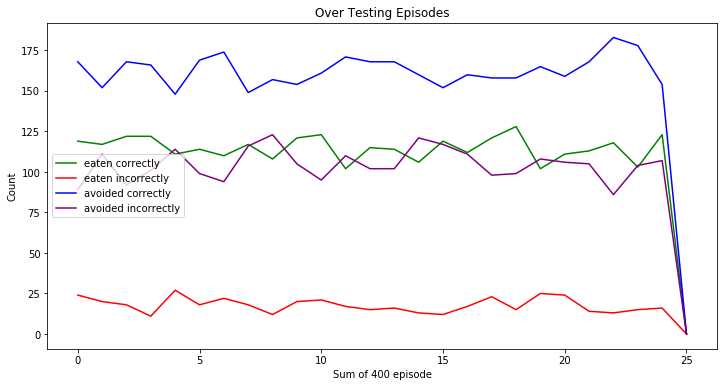

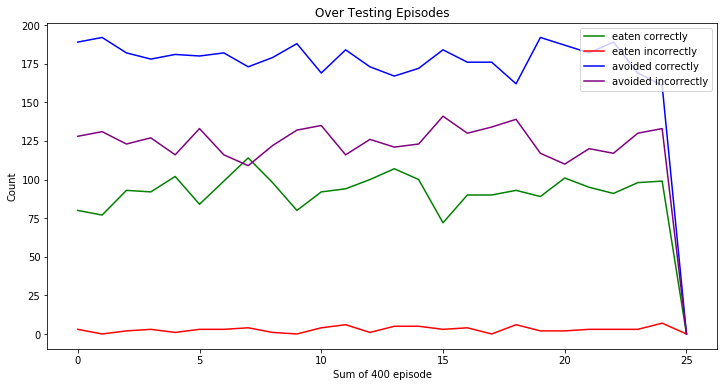

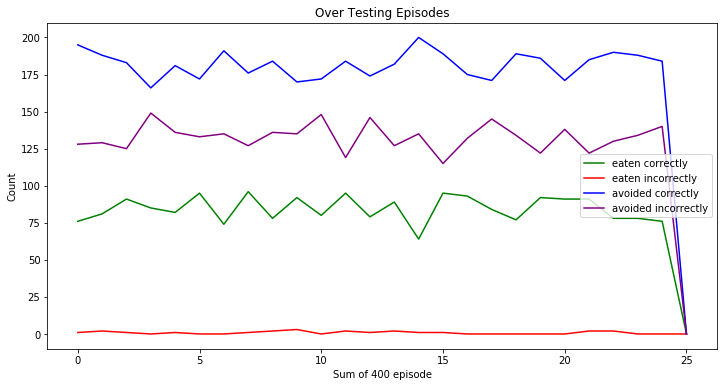

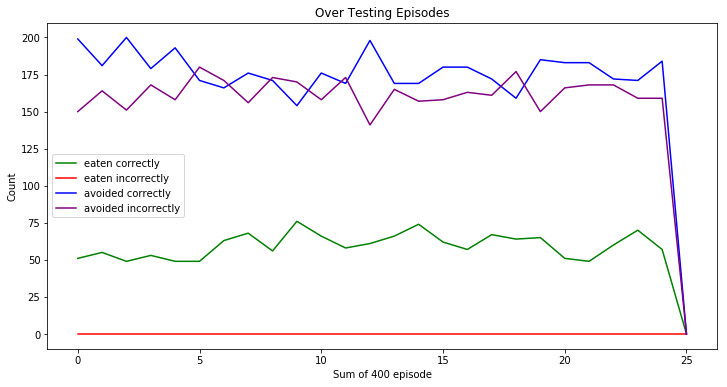

In [16]:
def plotdata(data,window):
    draw_data = Process_data(data[data[5]=='Test'],window)
    
    plt.figure(figsize=(12,6))
    plt.plot(draw_data[:,0],c='green',label='eaten correctly')
    plt.plot(draw_data[:,1],c='red',label='eaten incorrectly')
    plt.plot(draw_data[:,2],c='blue',label='avoided correctly')
    plt.plot(draw_data[:,3],c='purple',label='avoided incorrectly')
    plt.xlabel('Sum of {} episode'.format(window))
    plt.ylabel('Count')
    plt.title('Over Testing Episodes')
    plt.legend()
    #draw_data(data[data[5]=='train'],window)
    return draw_data

for i in range (5,9):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400)

In [5]:
tr_means=[]
tr_stds=[]
ts_means=[]
ts_stds=[]

tr_total=np.zeros(7)
ts_total=np.zeros(7)
for counter,i in enumerate(range(1023,1030)):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    tr = x[x[5]=='train']
    ts = x[x[5]=='Test']
    tr_total[counter%7] = tr[2].mean()
    ts_total[counter%7] = ts[2].mean()
    if ((counter+1)%7)==0:
        tr_means.append(tr_total.mean())
        tr_stds.append(tr_total.std())
        ts_means.append(ts_total.mean())
        ts_stds.append(ts_total.std())
        tr_total =np.zeros(7)
        ts_total =np.zeros(7)
        
for counter,i in enumerate(range(1037,1072)):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    tr = x[x[5]=='train']
    ts = x[x[5]=='Test']
    tr_total[counter%7] = tr[2].mean()
    ts_total[counter%7] = ts[2].mean()
    if ((counter+1)%7)==0:
        tr_means.append(tr_total.mean())
        tr_stds.append(tr_total.std())
        ts_means.append(ts_total.mean())
        ts_stds.append(ts_total.std())
        tr_total =np.zeros(7)
        ts_total =np.zeros(7)



N = len(tr_means)
ind = np.arange(N) # the x locations for the groups
width = 0.35       # the width of the bars

fig, ax = plt.subplots()
fig.set_figwidth(12)
rects1 = ax.bar(ind, tr_means, width, color='g', yerr=tr_stds)


rects2 = ax.bar(ind + width, ts_means, width, color='y', yerr=ts_stds)

# add some text for labels, title and axes ticks
ax.set_ylabel('Scores')
ax.set_title('Scores by group')
ax.set_xticks(ind + width / 2)
ax.set_xticklabels(['Adam 0.001','Adam 0.01','Adam 0.1','rmsprop 0.001','rmsprop 0.01', 'rmsprop 0.1'])

ax.legend((rects1[0], rects2[0]), ('training', 'testing'))


def autolabel(rects):
    """
    Attach a text label above each bar displaying its height
    """
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2., 1.05*height,
                '%d' % int(height),
                ha='center', va='bottom')

autolabel(rects1)
autolabel(rects2)

plt.show()

### Using deep mind architecture. 
#### Network is trained once per episode.

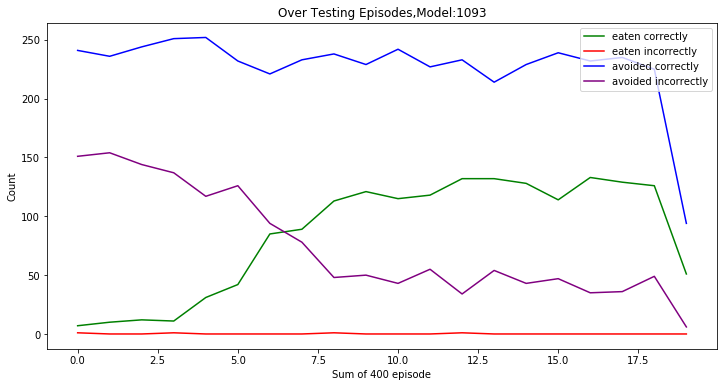

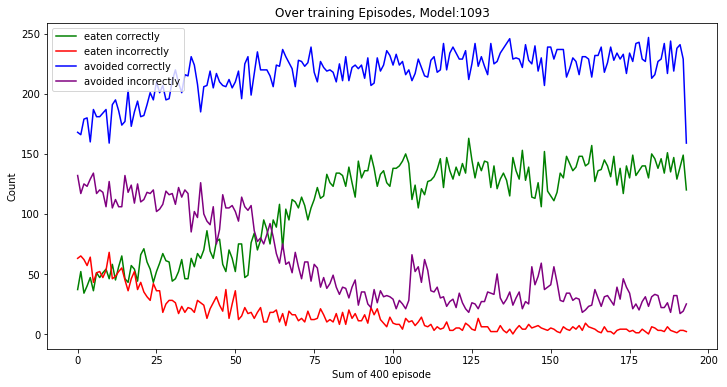

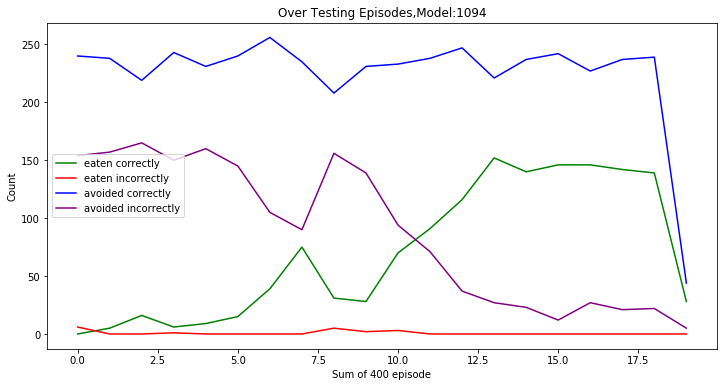

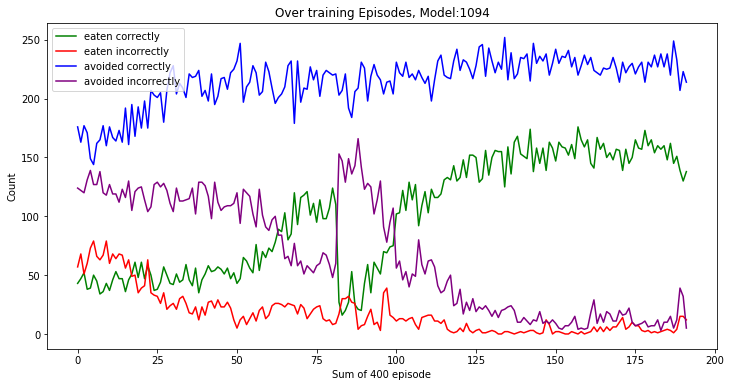

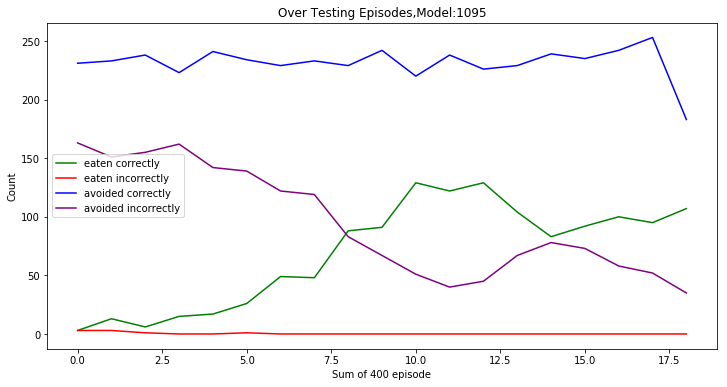

...

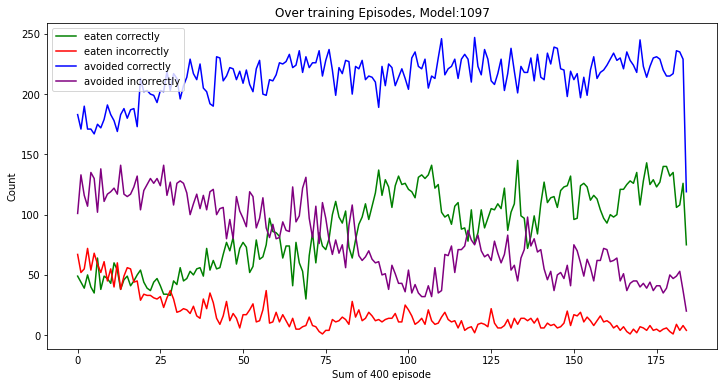

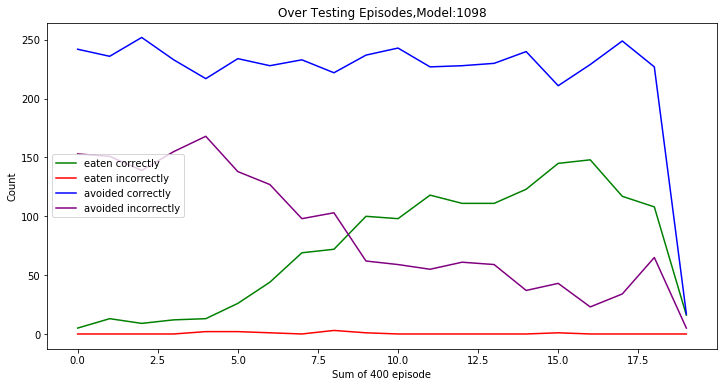

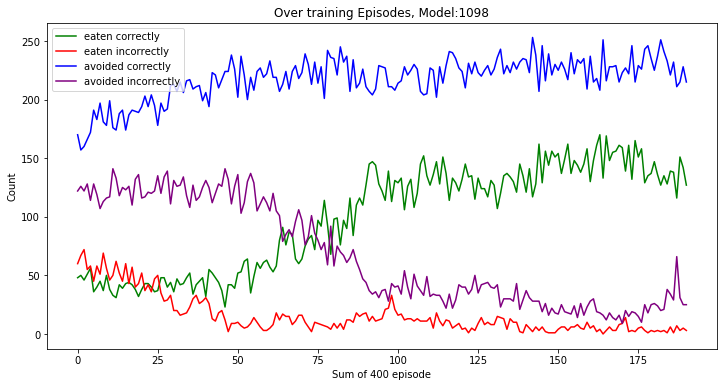

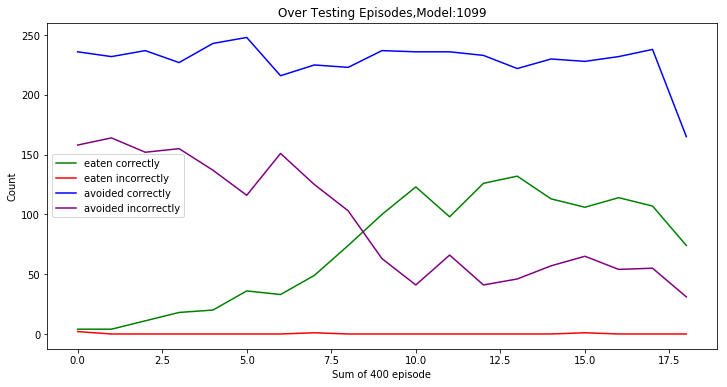

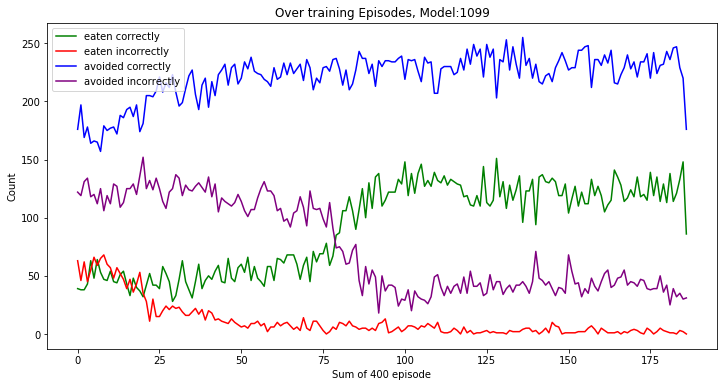

In [5]:
for i in range(1093,1100):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### Deep mind, trained once per time step

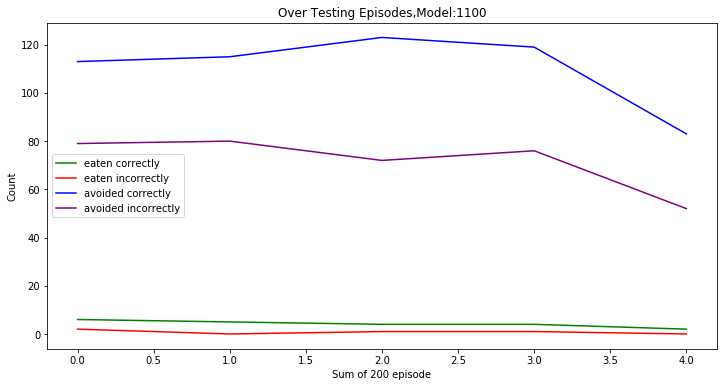

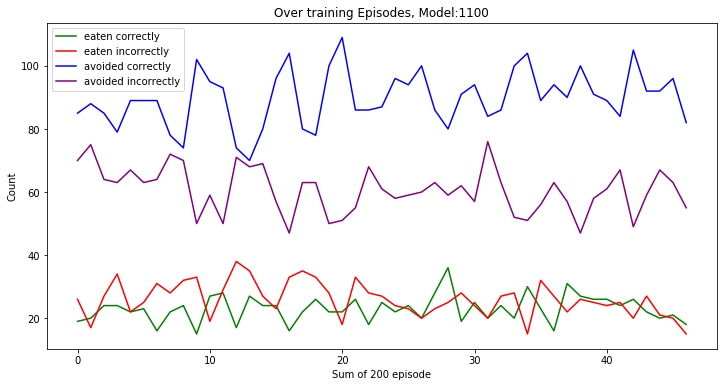

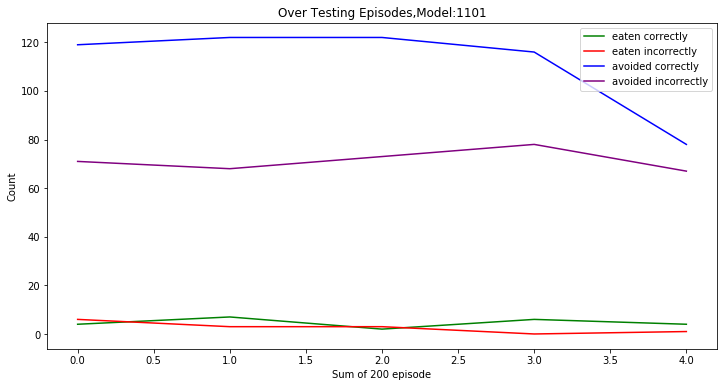

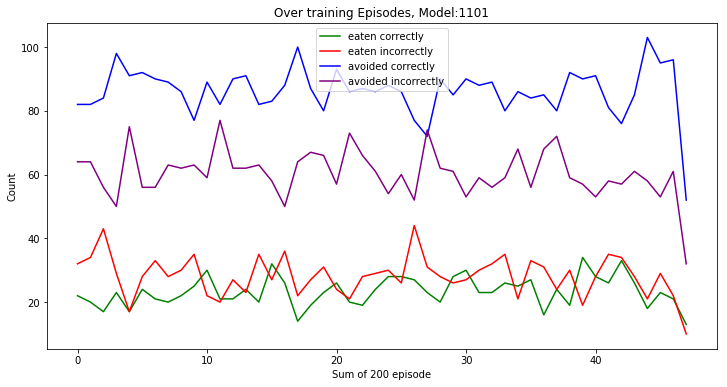

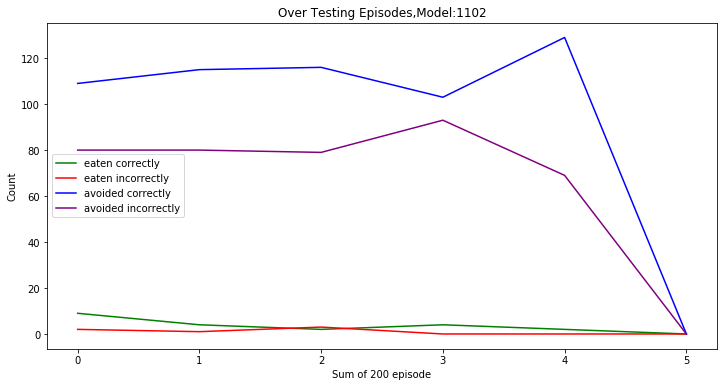

...

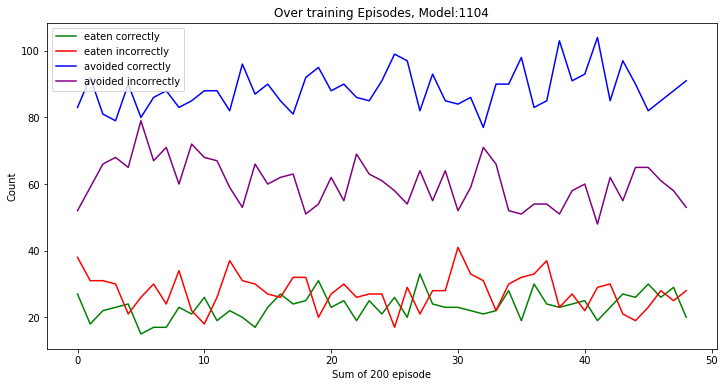

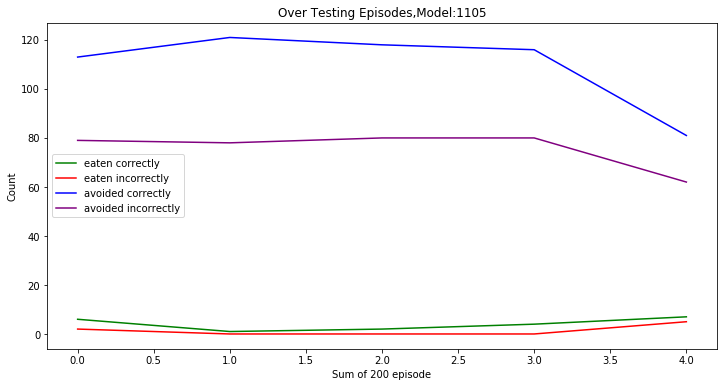

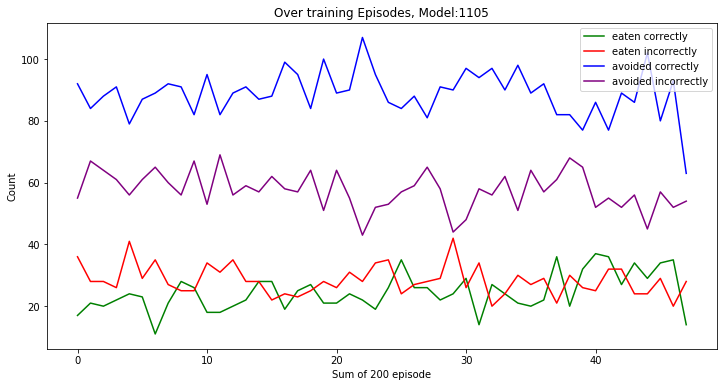

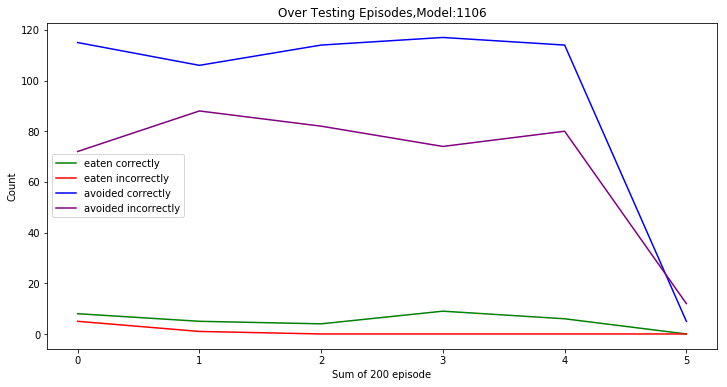

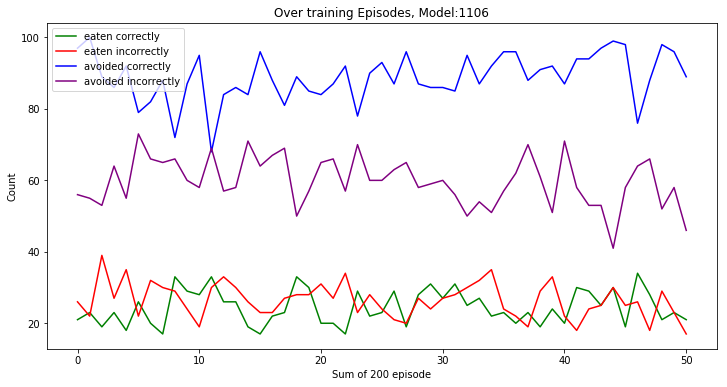

In [7]:
for i in range(1100,1107):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,200,i)

### Deep mind, trained 8 times per episode

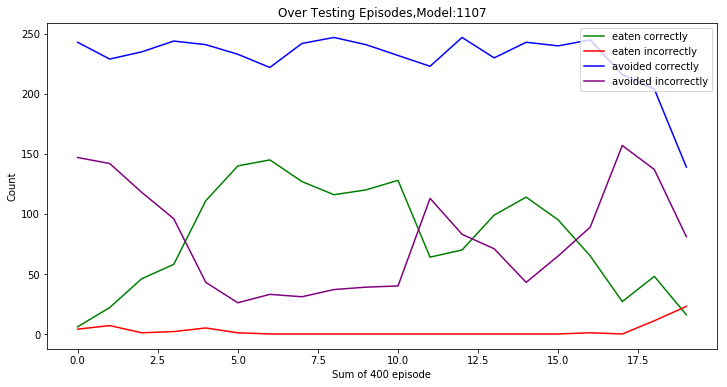

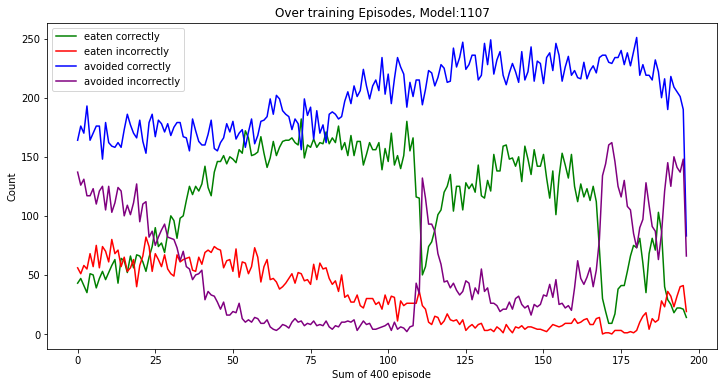

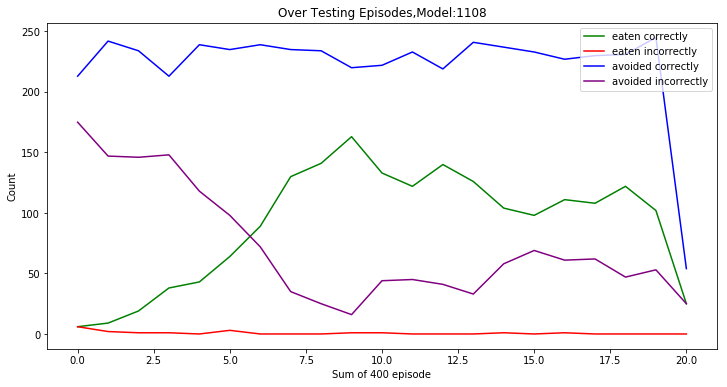

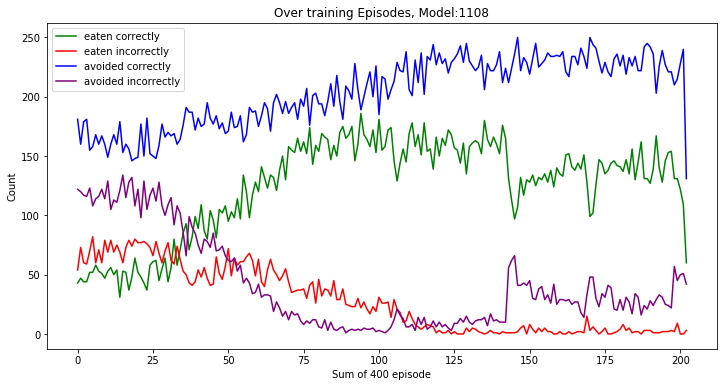

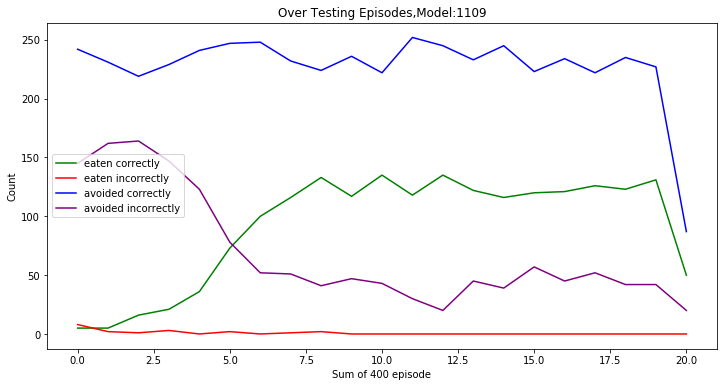

...

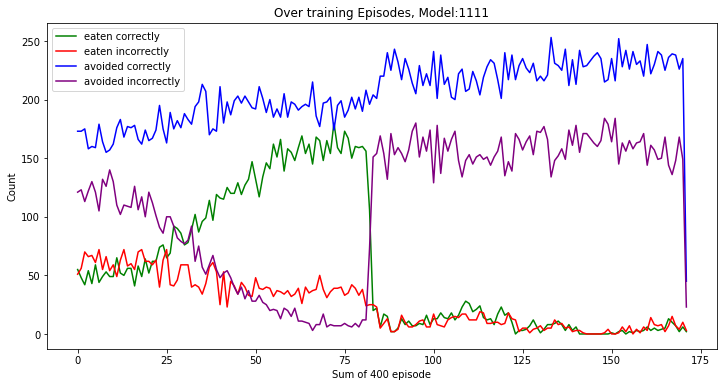

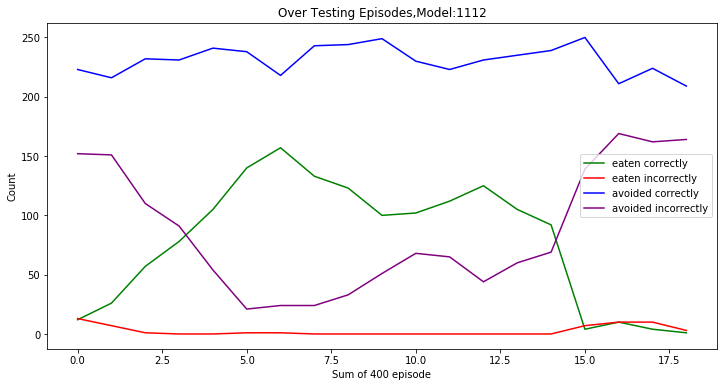

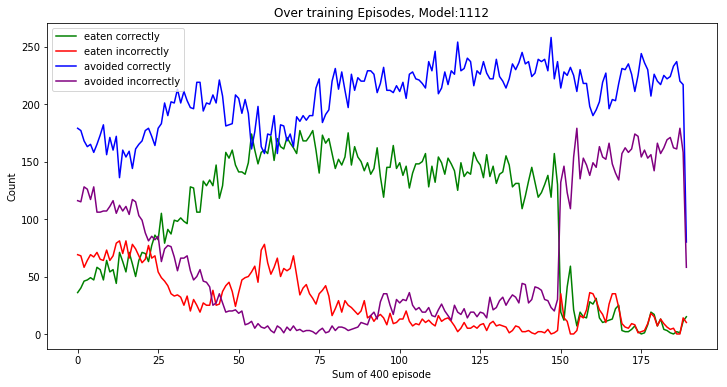

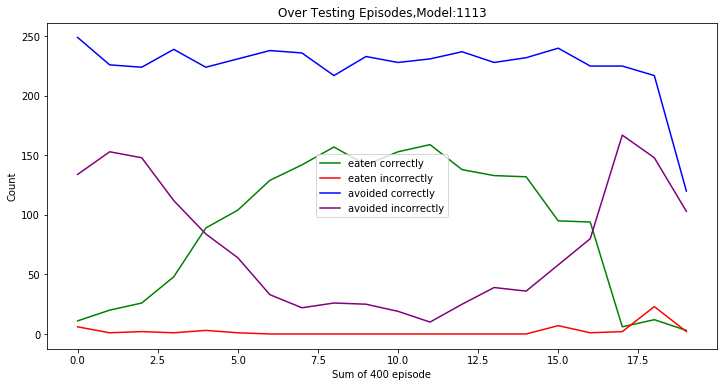

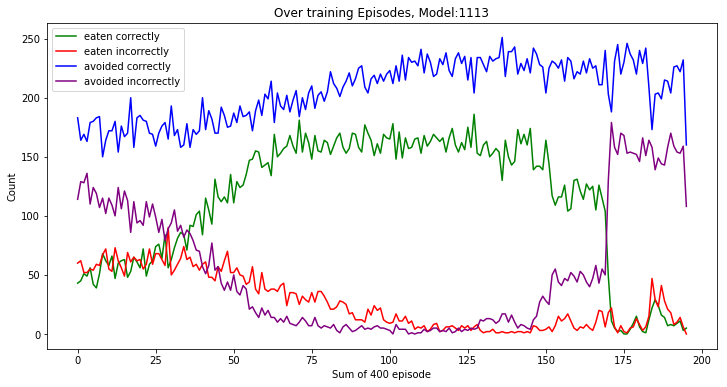

In [35]:
for i in range(1107,1114):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### Deepmind without reward shaping

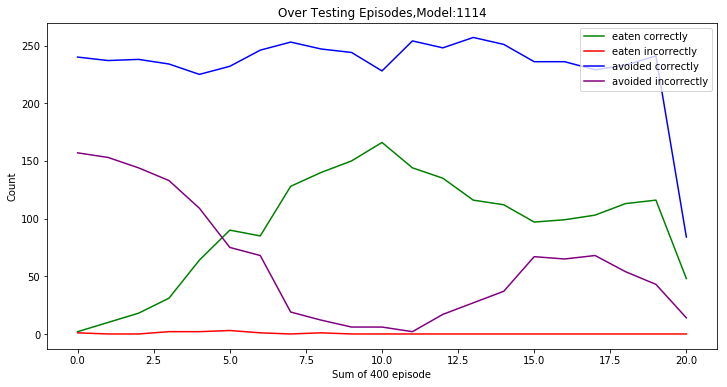

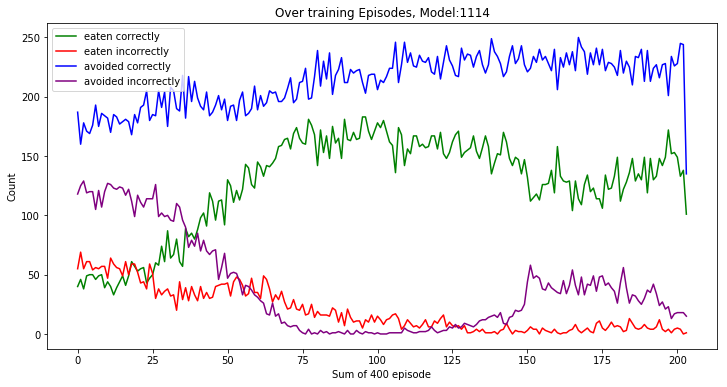

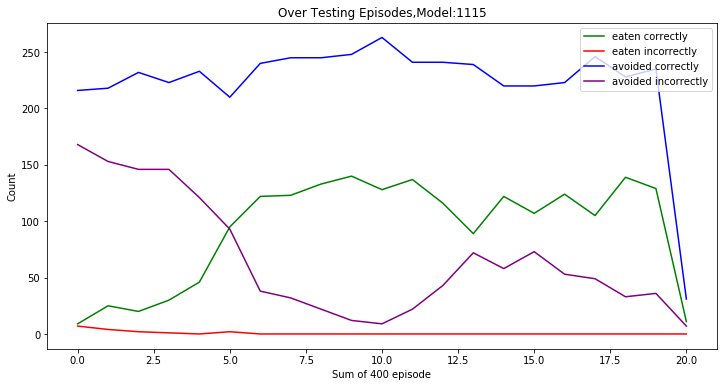

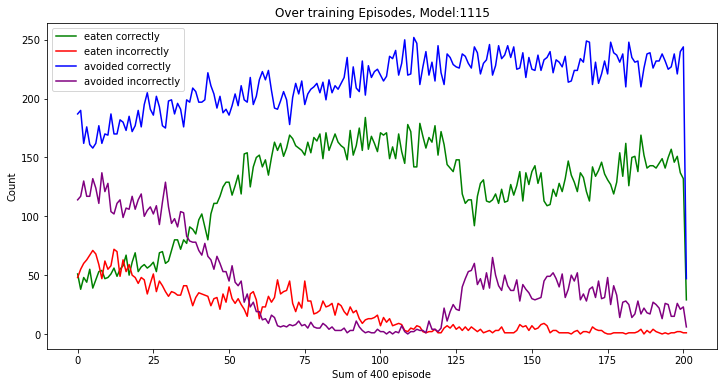

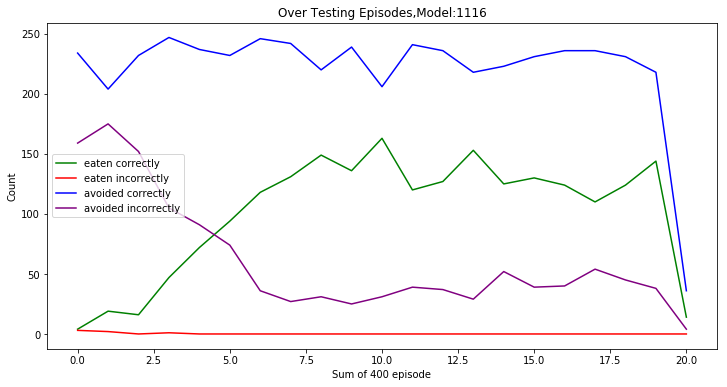

...

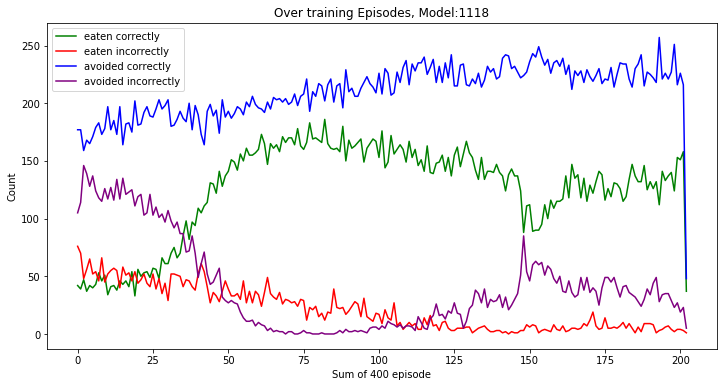

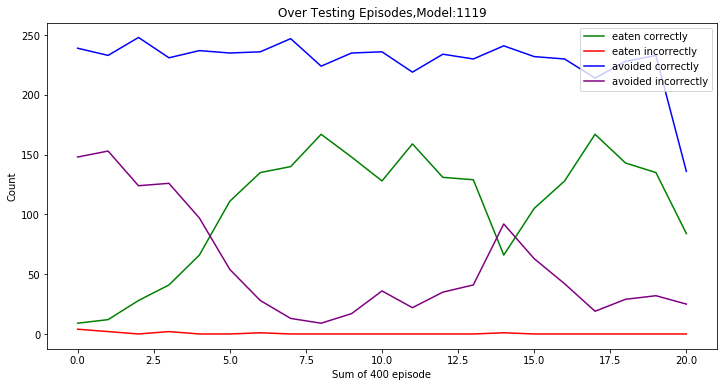

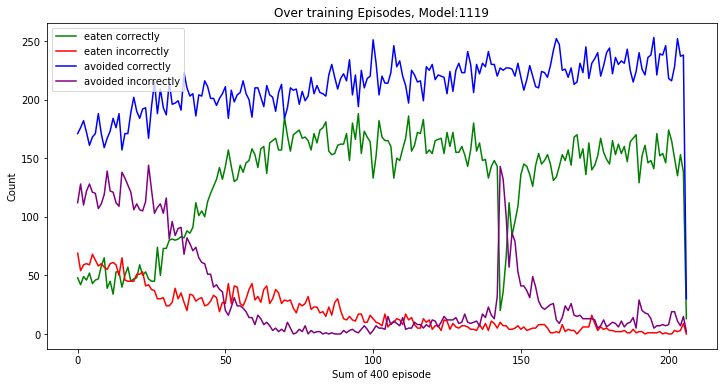

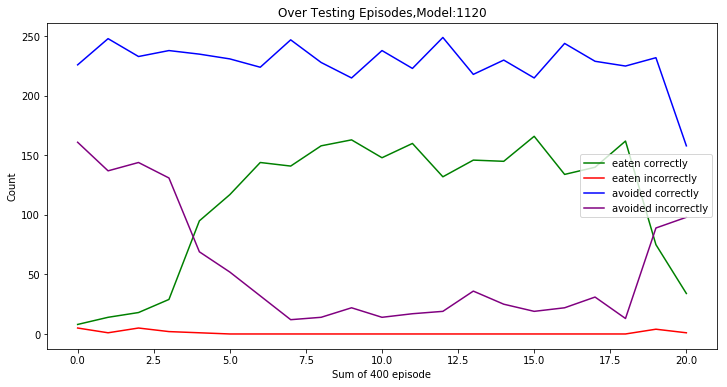

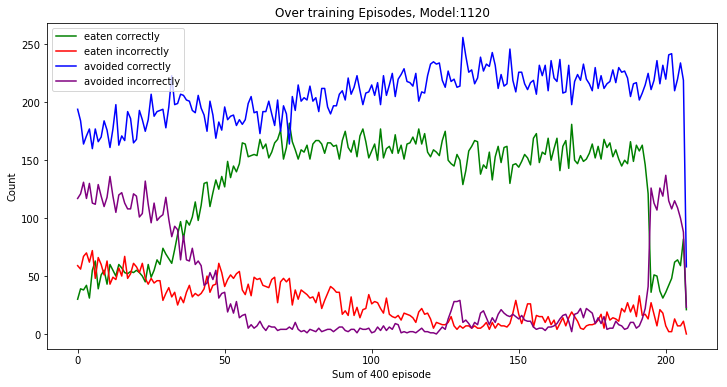

In [36]:
for i in range(1114,1121):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### Deep mind using 20M, it got terminated we have only 10M steps.

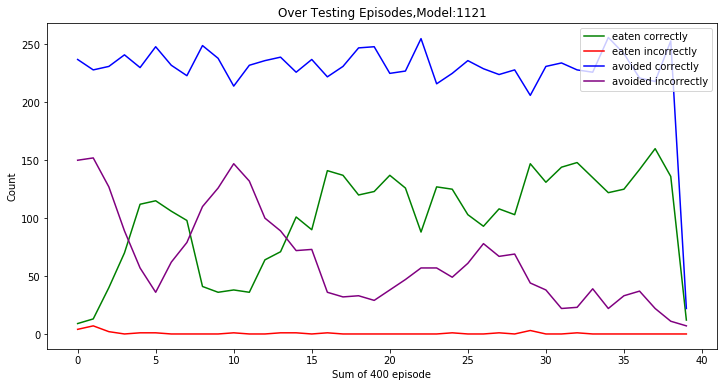

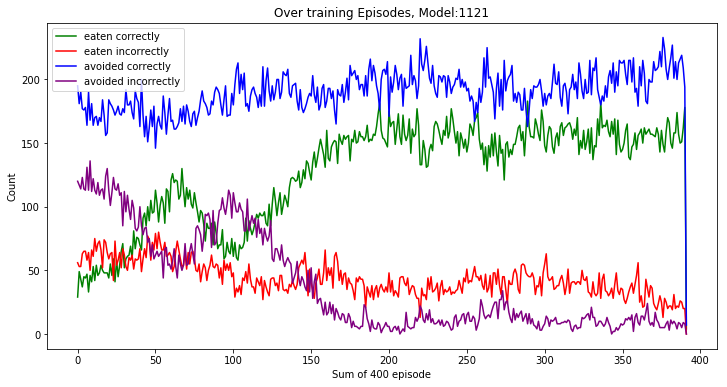

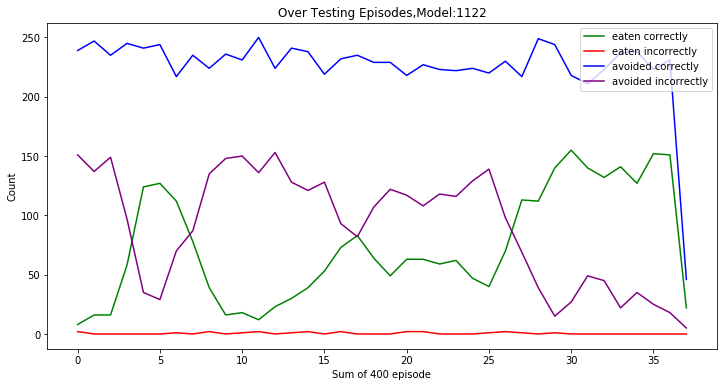

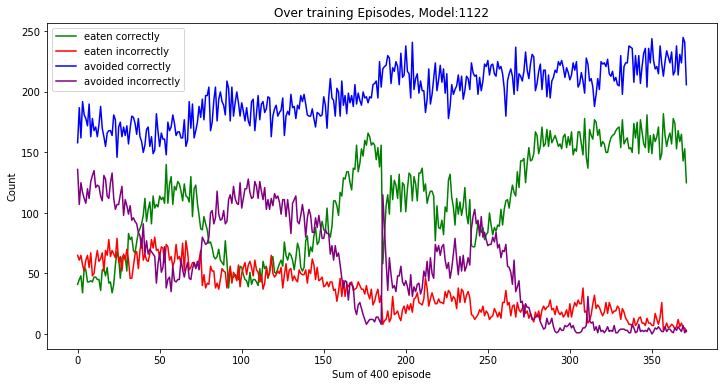

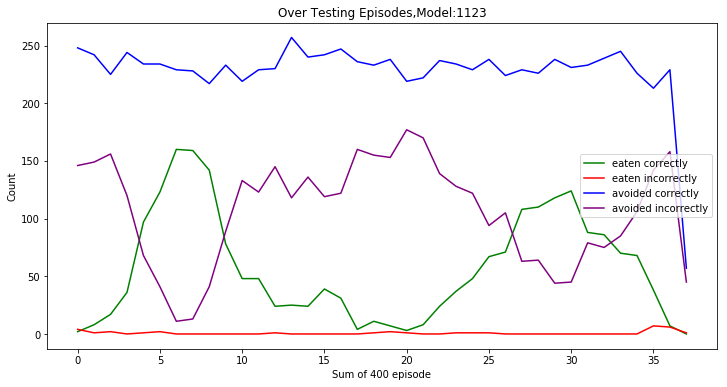

...

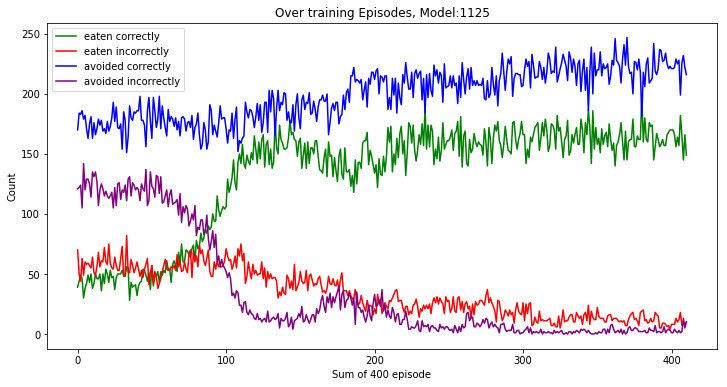

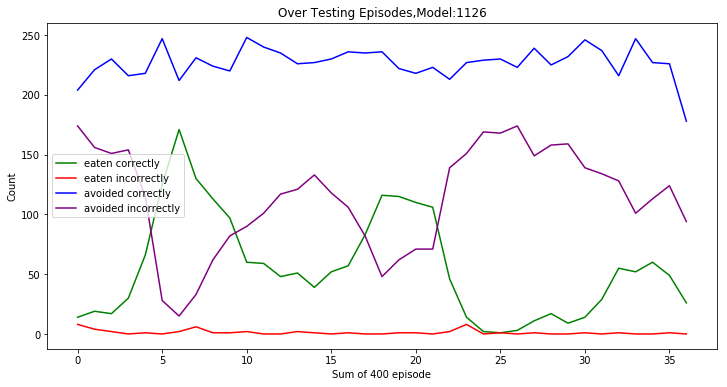

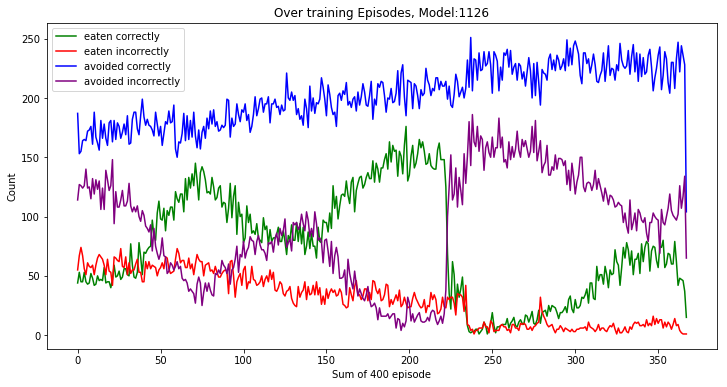

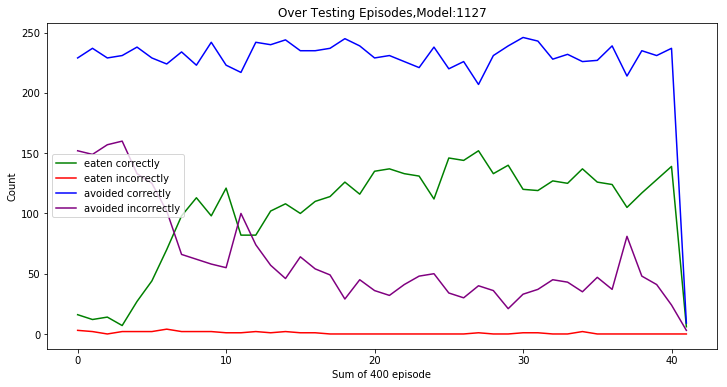

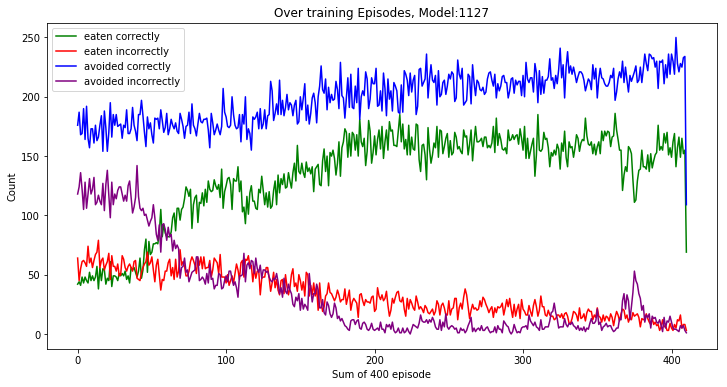

In [37]:
for i in range(1121,1128):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### Deepmind, 6M, Vision angle:$180^o$

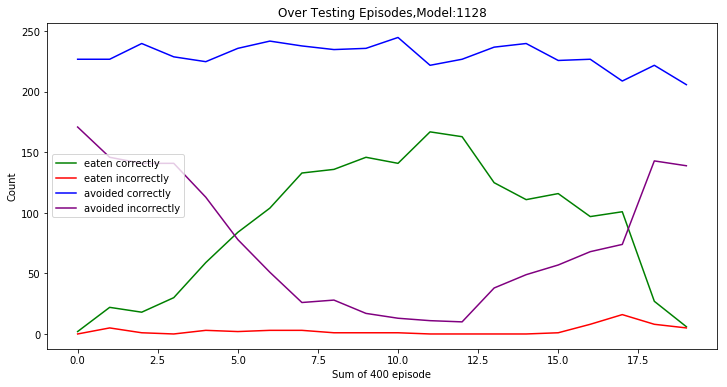

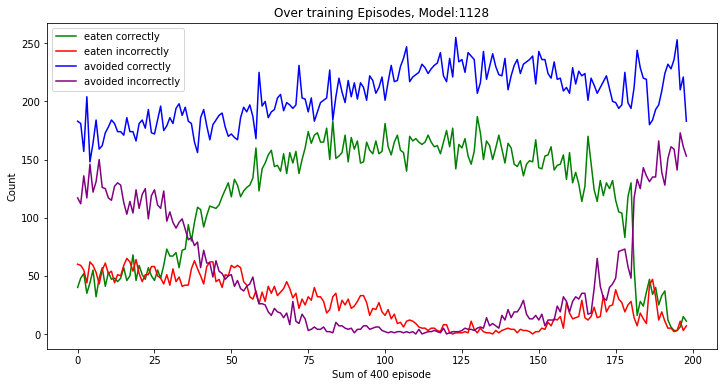

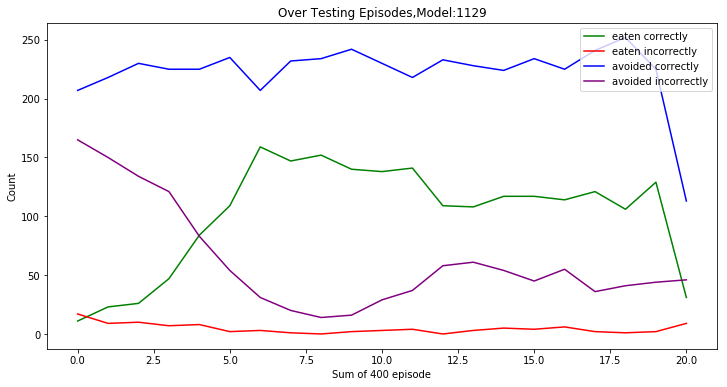

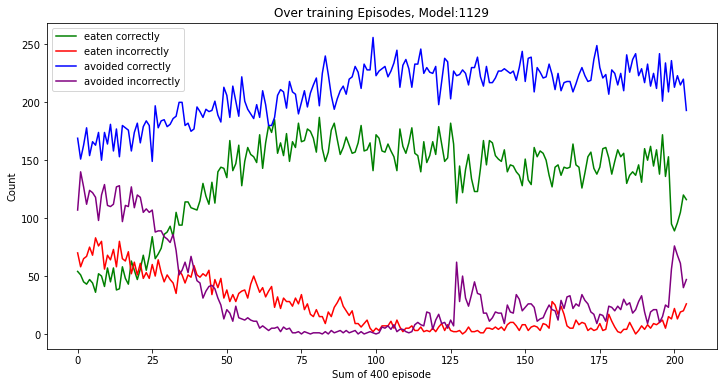

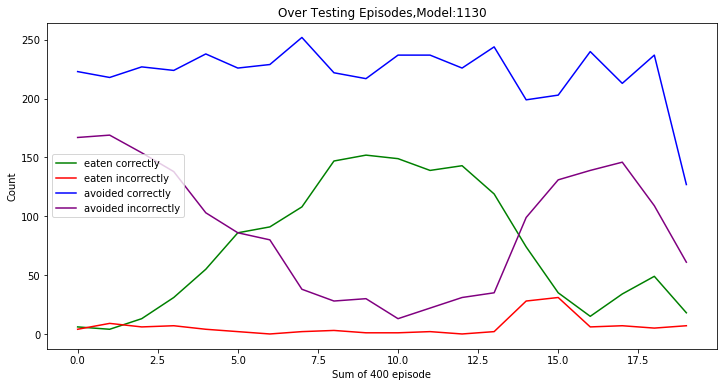

...

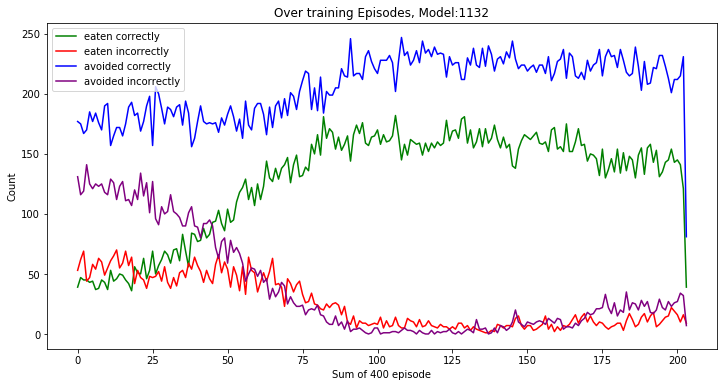

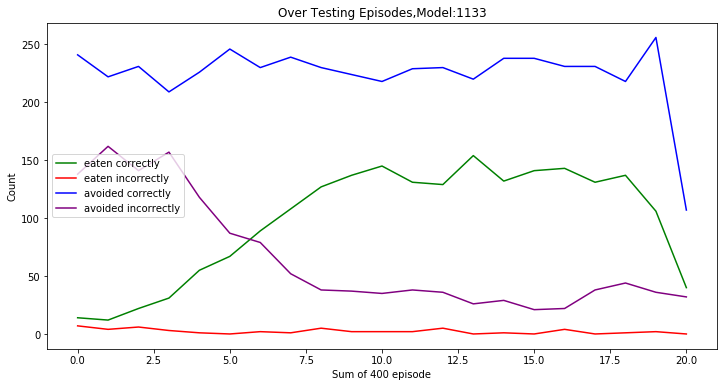

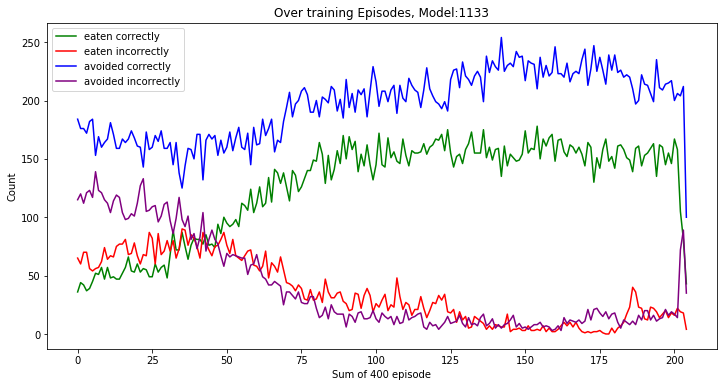

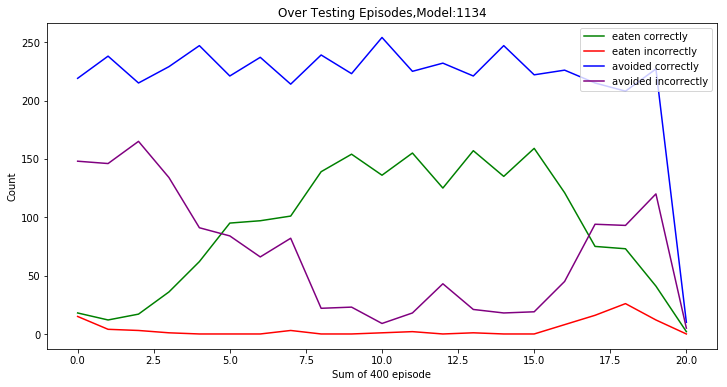

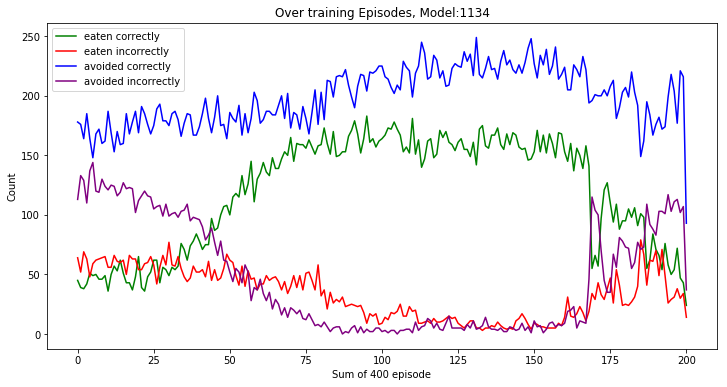

In [42]:
for i in range(1128,1135):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)
    #plt.xlim((674,677))

### Deep mind, 6M, 6X6, 360

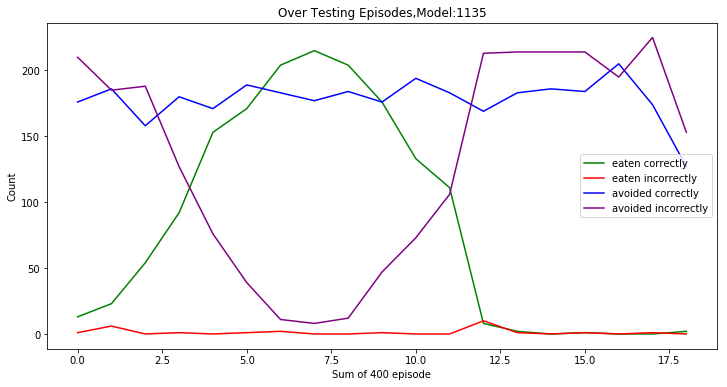

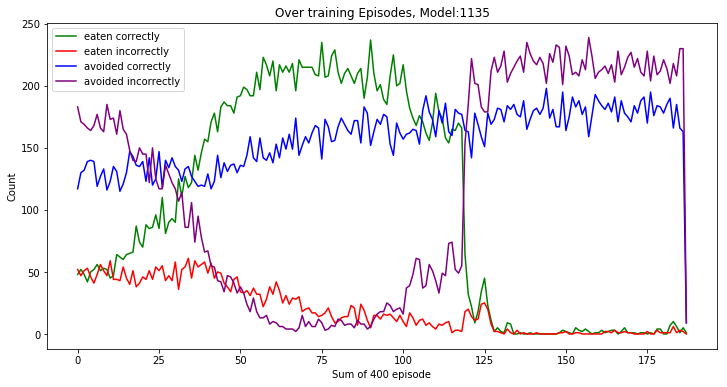

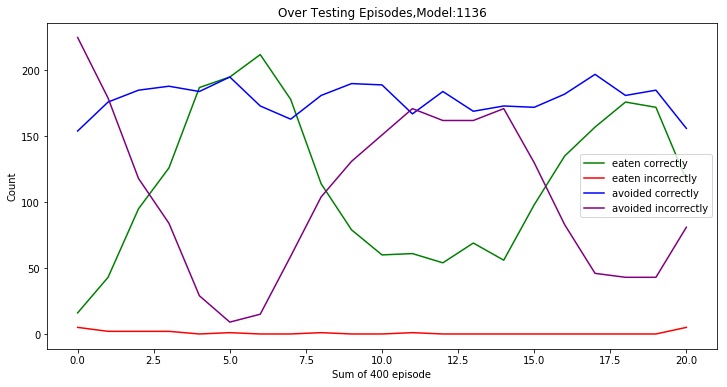

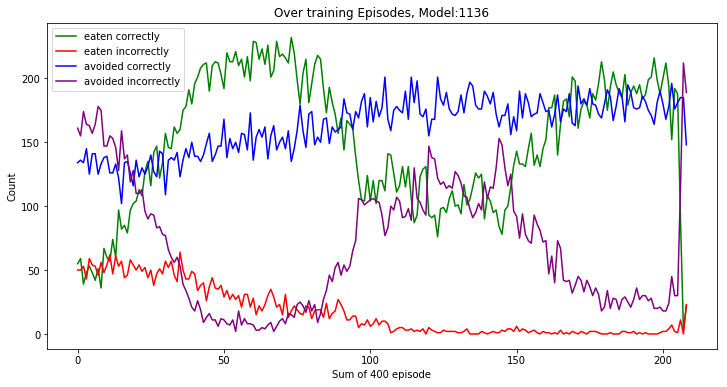

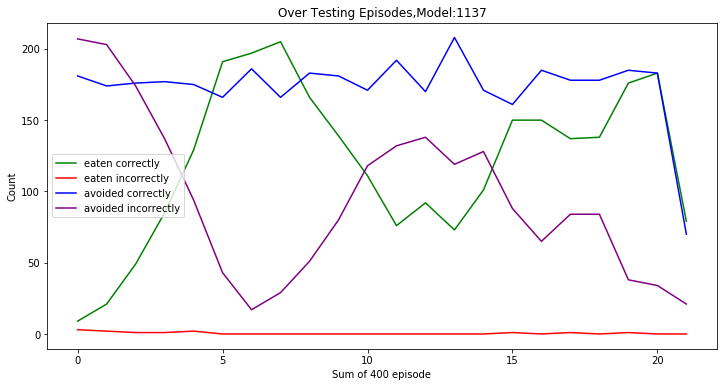

...

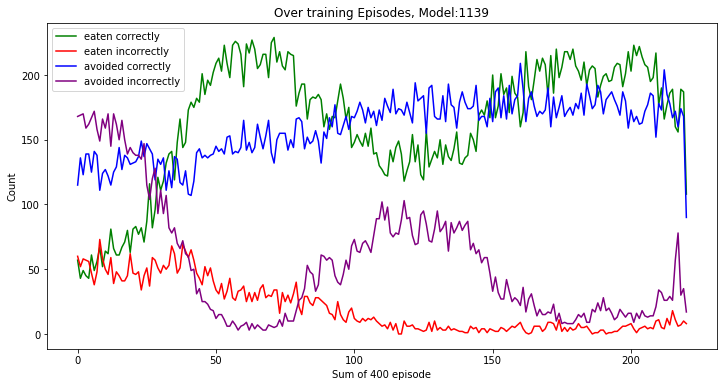

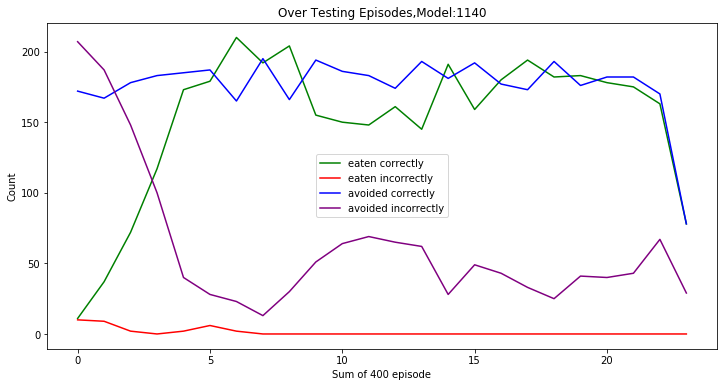

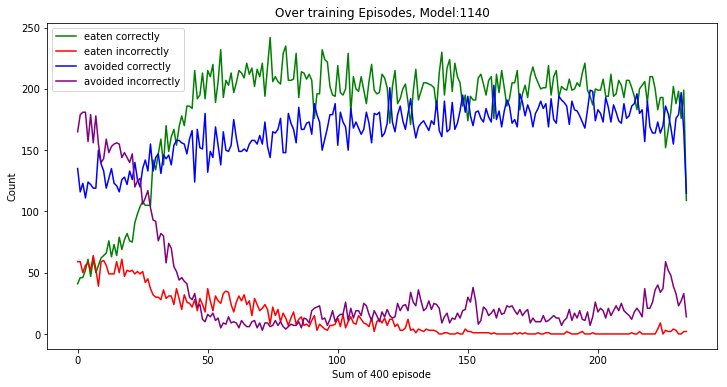

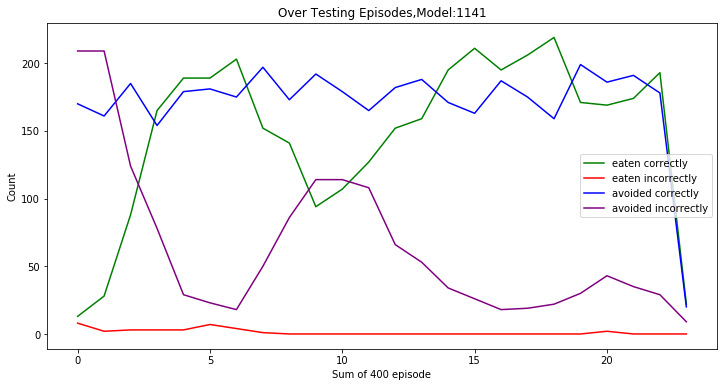

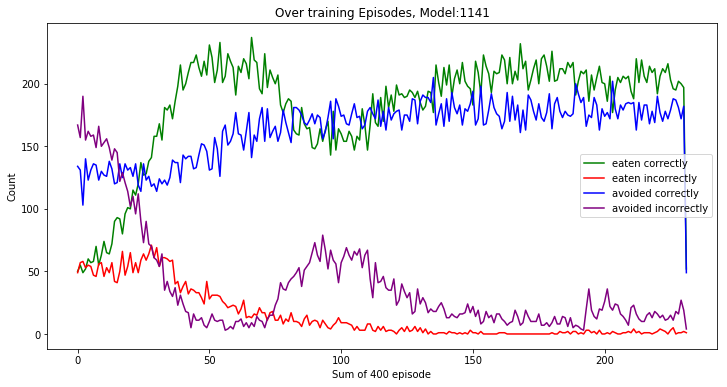

In [39]:
for i in range(1135,1142):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### Deep mind, 6M, 11X11 , 180, DOM: 4x4, Food 5x5

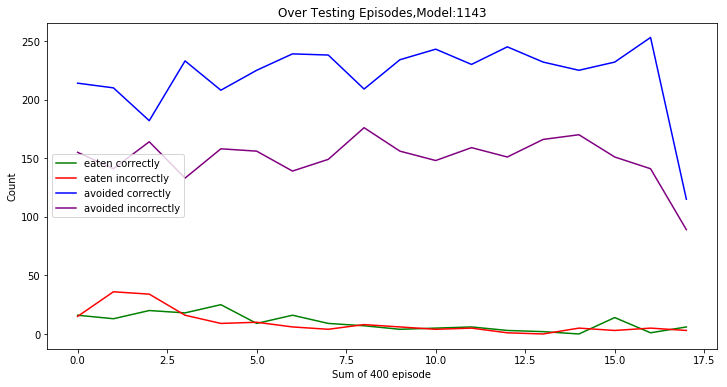

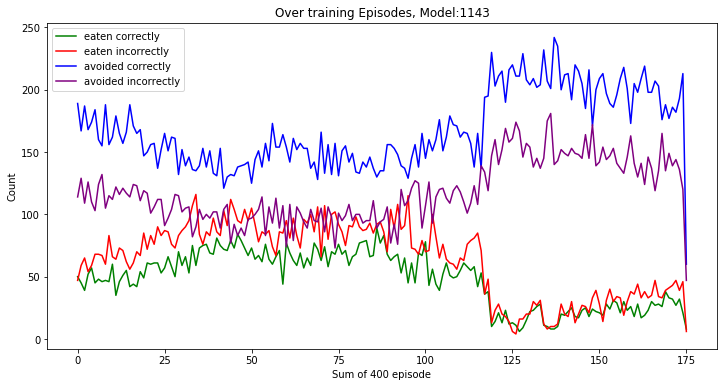

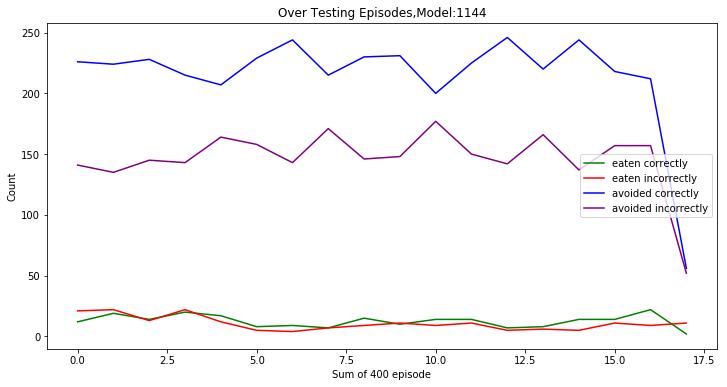

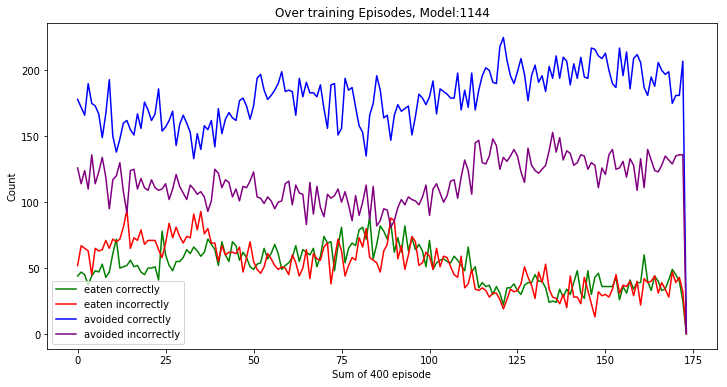

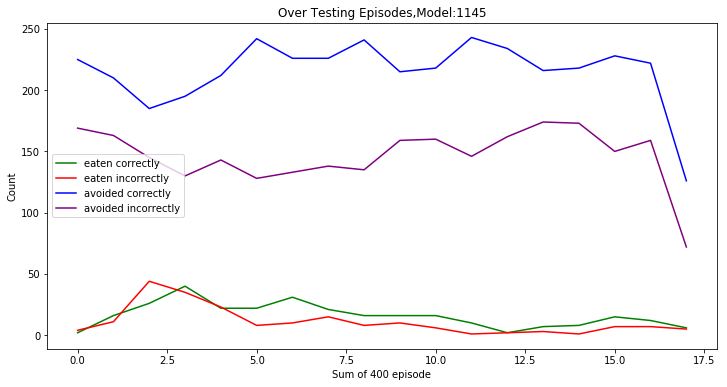

...

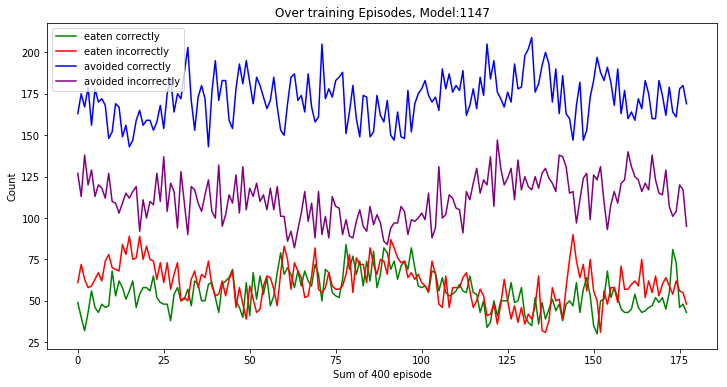

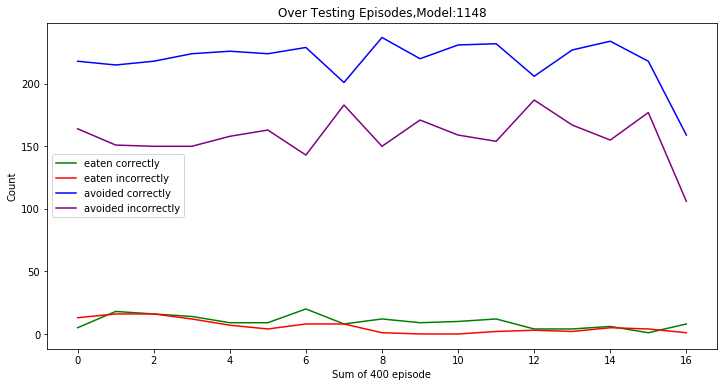

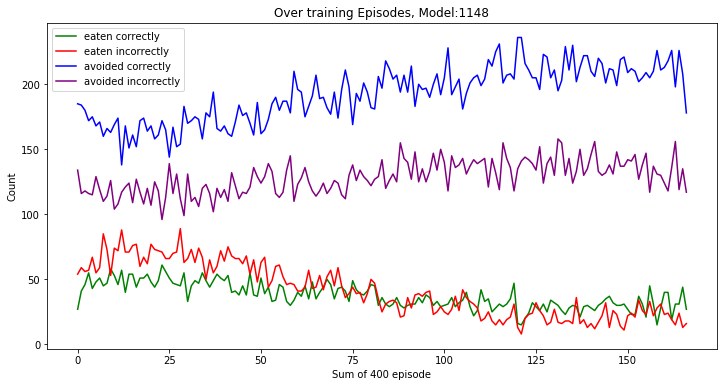

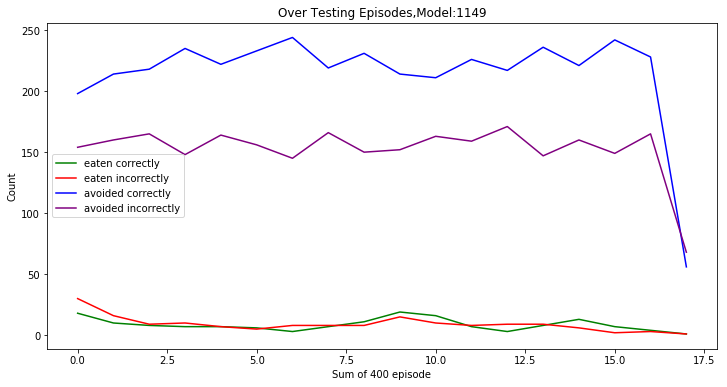

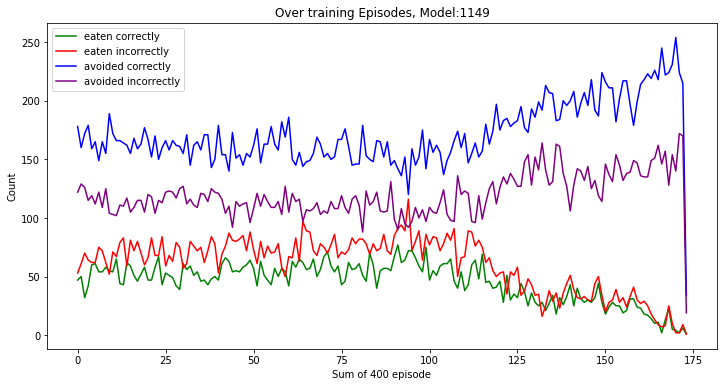

In [40]:
for i in range(1143,1150):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### tau : 0.0005

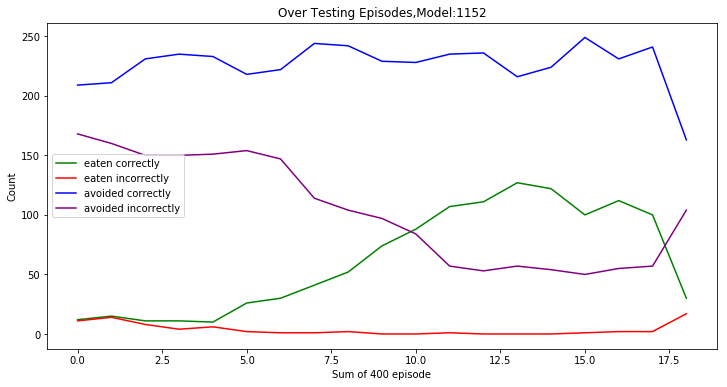

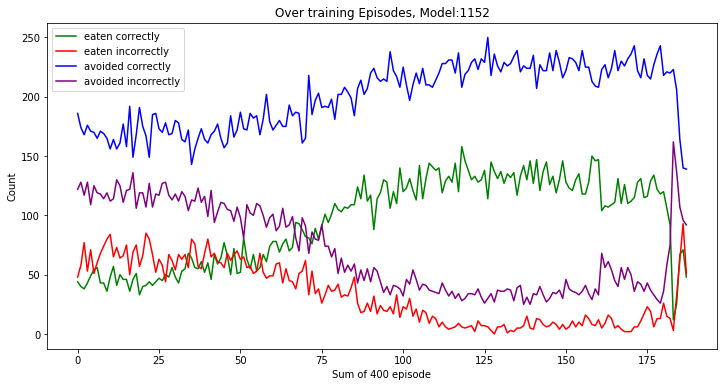

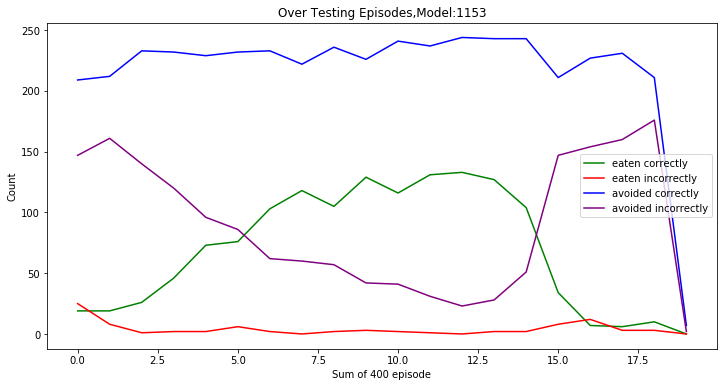

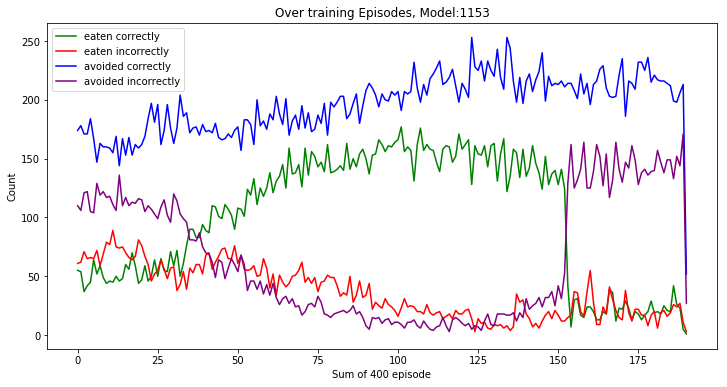

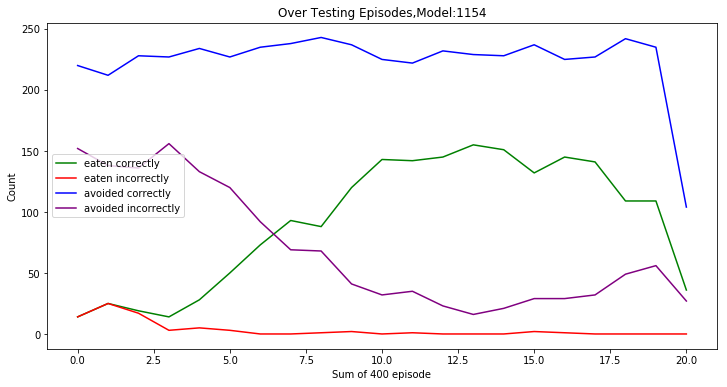

...

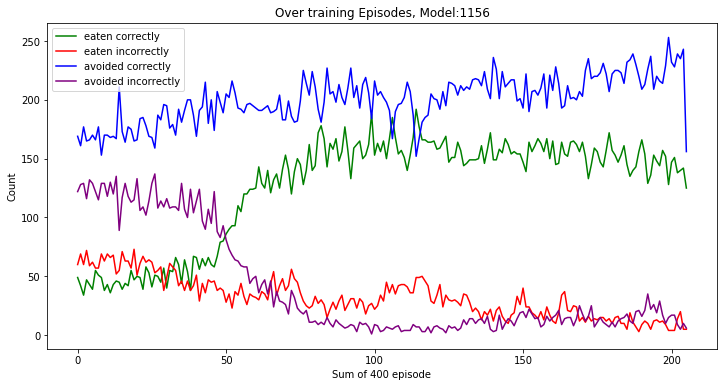

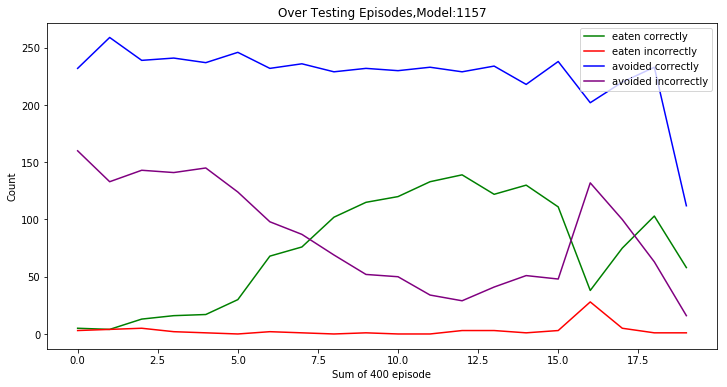

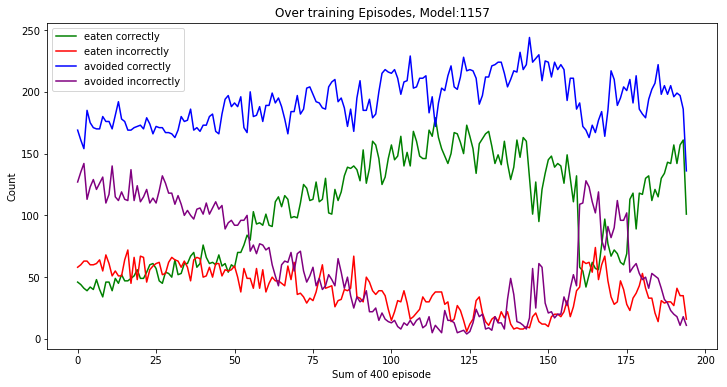

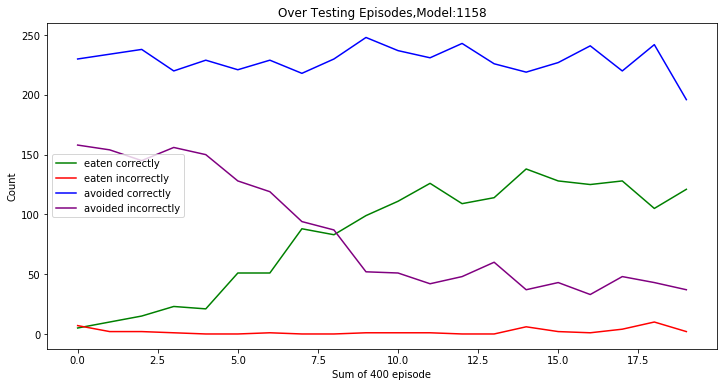

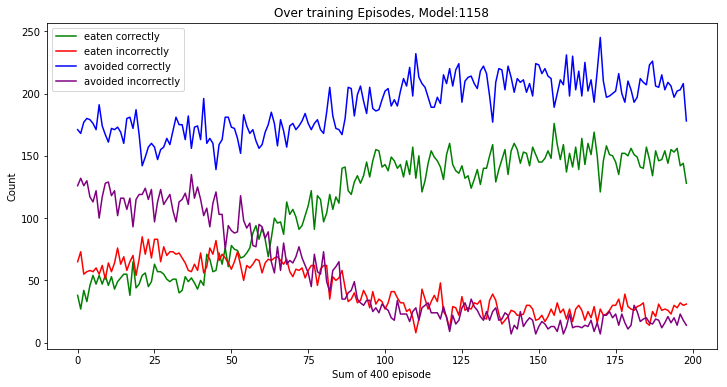

In [3]:
for i in range(1152,1159):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### tau: 0.01

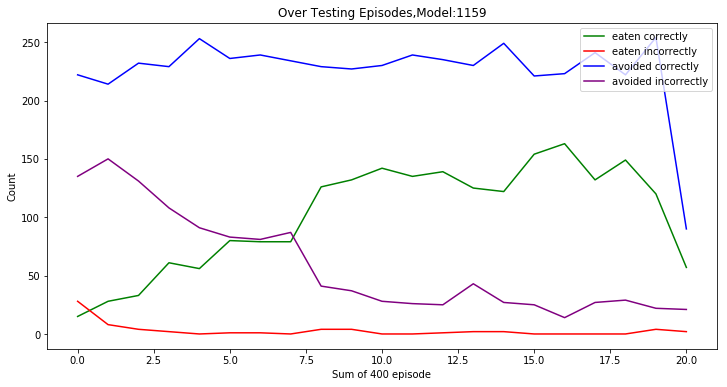

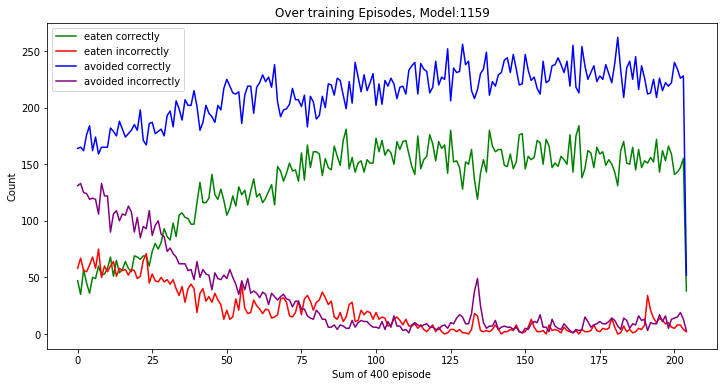

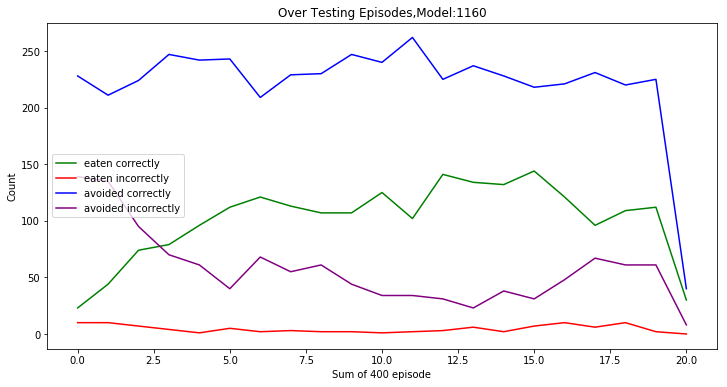

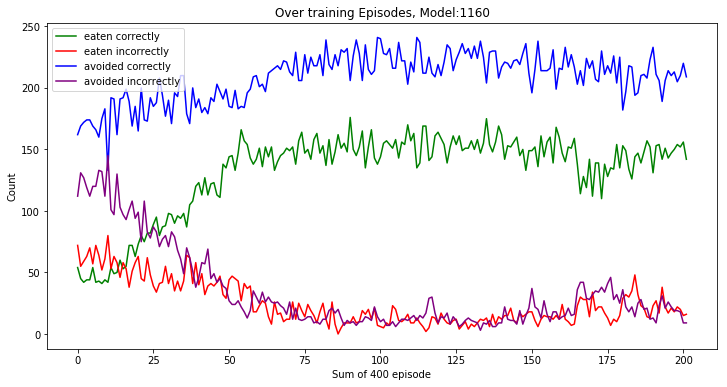

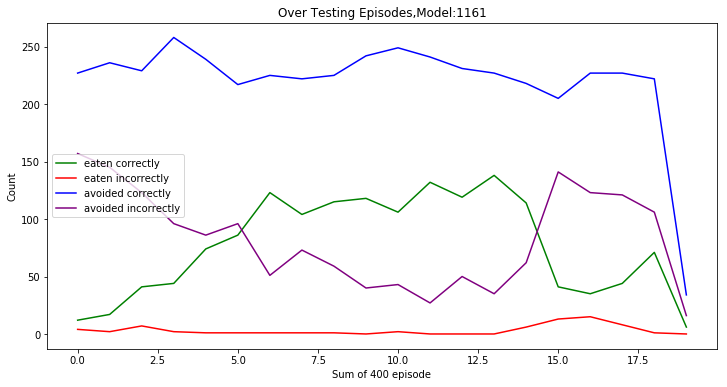

...

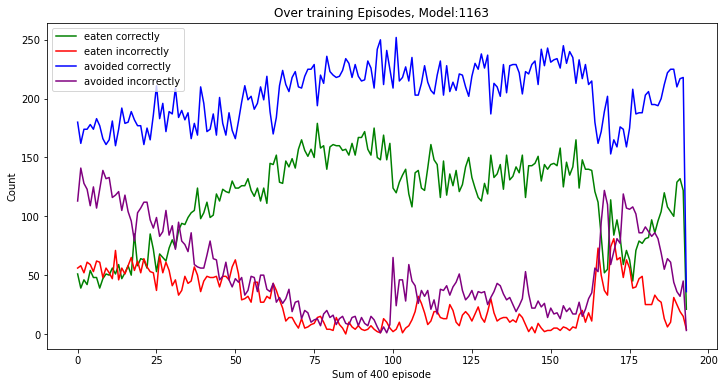

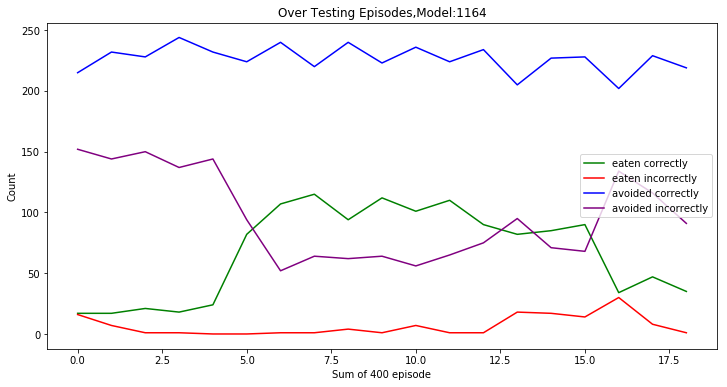

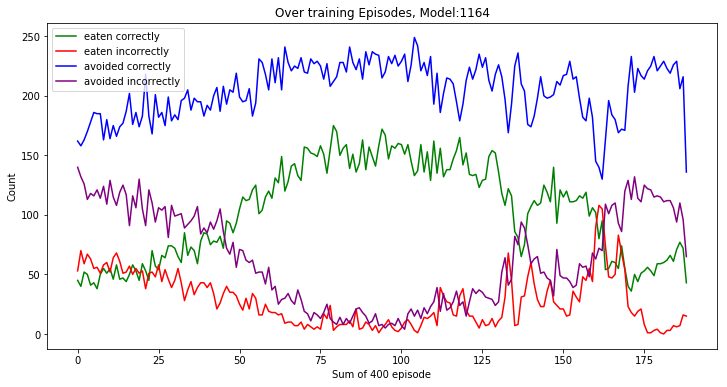

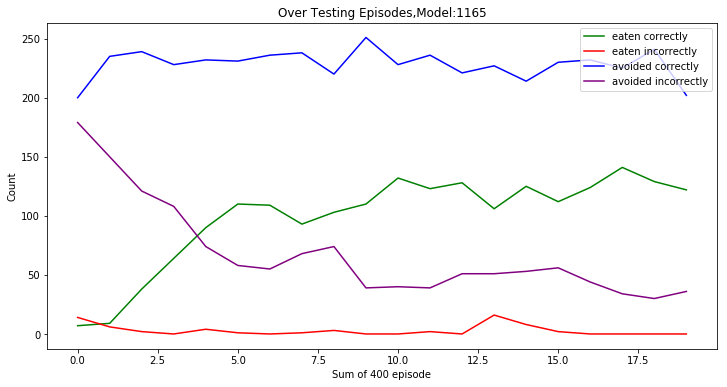

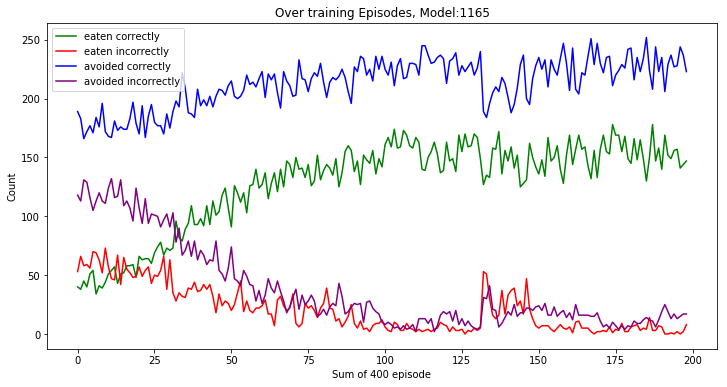

In [4]:
for i in range(1159,1166):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### L1 with deep mind archeticture (Alter-centric)

In [51]:
def plot_experiment(i,titl,xlbl,ylbl,window=400,typ='train'):
    plt.figure(figsize=(13,5))
    tmp,perf = training_reward_window(window,i,typ)
    plt.figure(figsize=(13,5))
    plt.plot(tmp[:-1],c='b',label='Model')
    plt.plot(perf[:-1],c='r',label='Ground truth')
    plt.title(titl.format(window),fontweight='bold',fontsize=15)
    plt.xlabel(xlbl.format(window),fontweight='bold',fontsize=12)
    plt.ylabel(ylbl,fontweight='bold',fontsize=12)
    return tmp

In [60]:
tmp.shape

(1822,)

<Figure size 936x360 with 0 Axes>

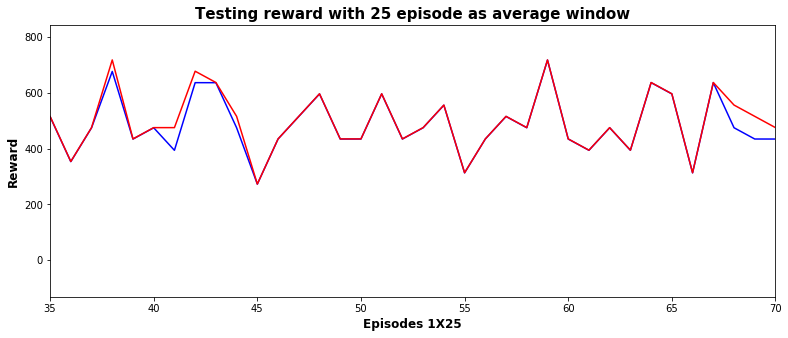

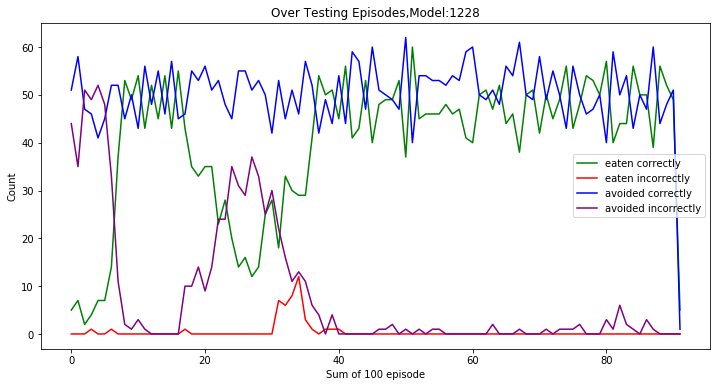

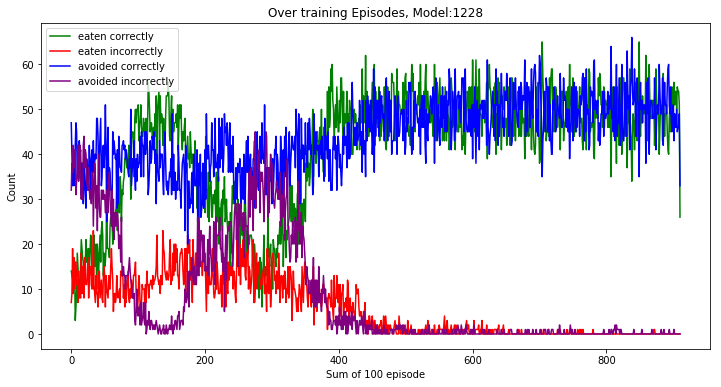

In [64]:
for i in range(1228,1229):
    #tmp = plot_experiment(i,titl='Testing reward with {} episode as average window',
    #            xlbl='Episodes 1X{}',ylbl='Reward',window=5,typ='Test')
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=25,typ='Test')
    plt.xlim((35,70))
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,100,i)

<Figure size 936x360 with 0 Axes>

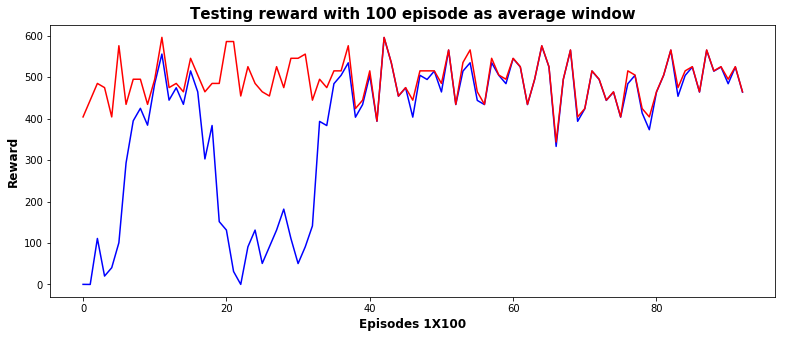

<Figure size 936x360 with 0 Axes>

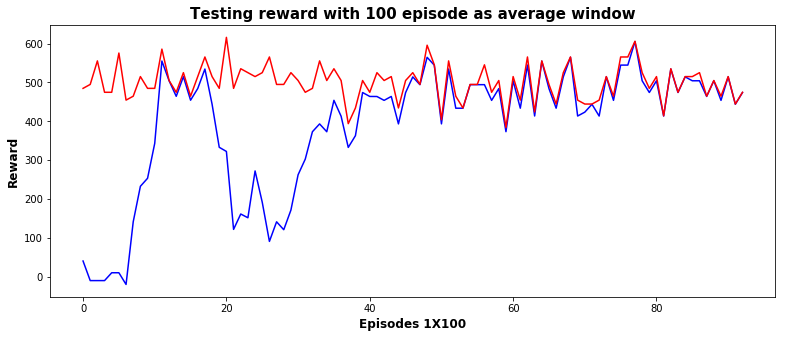

<Figure size 936x360 with 0 Axes>

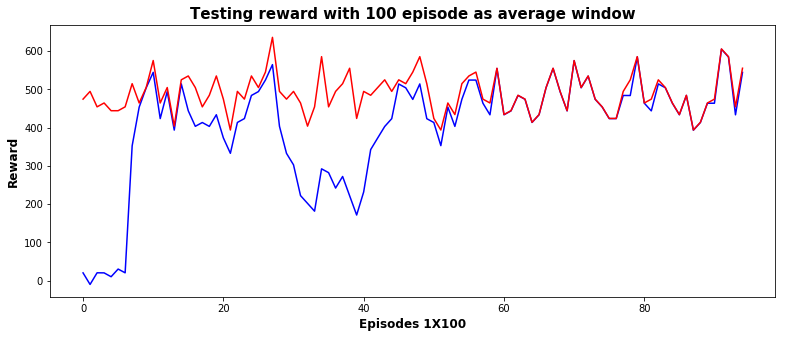

<Figure size 936x360 with 0 Axes>

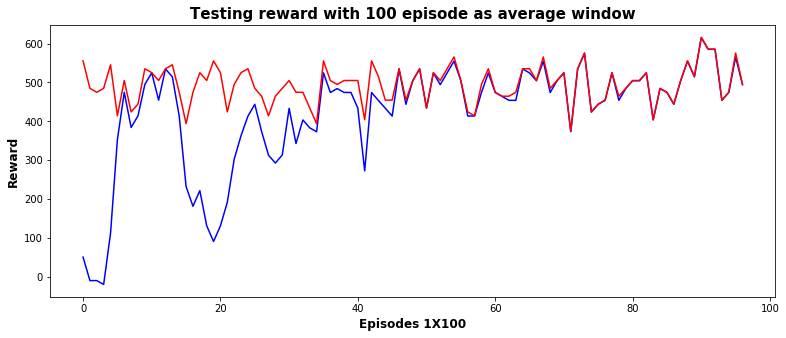

<Figure size 936x360 with 0 Axes>

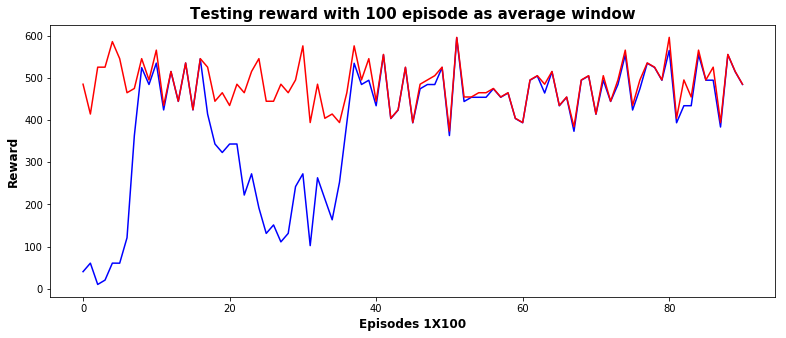

<Figure size 936x360 with 0 Axes>

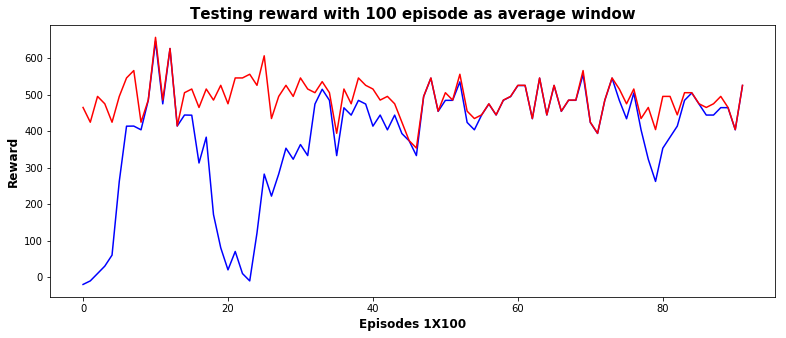

<Figure size 936x360 with 0 Axes>

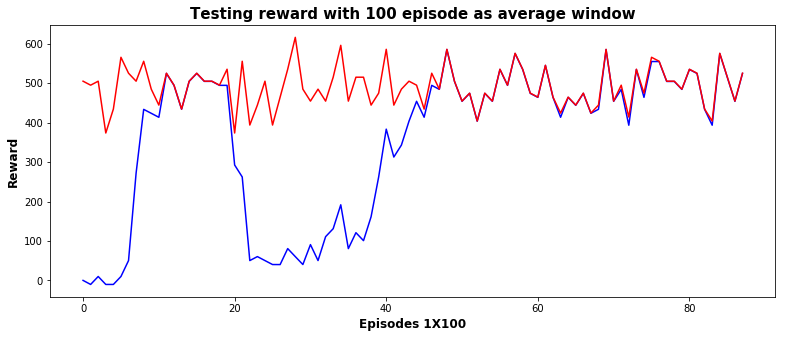

In [6]:
for i in range(1224,1231):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')

### Another 7 different seeds to confirm the drop

<Figure size 936x360 with 0 Axes>

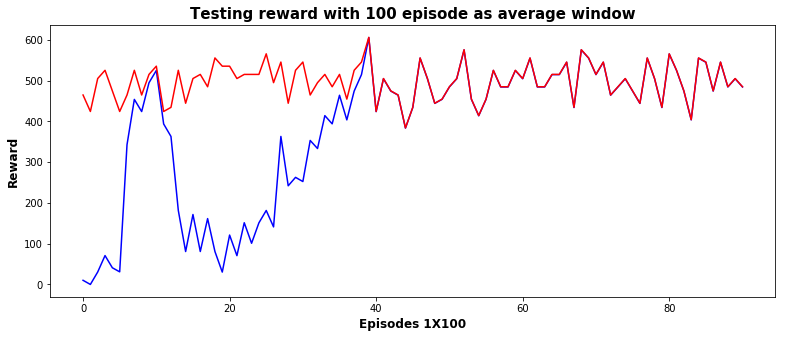

<Figure size 936x360 with 0 Axes>

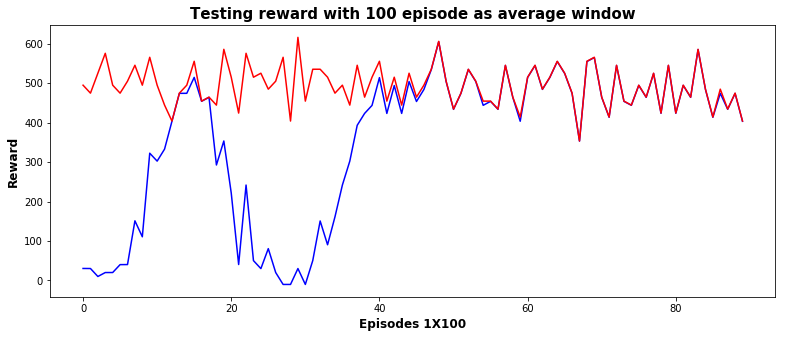

<Figure size 936x360 with 0 Axes>

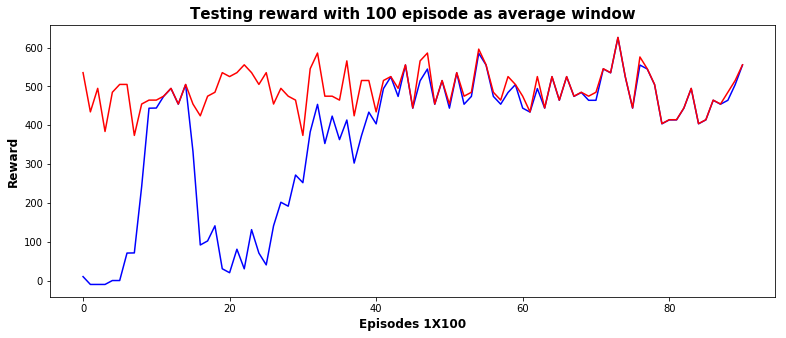

<Figure size 936x360 with 0 Axes>

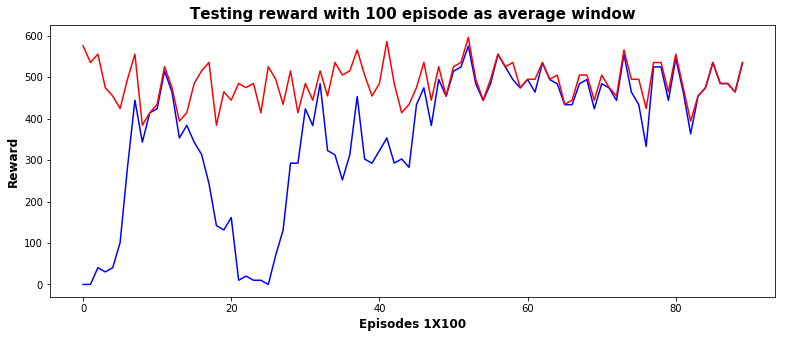

<Figure size 936x360 with 0 Axes>

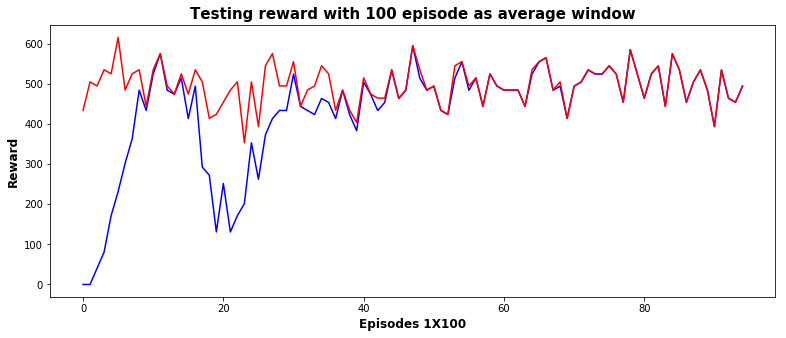

<Figure size 936x360 with 0 Axes>

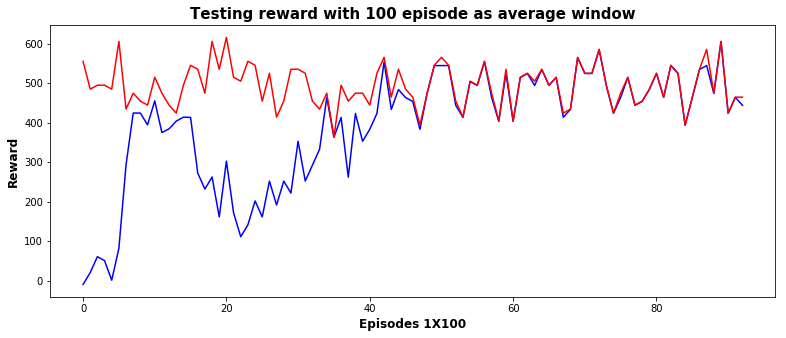

<Figure size 936x360 with 0 Axes>

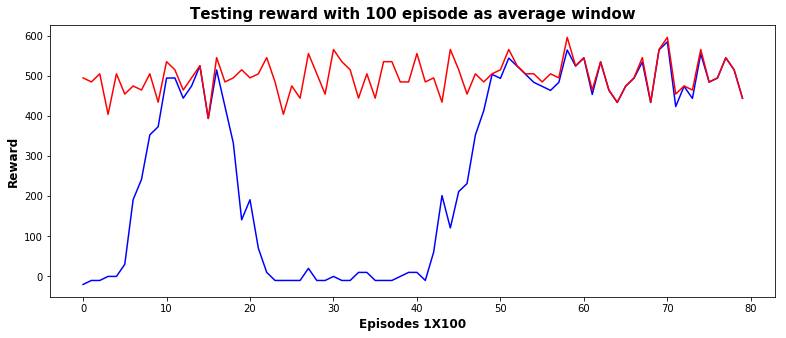

In [5]:
for i in range(1266,1273):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')

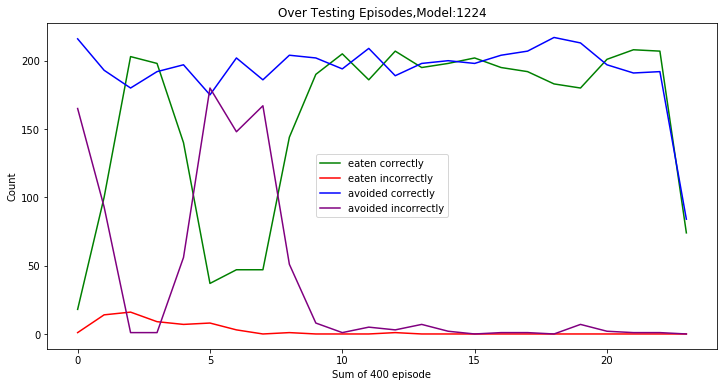

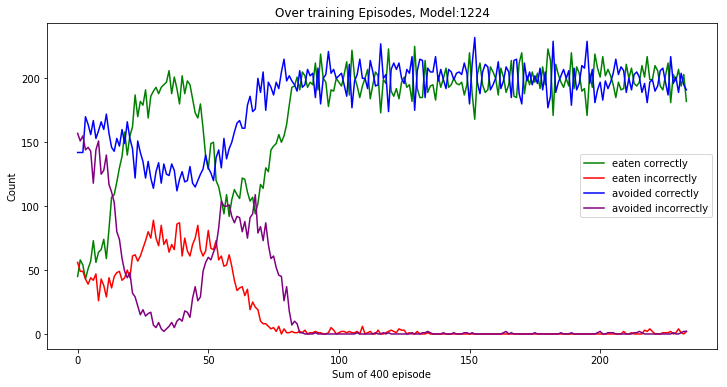

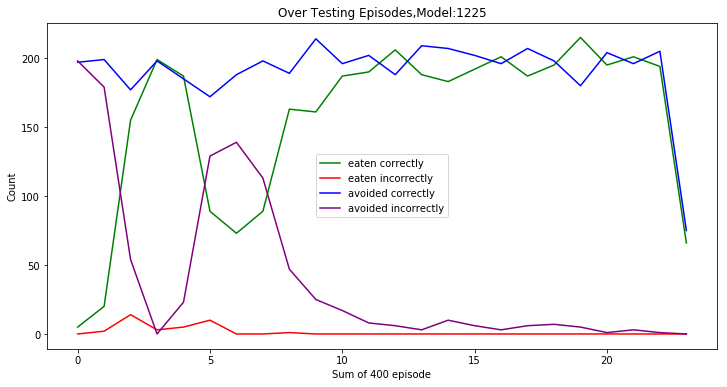

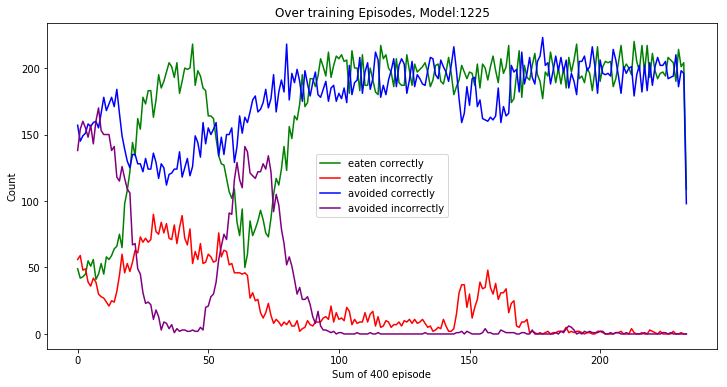

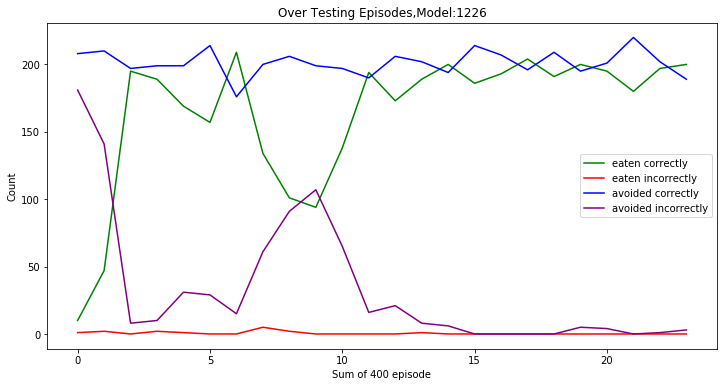

...

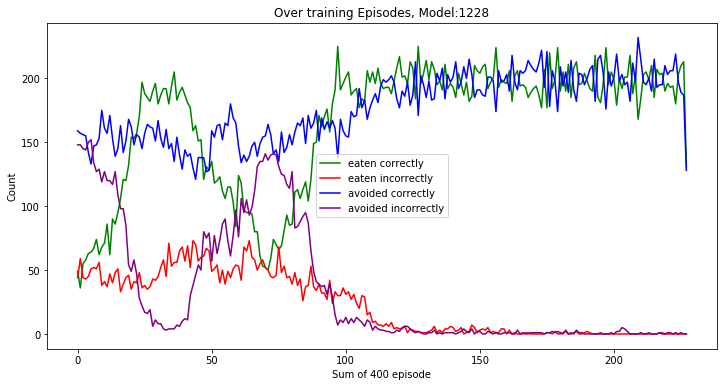

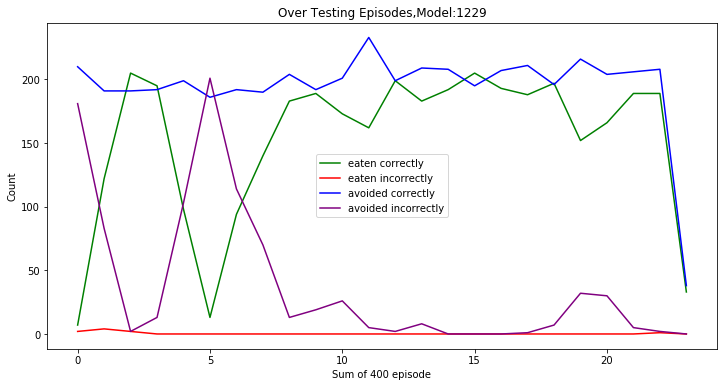

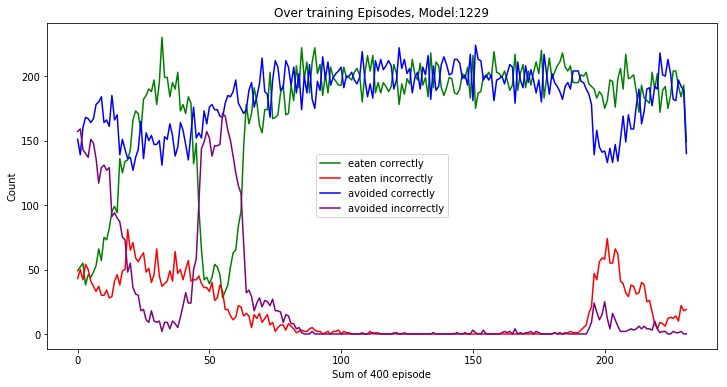

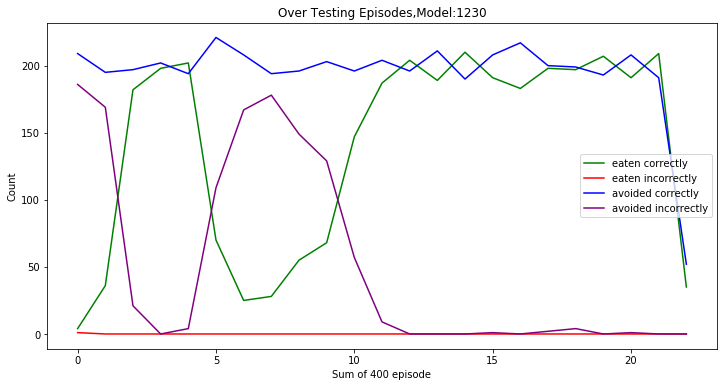

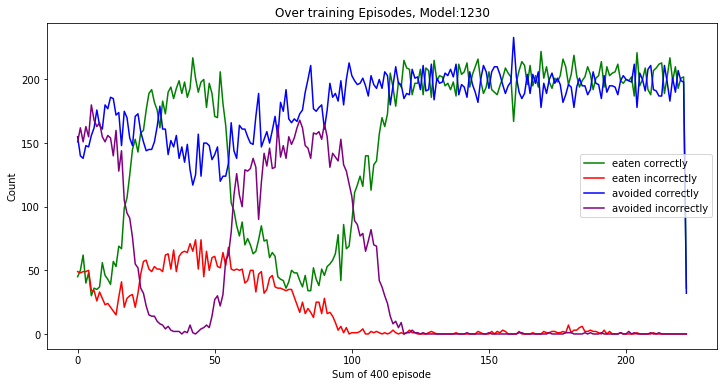

In [217]:
for i in range(1224,1231):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

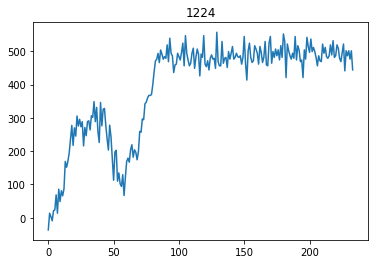

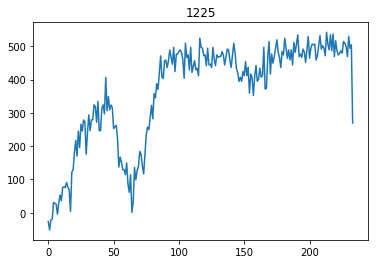

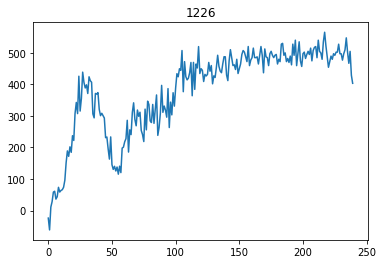

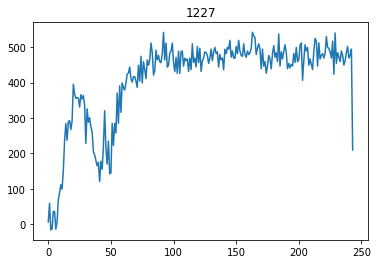

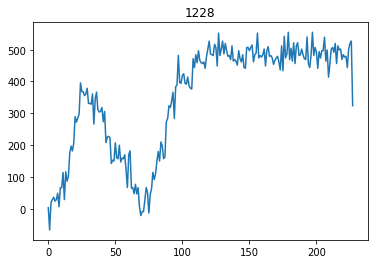

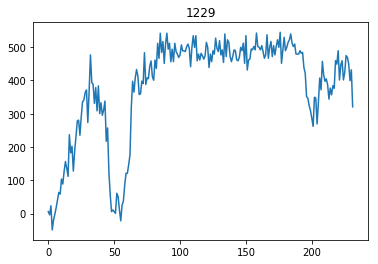

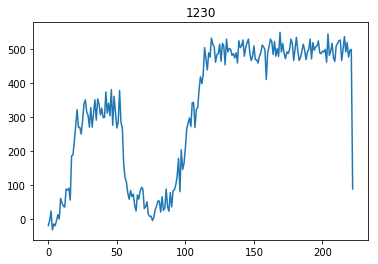

In [216]:
for i in range(1224,1231):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    x = x[x[5]=='train']
    plt.figure()
    plt.plot(calculate_mean_window(400,x[2]))
    plt.title(i)
    #plotdata(x,400,i)

In [8]:
def plot_experiment(i,titl,xlbl,ylbl,window=400,typ='train'):
    plt.figure(figsize=(13,5))
    tmp,perf = training_reward_window(window,i,typ)
    plt.figure(figsize=(13,5))
    plt.plot(tmp[:-1],c='b',label='Model')
    plt.plot(perf[:-1],c='r',label='Ground truth')
    plt.title(titl.format(window),fontweight='bold',fontsize=15)
    plt.xlabel(xlbl.format(window),fontweight='bold',fontsize=12)
    plt.ylabel(ylbl,fontweight='bold',fontsize=12)

    
def calculate_mean_window(c,vector):
    if vector.shape[0]%c !=0:
        rem = vector.shape[0]%c
        needed = c-rem
        needed = np.zeros(c-rem)
        vector = np.concatenate([vector,needed])
    vector = np.reshape(vector,(-1,c))
    std = np.std(vector,axis=1)
    vector = np.mean(vector,axis=1)
    return vector,std

def training_reward_window(window,model,T='train'):
    x = pd.read_csv('output/{}/exp_details.csv'.format(model),header=None)
    x = x[x[5]==T]
    y = x[8].copy()
    y[y==0]=1000
    y[y==1]=-10
    tmp,tmp_std = calculate_mean_window(window,x[2])
    perfect,perfect_std = calculate_mean_window(window,y)
    return tmp,tmp_std,perfect,perfect_std


In [17]:
tmp,tmp_std,perfect,perfect_std = training_reward_window(100,1230,'Test')

In [18]:
d_prime = tmp_std - perfect_std

In [19]:
denum = np.sqrt(0.5*(np.power(perfect_std,2)+np.power(tmp_std,2)))

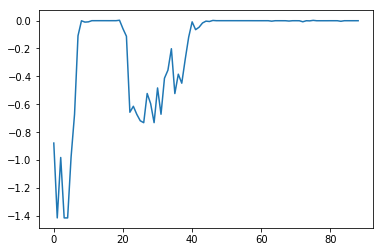

In [20]:
plt.plot(d_prime/denum)

In [76]:
x[(x[5]=='Test') & (x[8]==1) & (x[2]<-10)].head()

,0,1,2,3,4,5,6,7,8
351,32,11,-1001.1,0.245968,0,Test,0.0,0.0,1


In [121]:
x = pd.read_csv('output/{}/exp_details.csv'.format(1230),header=None)
print(x[(x[8]==0)].shape)
x[(x[8]==0)&(x[2]<0)].shape

(49018, 9)


(11832, 9)

In [109]:
x = pd.read_csv('output/{}/exp_details.csv'.format(1275),header=None)

In [111]:
x[(x[8]==0)&(x[2]<0)]

,0,1,2,3,4,5,6,7,8
1,2,100,-10.0,2.295528,0,Test,0,0,0
5,6,100,-10.0,2.352393,0,Test,0,0,0
6,7,100,-10.0,2.217931,0,Test,0,0,0
7,8,100,-10.0,2.492758,0,Test,0,0,0
10,11,100,-10.0,2.338560,0,Test,0,0,0
11,12,100,-10.0,2.297683,0,Test,0,0,0
13,14,100,-10.0,2.260471,0,Test,0,0,0
15,16,100,-10.0,2.497915,0,Test,0,0,0
16,17,100,-10.0,2.438222,0,Test,0,0,0
18,19,100,-10.0,2.190341,0,Test,0,0,0


In [ ]:
good = 18700
bad = 27500
perfect  = 47500

In [108]:
x[52248:52250]

,0,1,2,3,4,5,6,7,8
52248,47500,11,998.9,2.778771,0,train,334.704803,339.430389,0
52249,4750,8,999.2,0.182079,0,Test,0.000000,0.000000,0


(180, 200)

<Figure size 936x360 with 0 Axes>

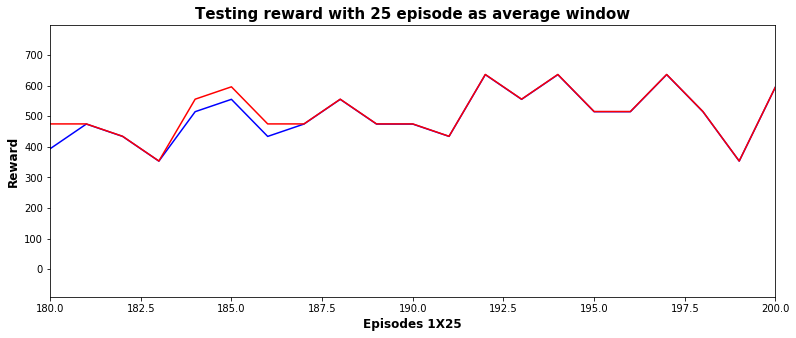

In [106]:
plot_experiment(1230,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=25,typ='Test')
plt.xlim(180,200)
#x = pd.read_csv('output/{}/exp_details.csv'.format(1230),header=None)
#l = plotdata(x,25,1230)

<Figure size 936x360 with 0 Axes>

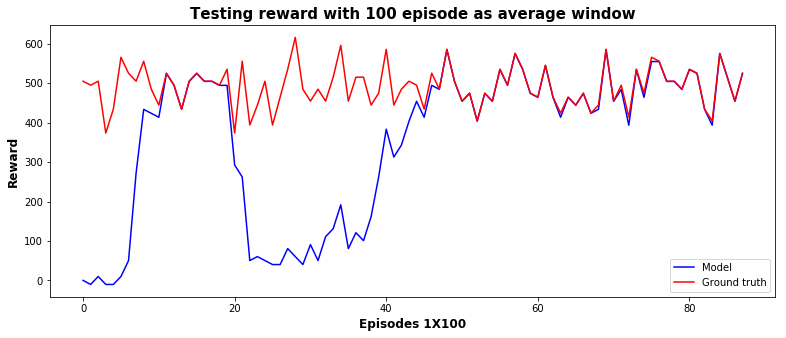

In [3]:
plot_experiment(1230,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
plt.legend()
plt.savefig('L1_reward.png')

### gradient clipping between [2,-2]

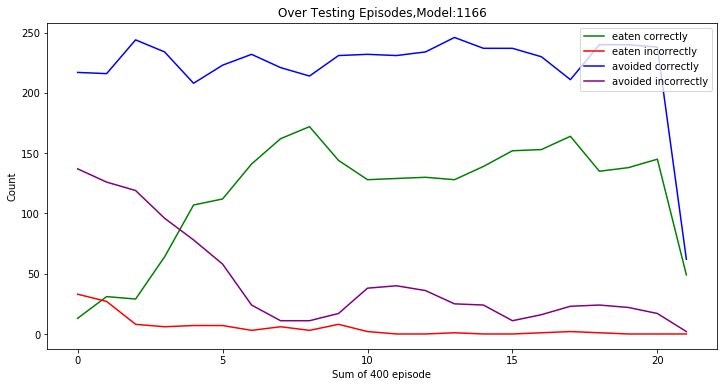

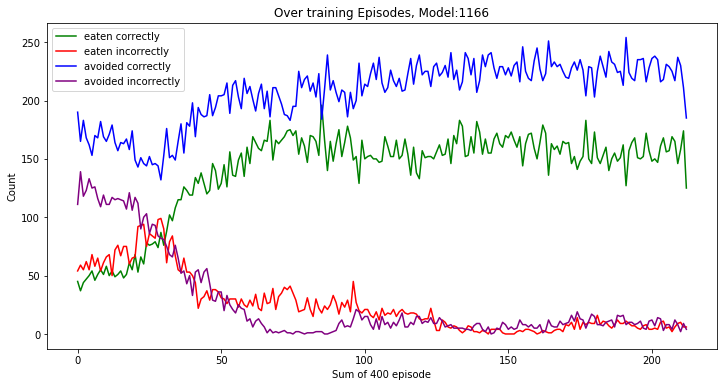

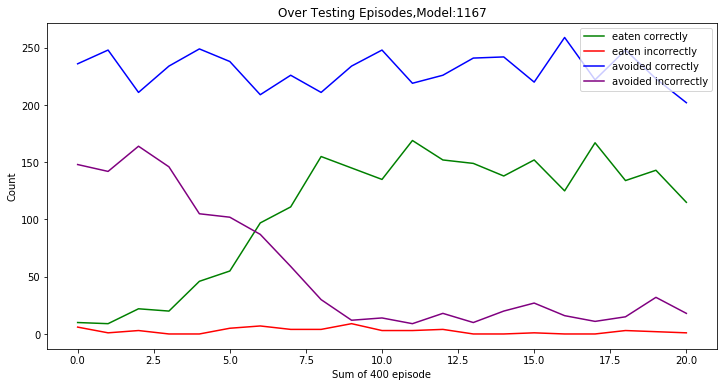

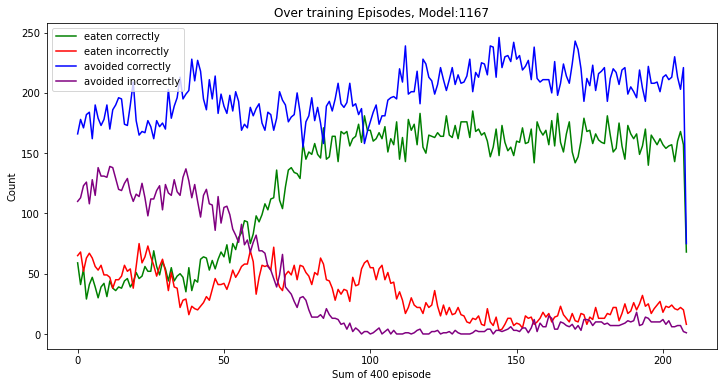

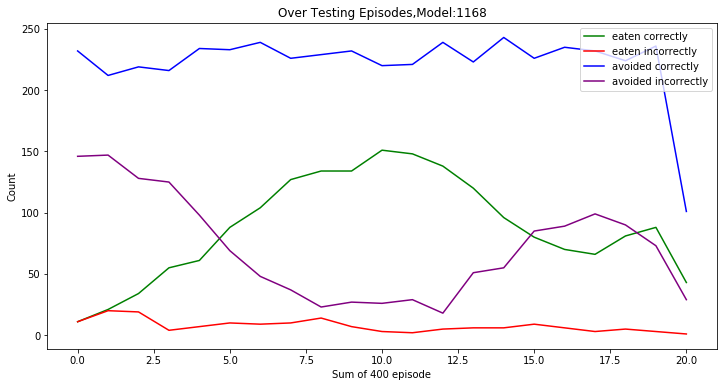

...

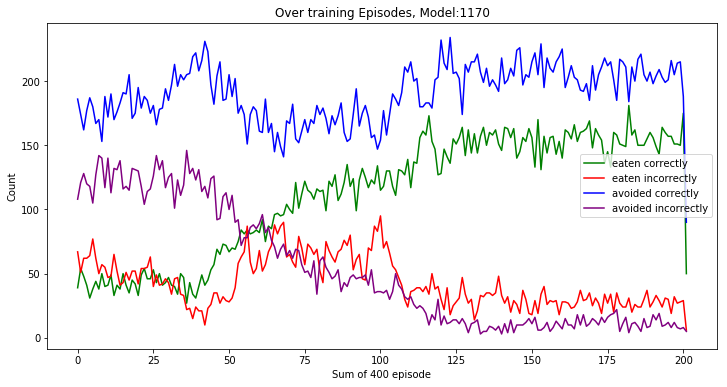

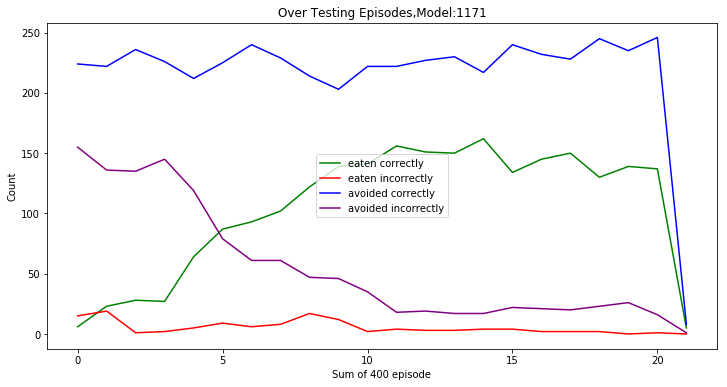

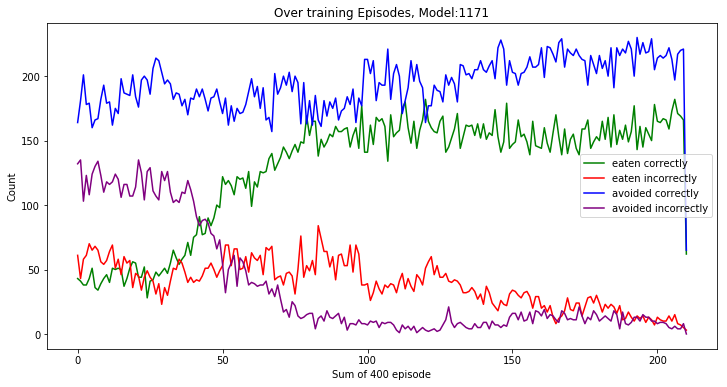

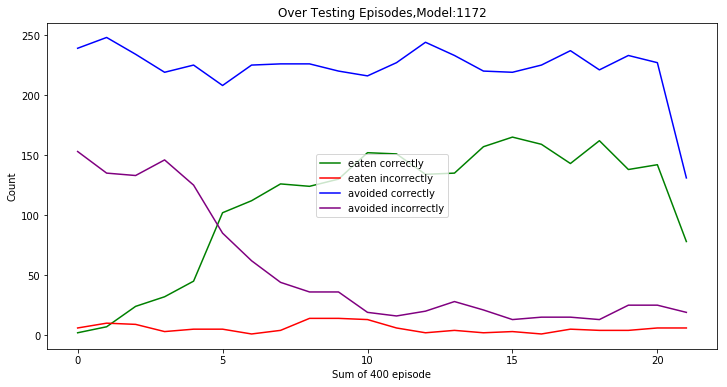

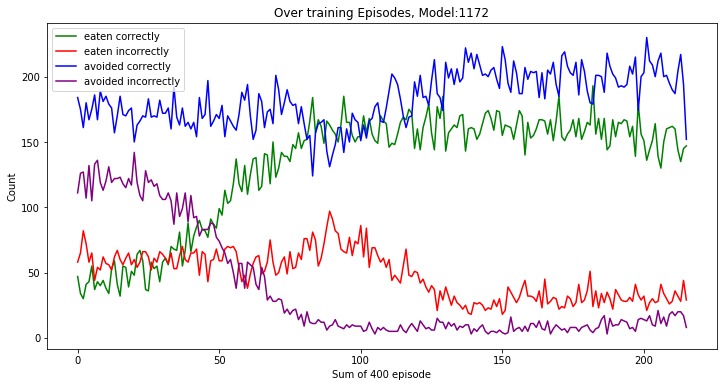

In [4]:
for i in range(1166,1173):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

<Figure size 936x360 with 0 Axes>

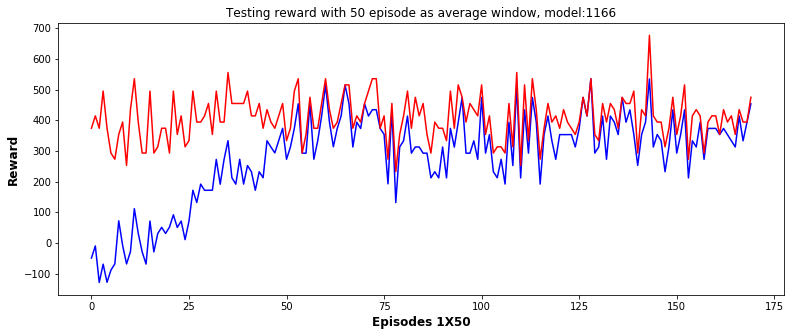

<Figure size 936x360 with 0 Axes>

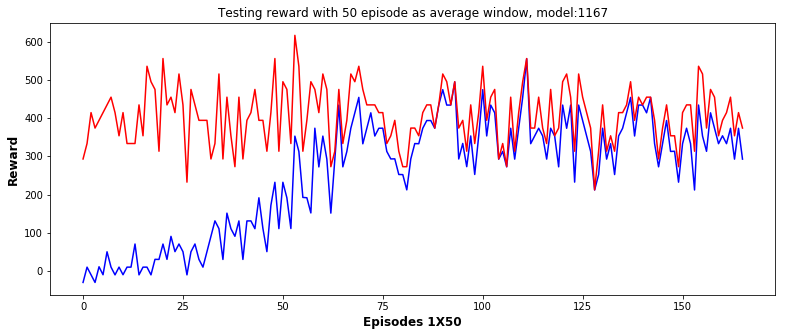

<Figure size 936x360 with 0 Axes>

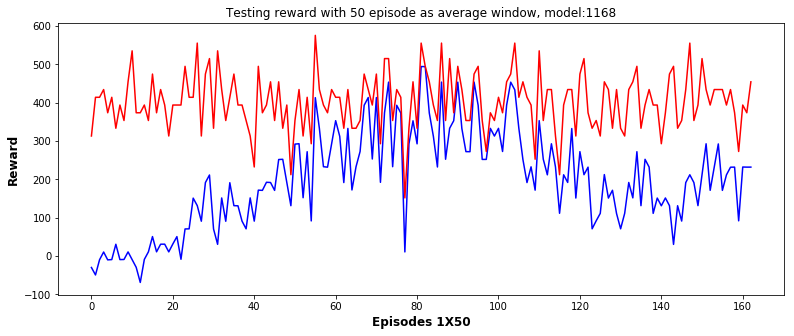

<Figure size 936x360 with 0 Axes>

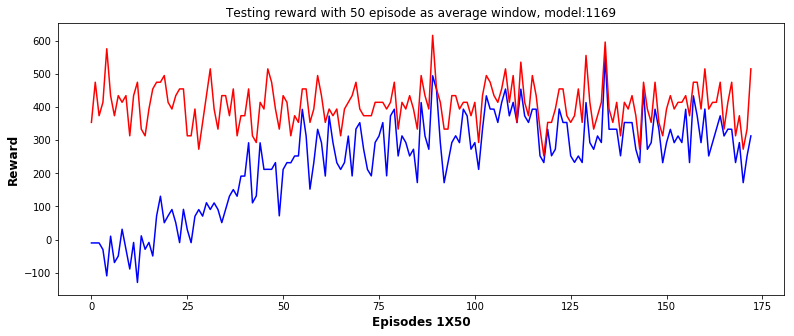

<Figure size 936x360 with 0 Axes>

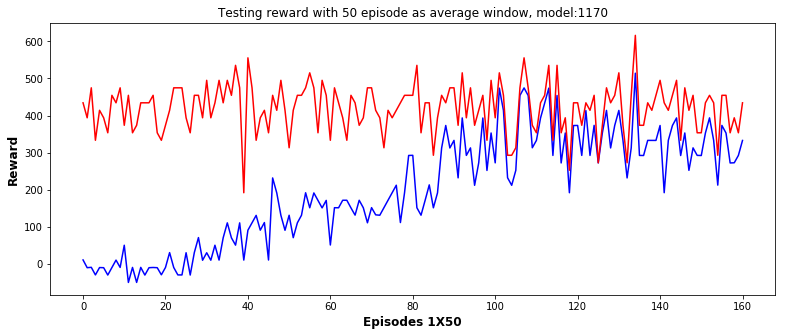

<Figure size 936x360 with 0 Axes>

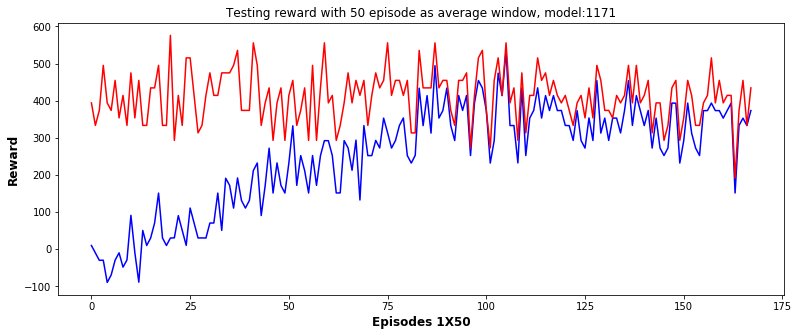

<Figure size 936x360 with 0 Axes>

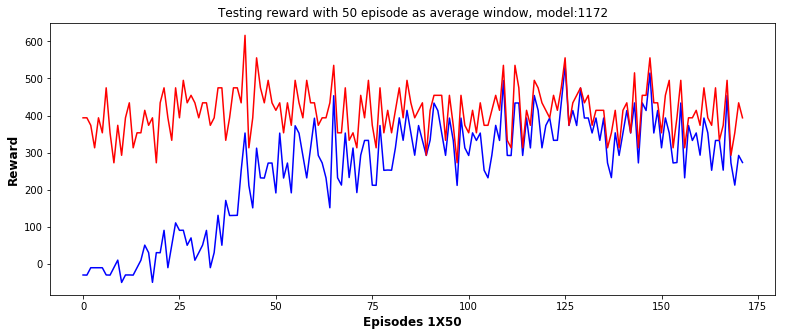

In [20]:
for i in range(1166,1173):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=50,typ='Test')
    plt.title('Testing reward with {} episode as average window, model:{}'.format(50,i))
    #tmp = training_reward_window(400,i)
    #plt.figure()
    #plt.plot(tmp)
    #plt.title('Model:{}'.format(i))

<Figure size 936x360 with 0 Axes>

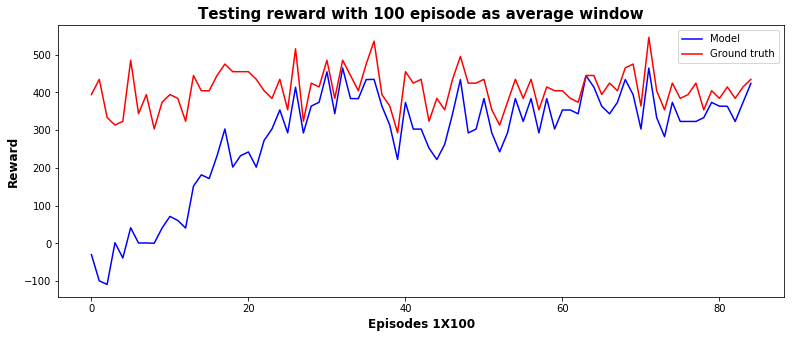

In [26]:
plot_experiment(1166,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
plt.legend()
plt.savefig('L2_reward.png')

### L3 complexity, # 6M steps

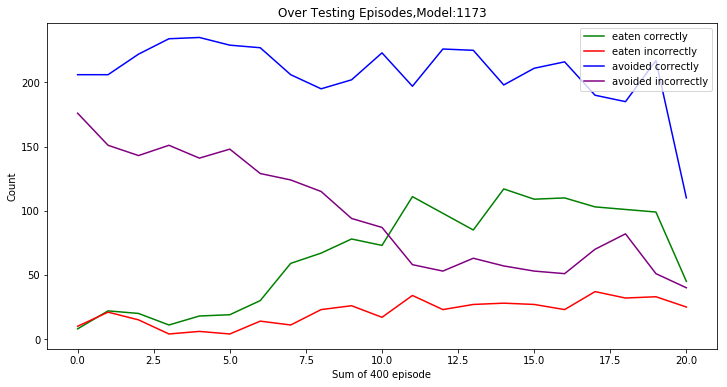

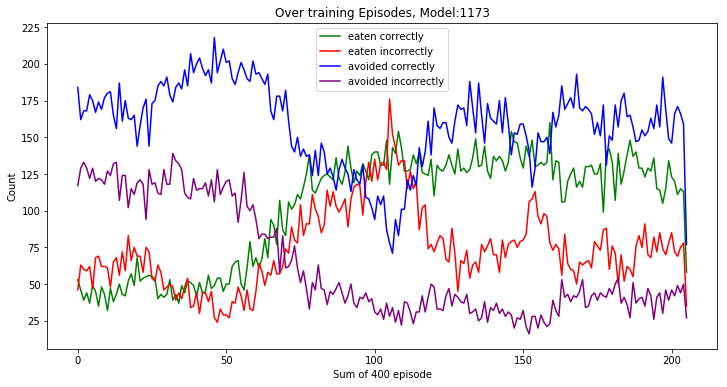

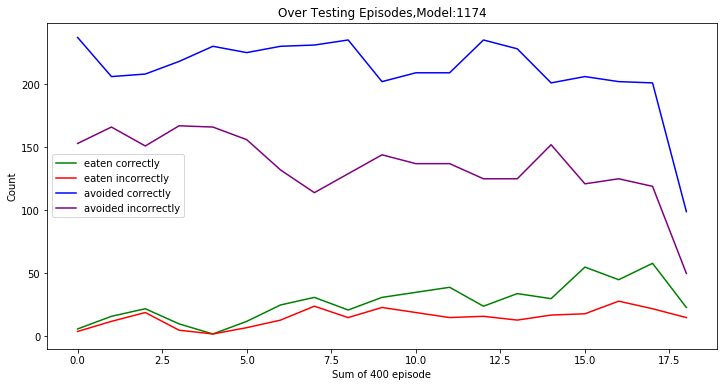

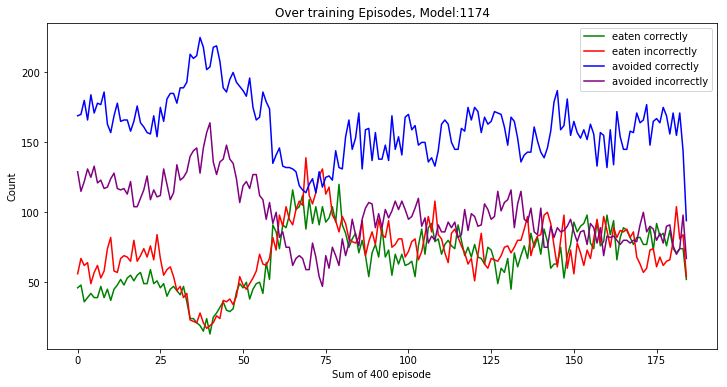

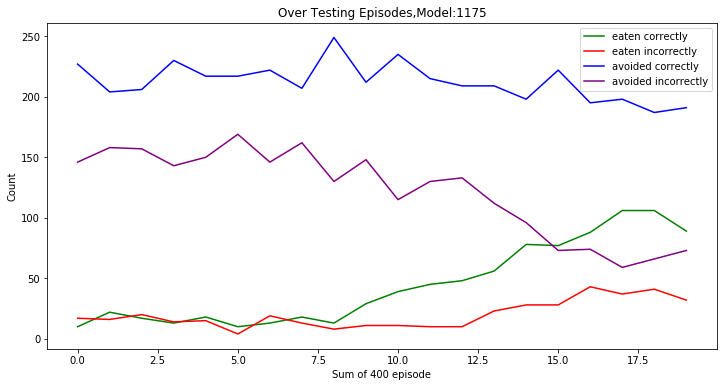

...

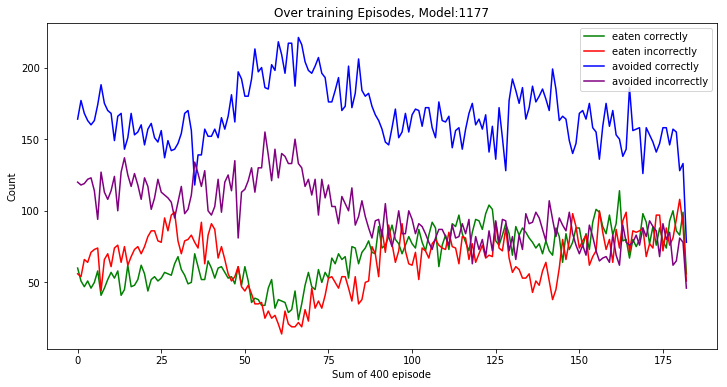

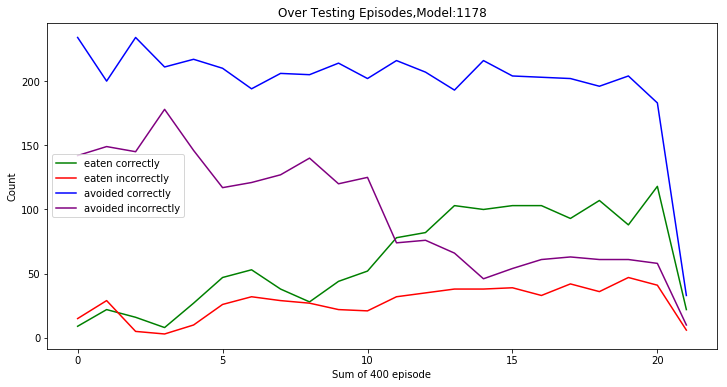

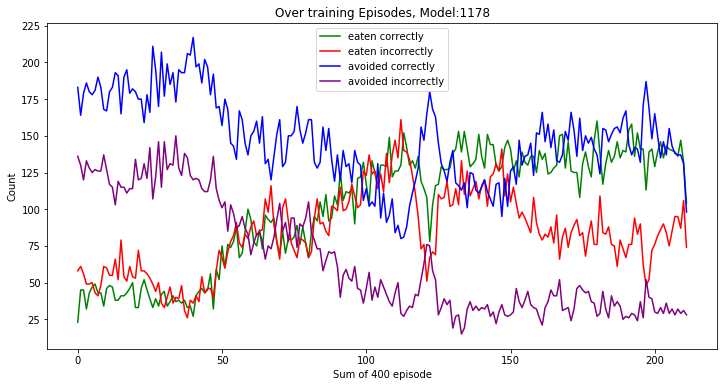

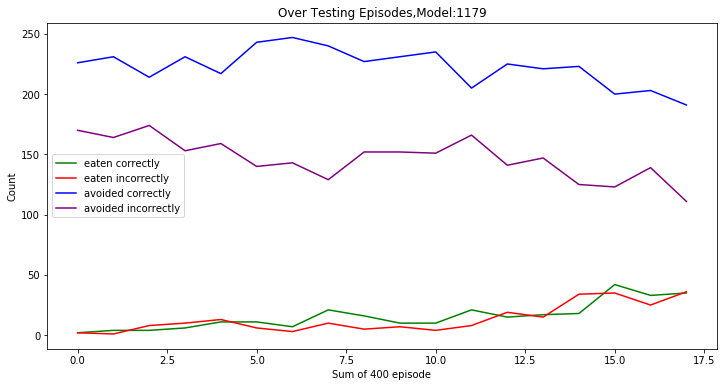

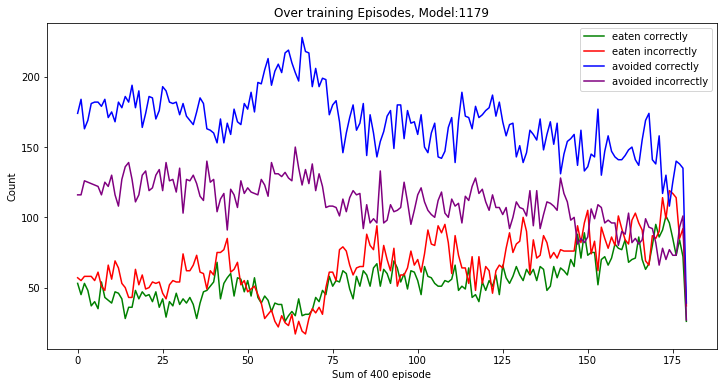

In [3]:
for i in range(1173,1180):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

### L3 complexity, # 20M steps

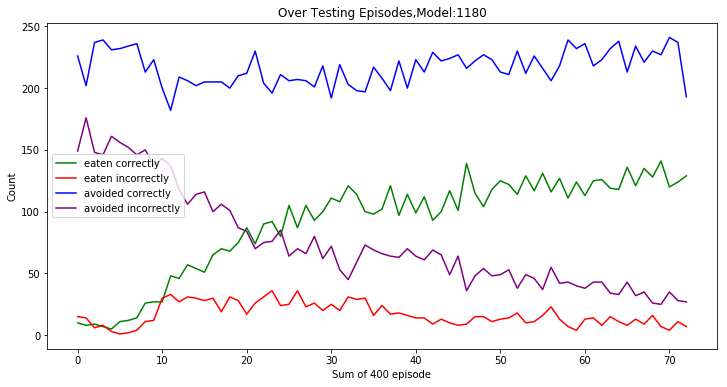

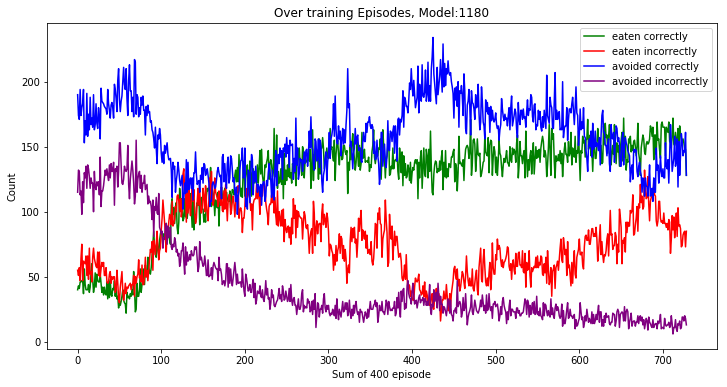

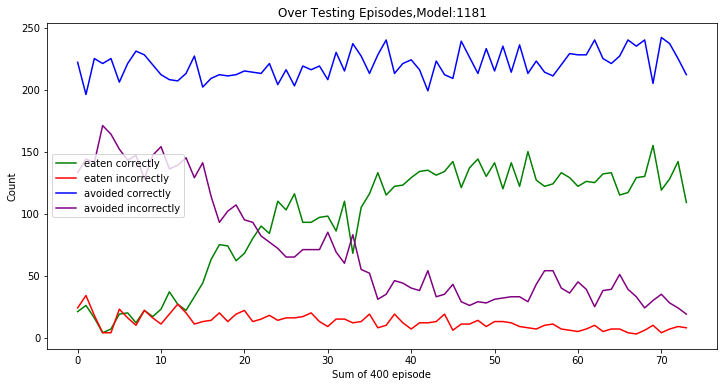

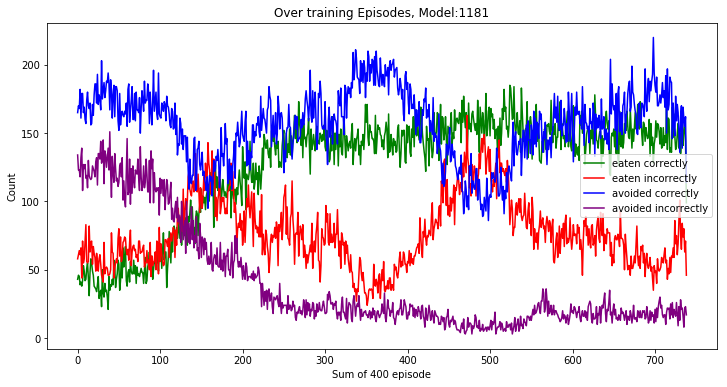

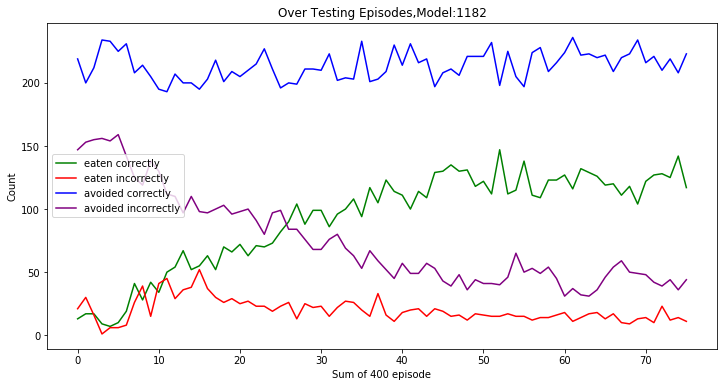

...

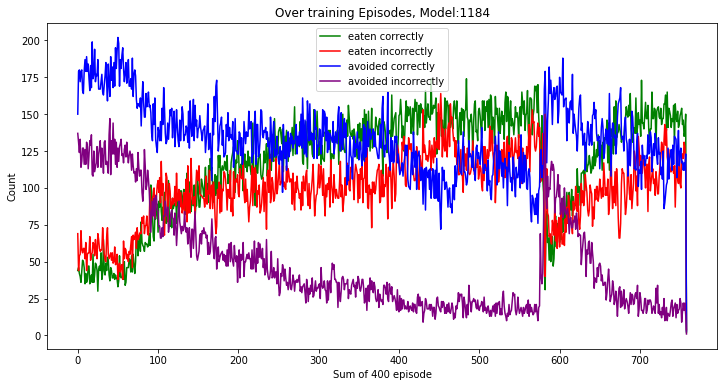

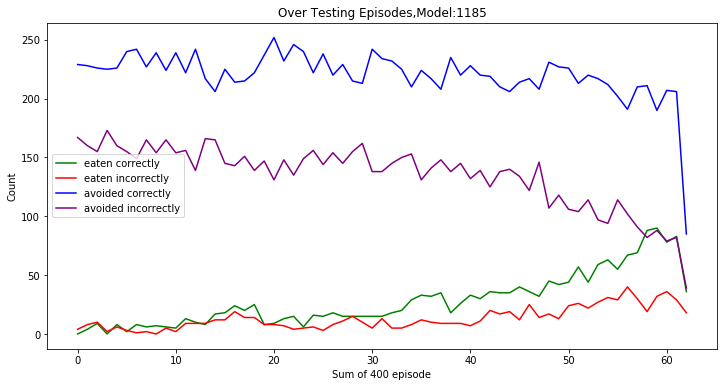

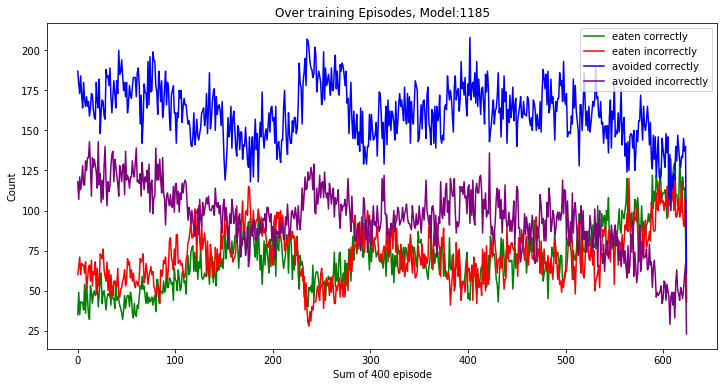

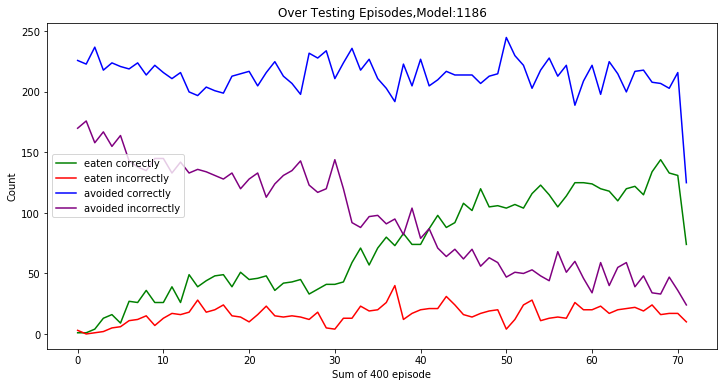

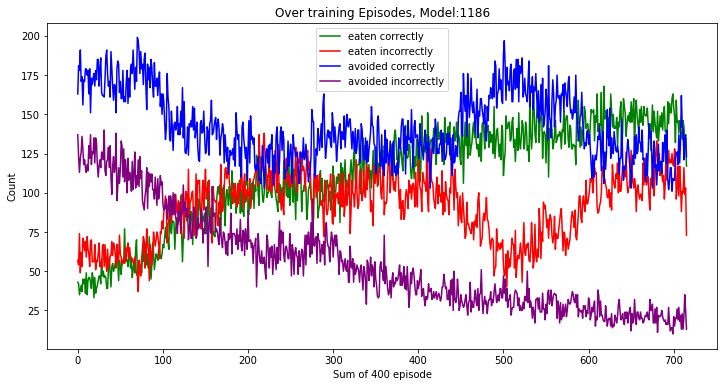

In [3]:
for i in range(1180,1187):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

<Figure size 936x360 with 0 Axes>

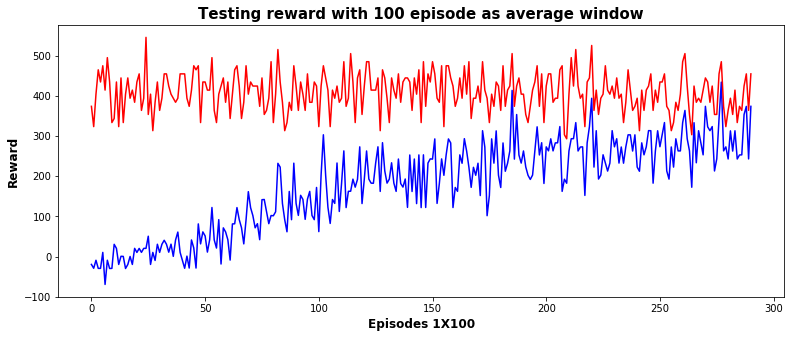

<Figure size 936x360 with 0 Axes>

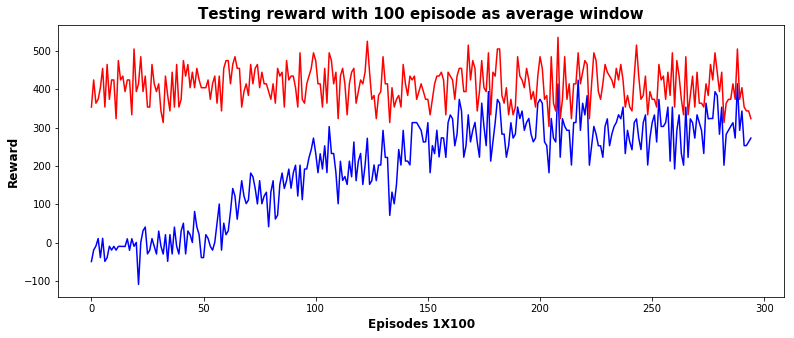

<Figure size 936x360 with 0 Axes>

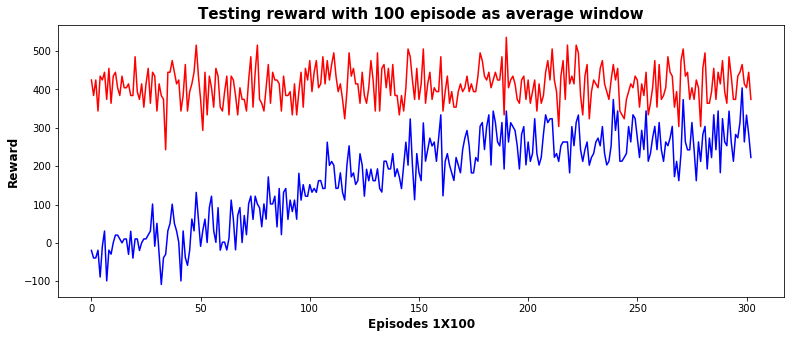

<Figure size 936x360 with 0 Axes>

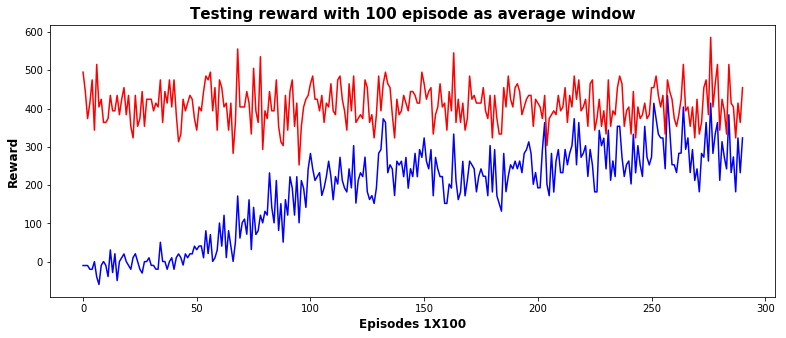

<Figure size 936x360 with 0 Axes>

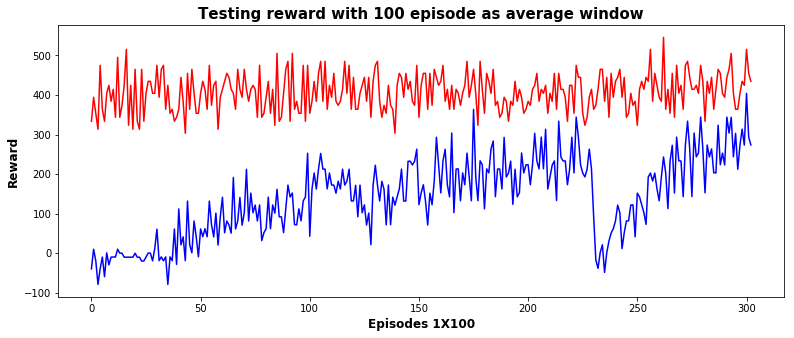

<Figure size 936x360 with 0 Axes>

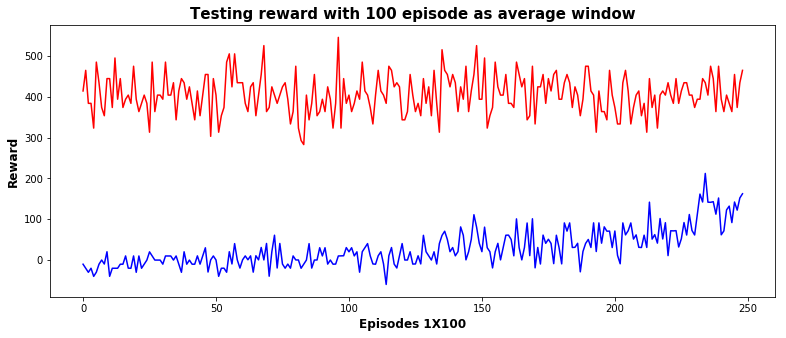

<Figure size 936x360 with 0 Axes>

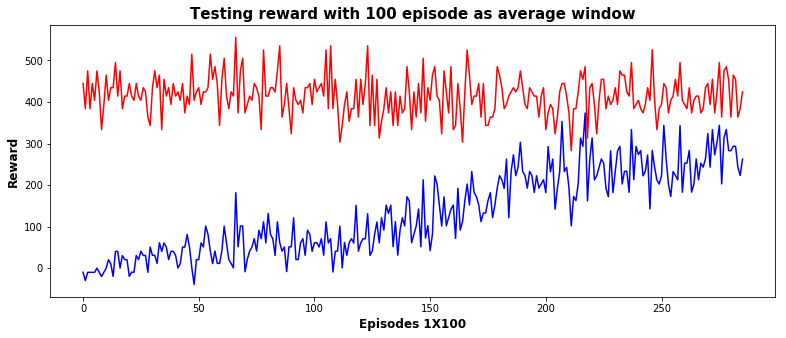

In [27]:
for i in range(1180,1187):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')

<Figure size 936x360 with 0 Axes>

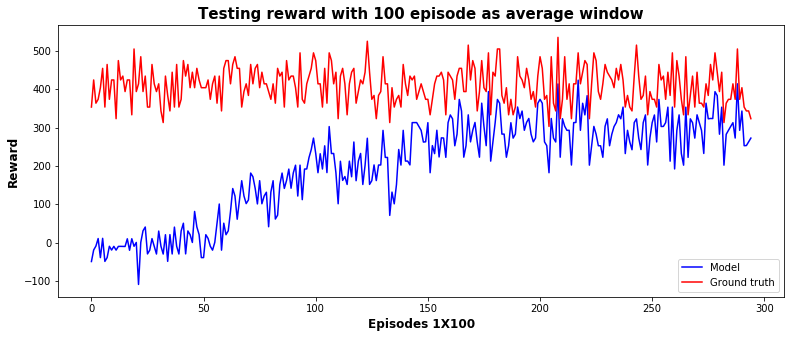

In [28]:
plot_experiment(1181,titl='Testing reward with {} episode as average window',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
plt.legend()
plt.savefig('L3_reward.png') 

### Test run for L3 for 21 episodes, turnout to be 13 shoud avoid (11 avoided), and 8 should eat (6 eaten).

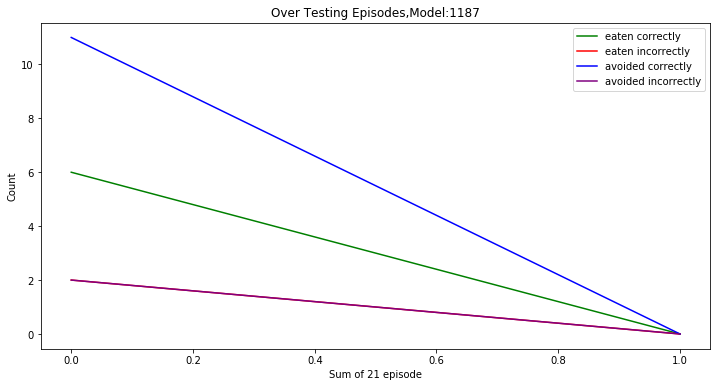

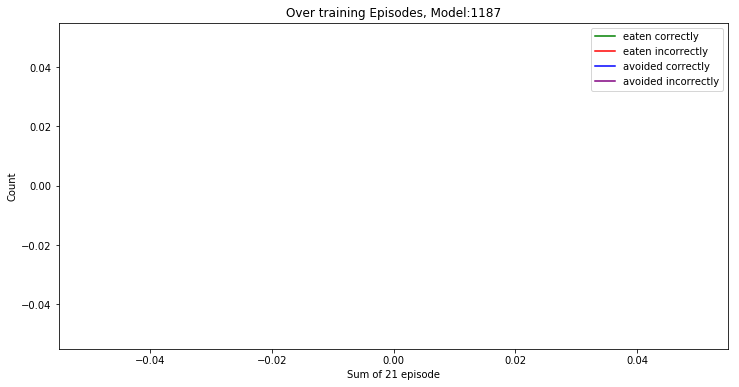

In [3]:
for i in range(1187,1188):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    one,two = plotdata(x,21,i)

In [5]:
two

array([[  6.,   2.,  11.,   2.],
       [  0.,   0.,   0.,   0.]])

In [ ]:
x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)

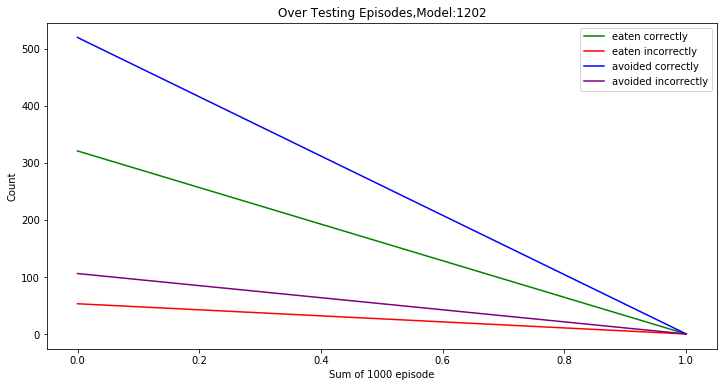

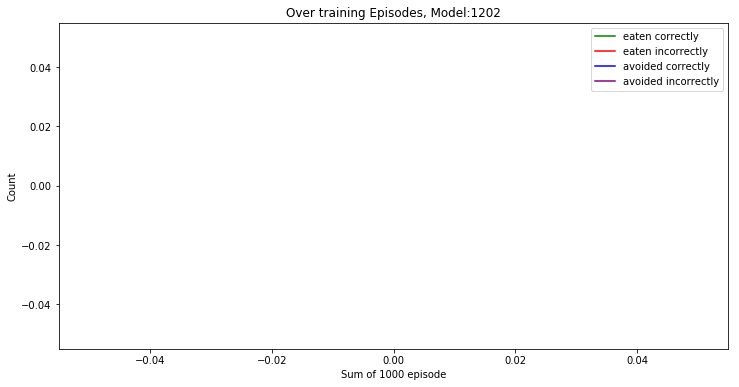

In [237]:
for i in range(1202,1203):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    one,two = plotdata(x,1000,i)

In [37]:
x = pd.read_csv('output/{}/exp_details.csv'.format(1202),header=None)

In [46]:
x[(x[8]==0)&(x[2]<0)]

,0,1,2,3,4,5,6,7,8
0,1,100,-10.0,3.526167,0,Test,0,0,0
3,4,100,-10.0,2.433467,0,Test,0,0,0
5,6,100,-10.0,2.308564,0,Test,0,0,0
38,39,100,-10.0,2.163428,0,Test,0,0,0
45,46,100,-10.0,2.320416,0,Test,0,0,0
46,47,100,-10.0,2.245826,0,Test,0,0,0
66,67,100,-10.0,2.146622,0,Test,0,0,0
92,93,100,-10.0,2.430448,0,Test,0,0,0
109,110,100,-10.0,2.629121,0,Test,0,0,0
115,116,100,-10.0,2.424891,0,Test,0,0,0


In [44]:
x[(x[8]==1)&(x[2]<-100)]

,0,1,2,3,4,5,6,7,8
18,19,17,-1001.7,0.540593,0,Test,0,0,1
34,35,10,-1001.0,0.322253,0,Test,0,0,1
36,37,14,-1001.4,0.379492,0,Test,0,0,1
67,68,7,-1000.7,0.198699,0,Test,0,0,1
75,76,10,-1001.0,0.270907,0,Test,0,0,1
83,84,8,-1000.8,0.236704,0,Test,0,0,1
107,108,7,-1000.7,0.247699,0,Test,0,0,1
130,131,8,-1000.8,0.252949,0,Test,0,0,1
174,175,8,-1000.8,0.305876,0,Test,0,0,1
268,269,17,-1001.7,0.459826,0,Test,0,0,1


In [255]:
520/(520+ 106)

0.8306709265175719

In [254]:
321/(53+321)

0.8582887700534759

In [238]:
two

array([[321.,  53., 520., 106.],
       [  0.,   0.,   0.,   0.]])

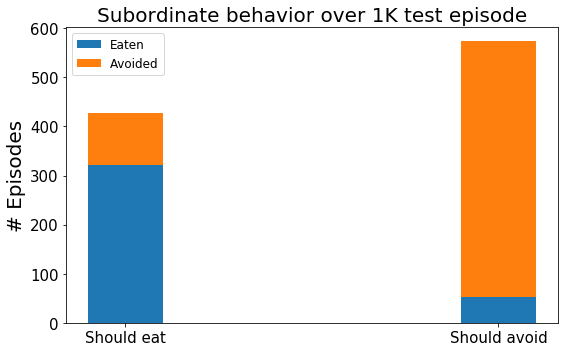

In [6]:
N = 2
menMeans = (321, 53)
womenMeans = (106,520)
ind = np.arange(N)    # the x locations for the groups
width = 0.2      # the width of the bars: can also be len(x) sequence
plt.figure(figsize=(8,5))
ax = plt.subplot(1,1,1)
p1 = ax.bar(ind, menMeans, width)
p2 = ax.bar(ind, womenMeans, width,bottom=menMeans)
ax.set_ylabel('# Episodes',fontsize=20,**hfont)
ax.set_title('Subordinate behavior over 1K test episode',fontsize=20,**csfont)
plt.setp(ax, xticks=ind, xticklabels=('Should eat', 'Should avoid'))
for label in ax.get_xticklabels():
    label.set_fontproperties(ticks_font)
for label in ax.get_yticklabels():
    label.set_fontproperties(ticks_font)
#plt.yticks(np.arange(0, 81, 10))
ax.legend((p1[0], p2[0]), ('Eaten', 'Avoided'),prop=legend_font)
plt.tight_layout()
#plt.savefig('barplot.png')
plt.show()

(75.17564402810305, 90.75043630017451) (24.824355971896956, 9.24956369982548)


/home/aqeel/miniconda3/envs/Py3_ICNS/lib/python3.6/site-packages/matplotlib/font_manager.py:1238: UserWarning: findfont: Font family ['helvetica-light-587ebe5a59211'] not found. Falling back to DejaVu Sans.
  (prop.get_family(), self.defaultFamily[fontext]))


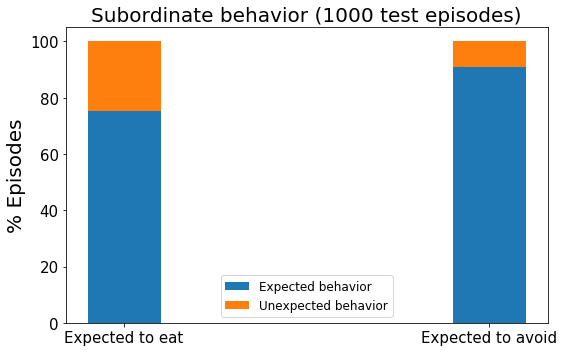

In [4]:
N = 2
totale = 321+106
totala=53+520
seat = (100*321/totale,520*100/totala )

savoid = (106*100/totale,100*53/totala)
print(seat,savoid)

ind = np.arange(N)    # the x locations for the groups
width = 0.2      # the width of the bars: can also be len(x) sequence
plt.figure(figsize=(8,5))
ax = plt.subplot(1,1,1)
p1 = ax.bar(ind, seat, width)
p2 = ax.bar(ind, savoid, width,bottom=seat)
ax.set_ylabel('% Episodes',fontsize=20,**hfont)

ax.set_title('Subordinate behavior (1000 test episodes)',fontsize=20,**csfont)
plt.setp(ax, xticks=ind, xticklabels=('Expected to eat', 'Expected to avoid'))
for label in ax.get_xticklabels():
    label.set_fontproperties(ticks_font)
for label in ax.get_yticklabels():
    label.set_fontproperties(ticks_font)
#plt.yticks(np.arange(0, 81, 10))
ax.legend((p1[0], p2[0]), ('Expected behavior', 'Unexpected behavior'),prop=legend_font)
plt.tight_layout()
plt.savefig('barplot.png')
plt.show()

### ego-centric L1 experiment

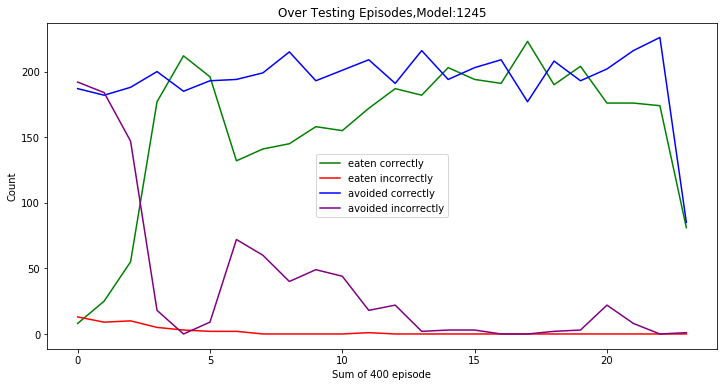

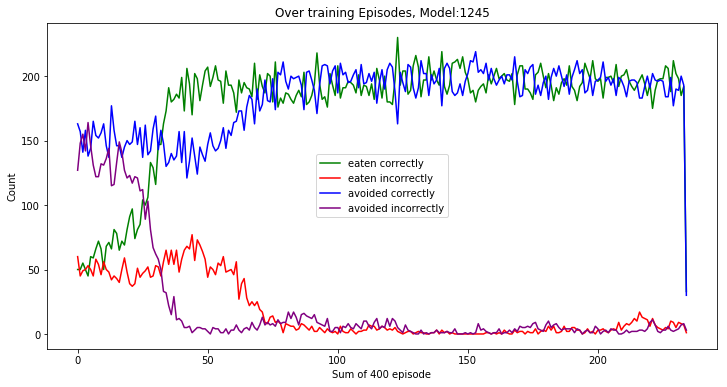

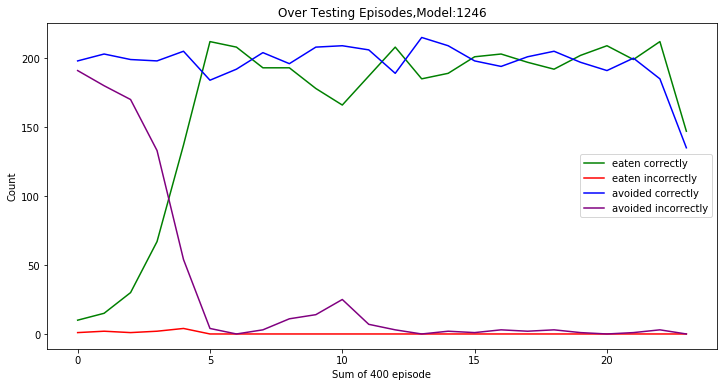

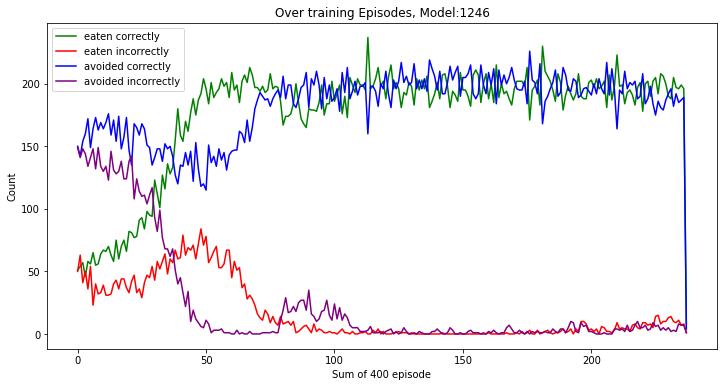

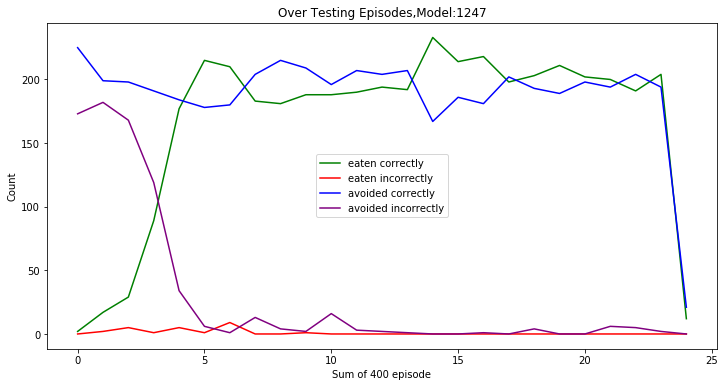

...

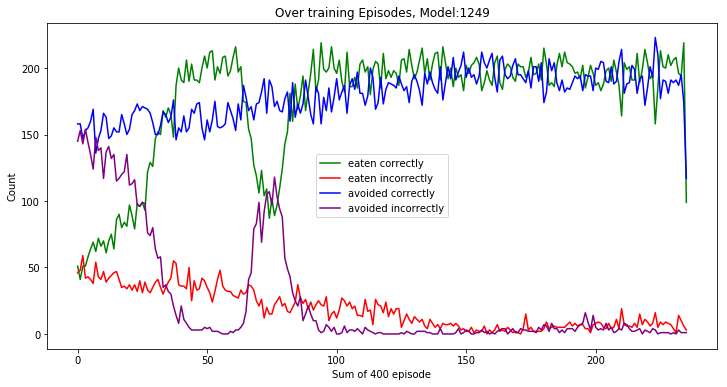

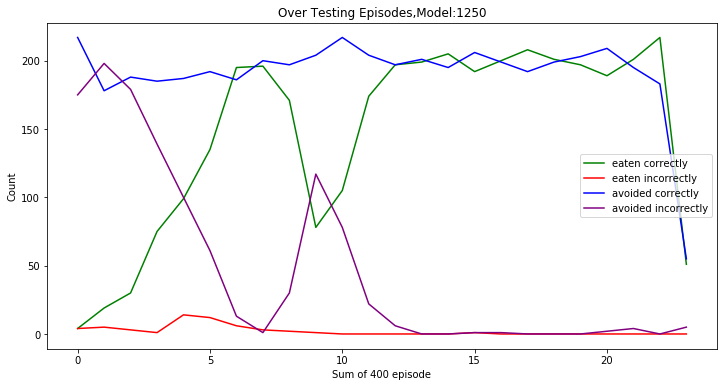

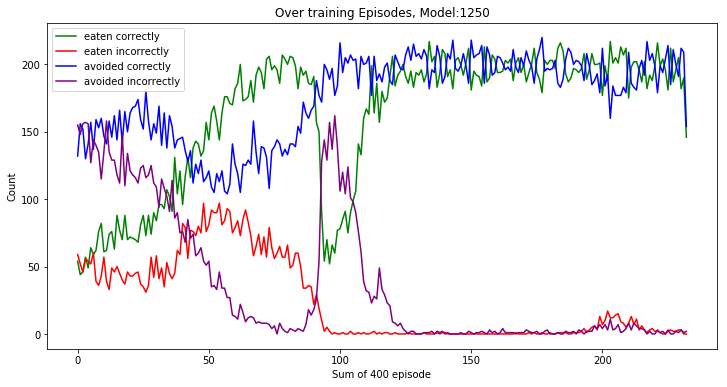

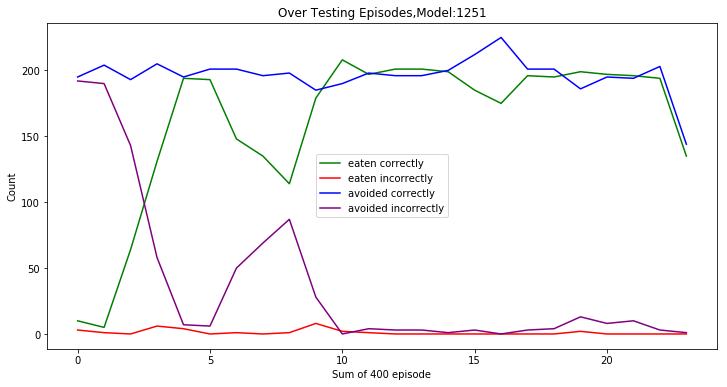

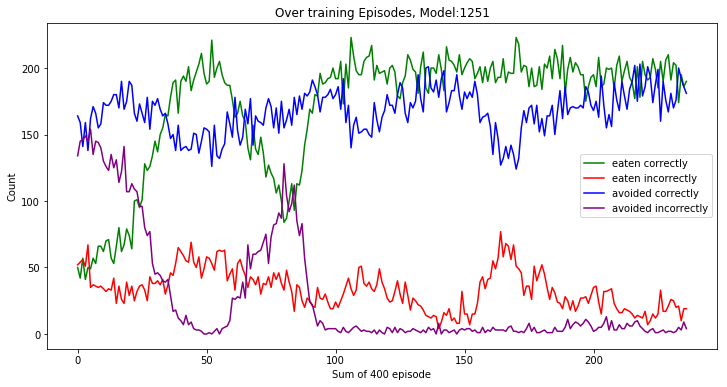

In [7]:
for i in range(1245,1252):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

<Figure size 936x360 with 0 Axes>

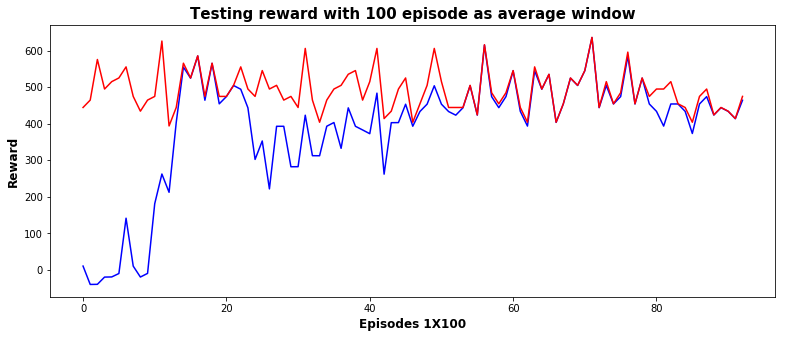

<Figure size 936x360 with 0 Axes>

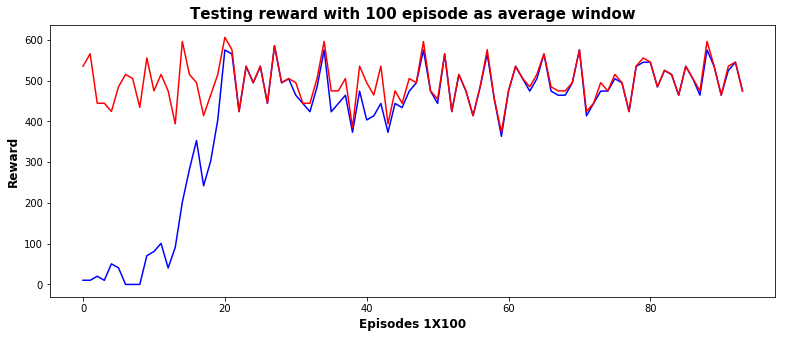

<Figure size 936x360 with 0 Axes>

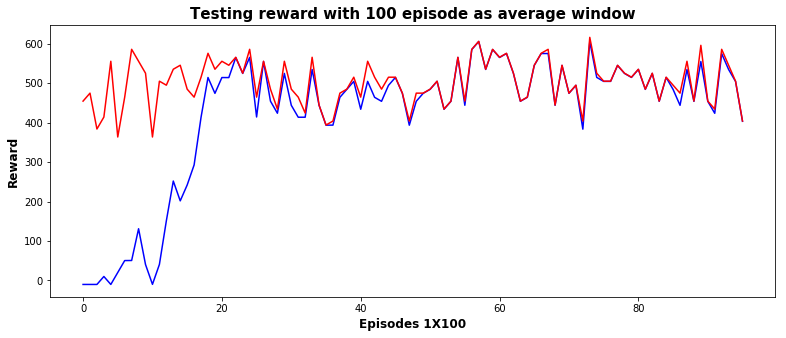

<Figure size 936x360 with 0 Axes>

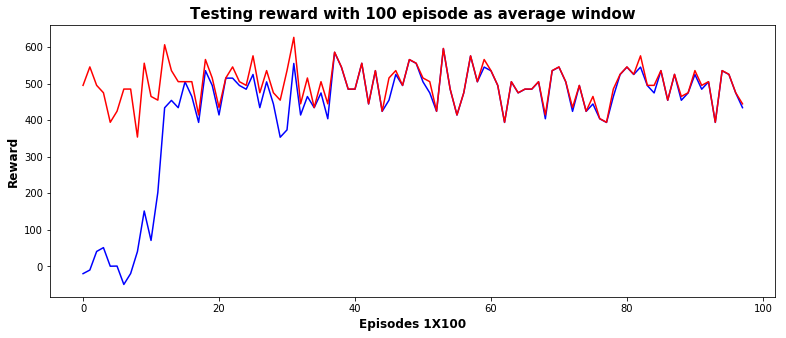

<Figure size 936x360 with 0 Axes>

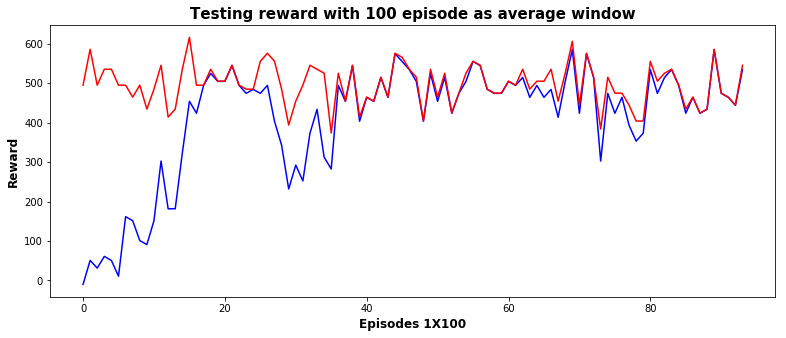

<Figure size 936x360 with 0 Axes>

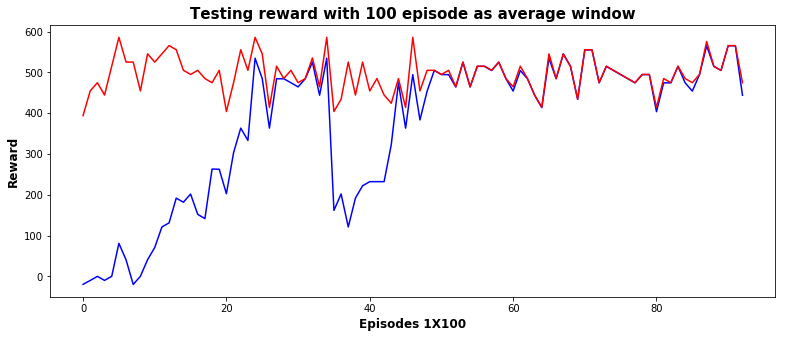

<Figure size 936x360 with 0 Axes>

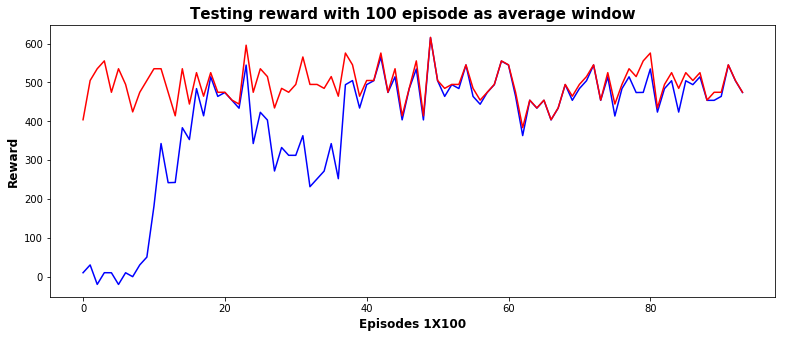

In [29]:
for i in range(1245,1252):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                    xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')

<Figure size 936x360 with 0 Axes>

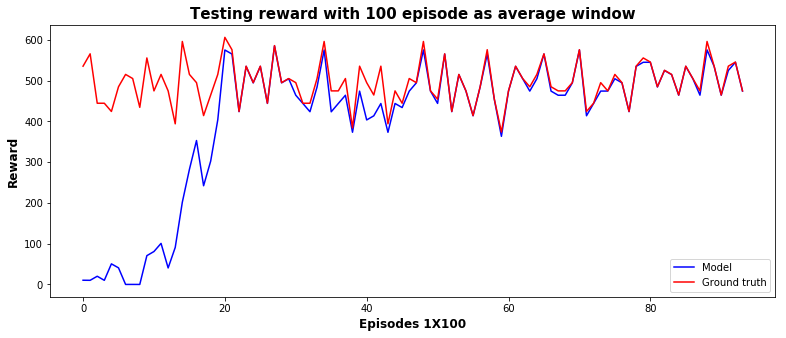

In [30]:
plot_experiment(1246,titl='Testing reward with {} episode as average window',
                    xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
plt.legend()
plt.savefig('ego_l1_rew.png')

### ego-centric L2 experiment

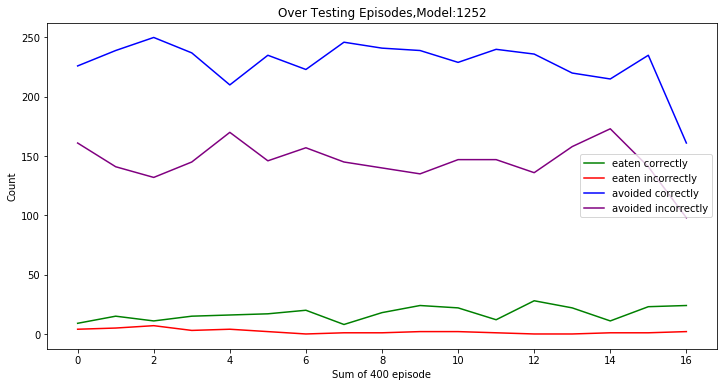

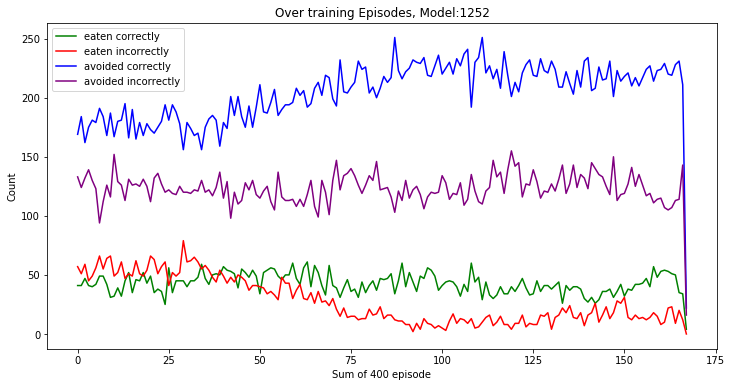

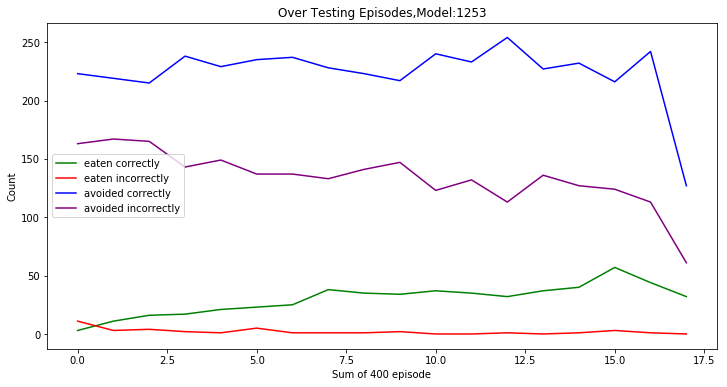

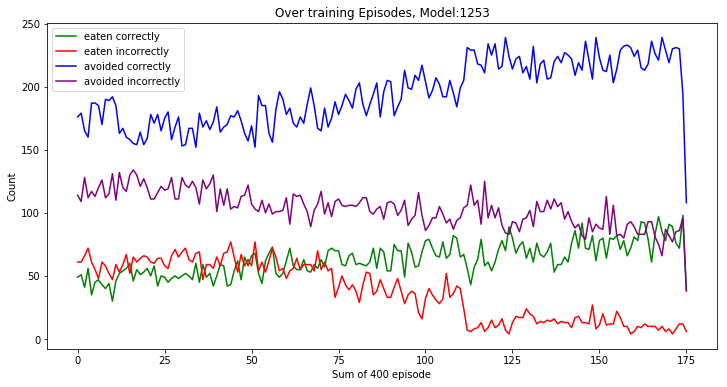

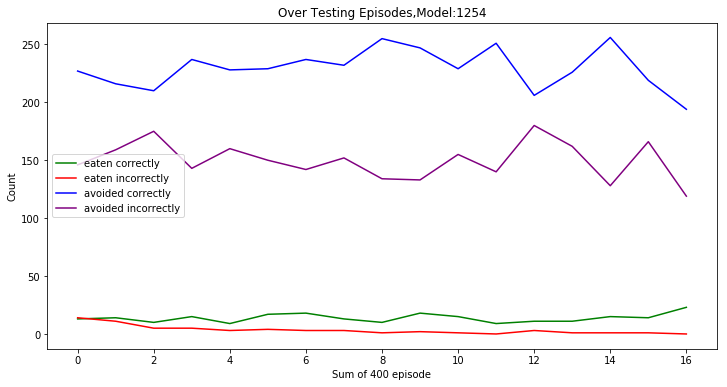

...

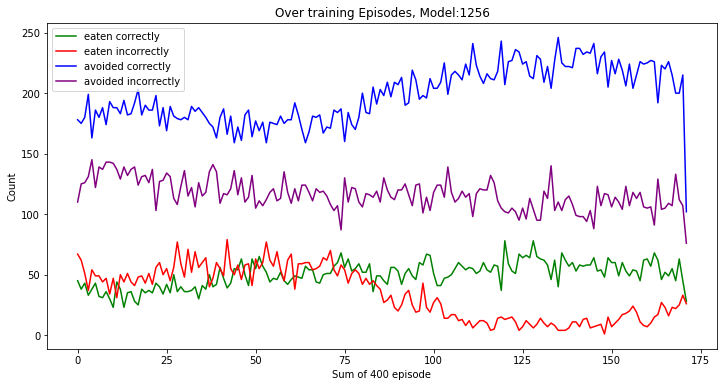

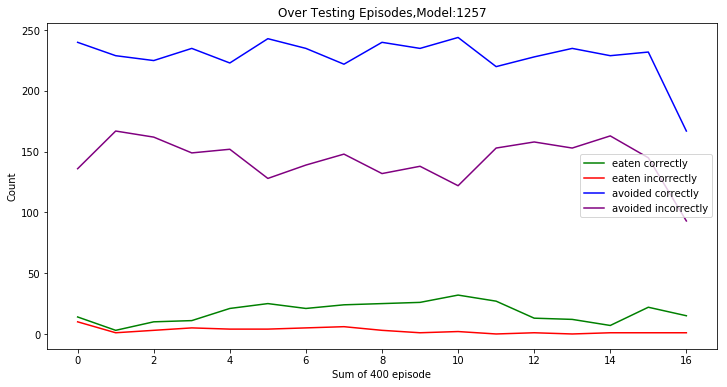

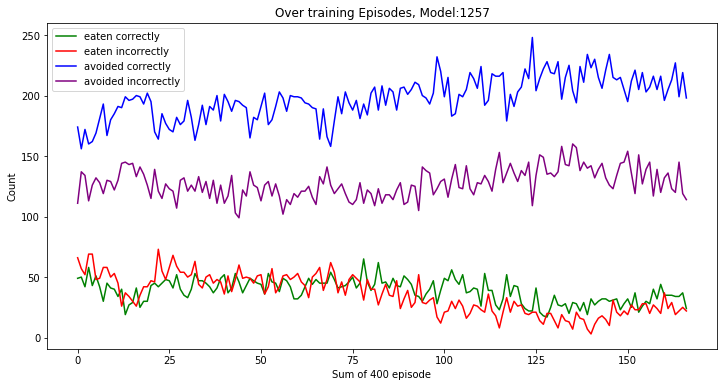

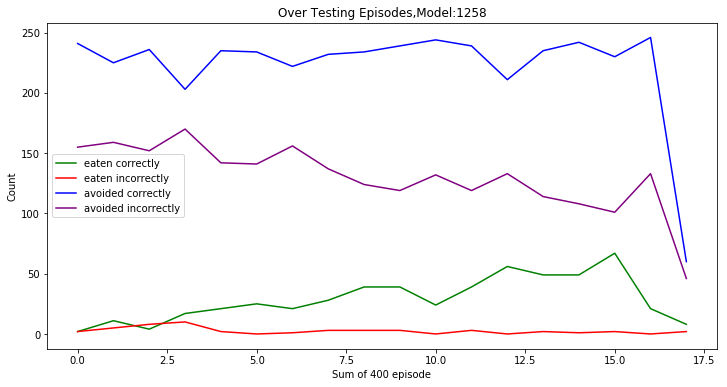

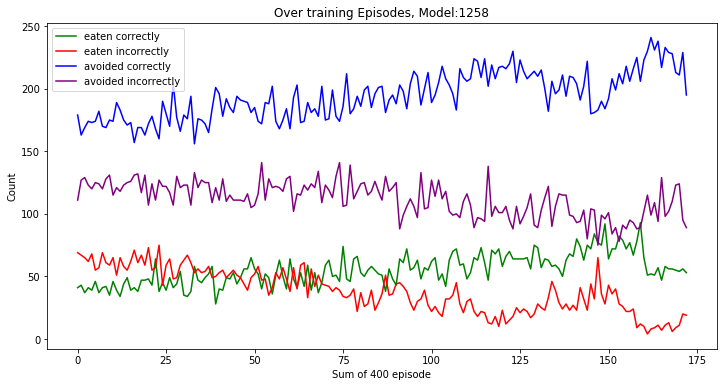

In [9]:
for i in range(1252,1259):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

<Figure size 936x360 with 0 Axes>

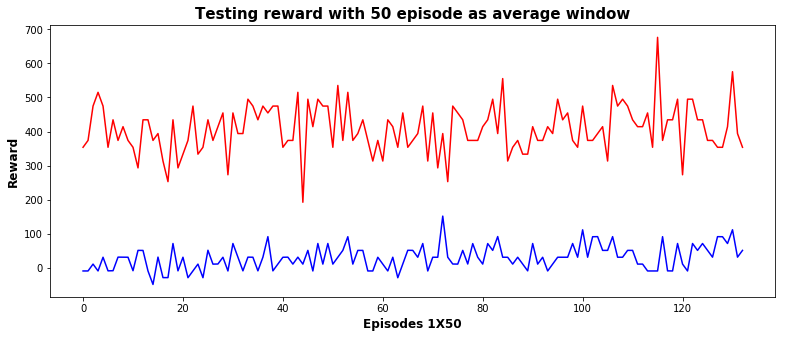

<Figure size 936x360 with 0 Axes>

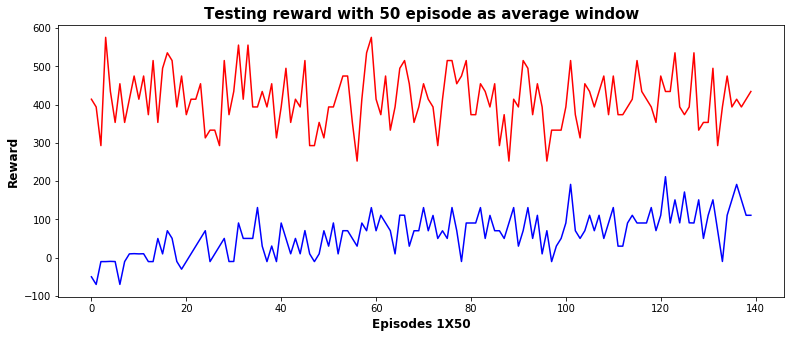

<Figure size 936x360 with 0 Axes>

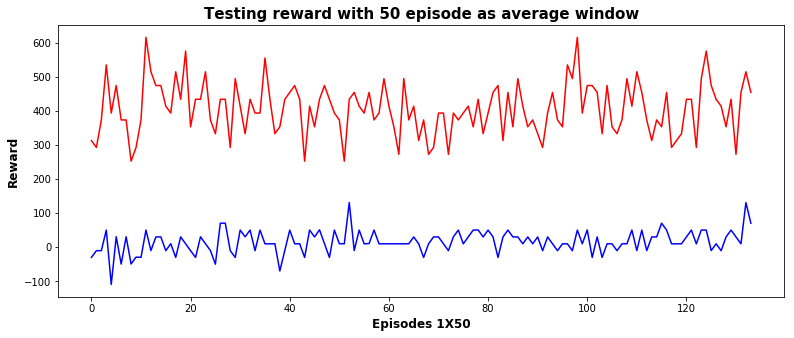

<Figure size 936x360 with 0 Axes>

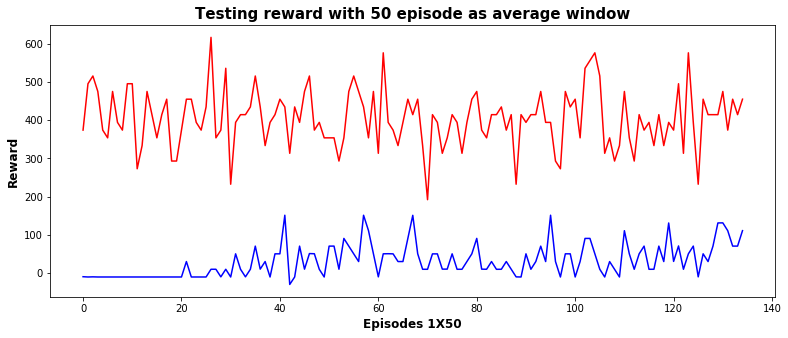

<Figure size 936x360 with 0 Axes>

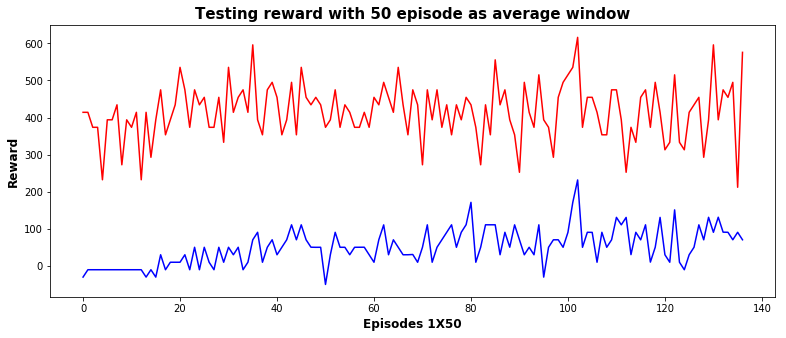

<Figure size 936x360 with 0 Axes>

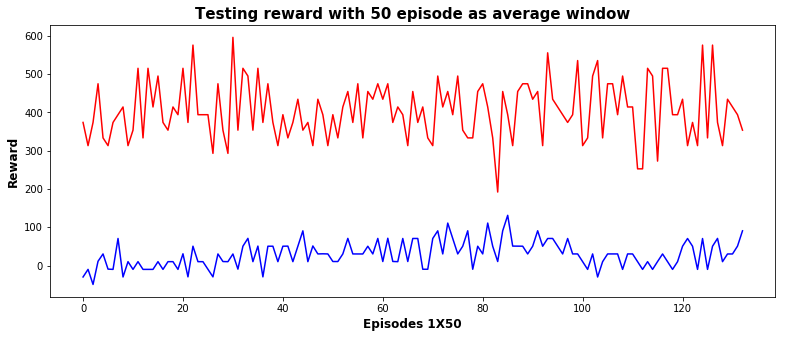

<Figure size 936x360 with 0 Axes>

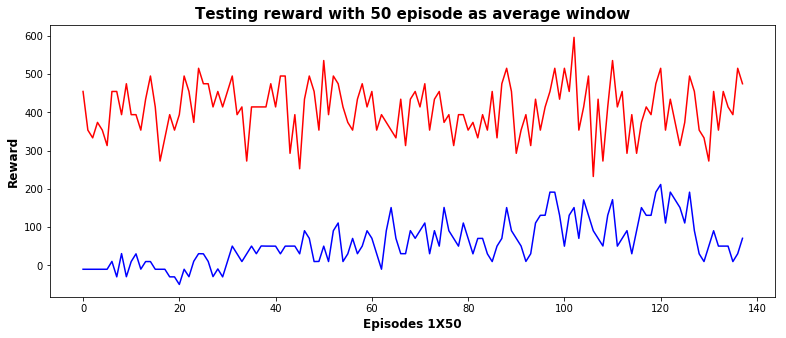

In [20]:
for i in range(1252,1259):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                    xlbl='Episodes 1X{}',ylbl='Reward',window=50,typ='Test')

<Figure size 936x360 with 0 Axes>

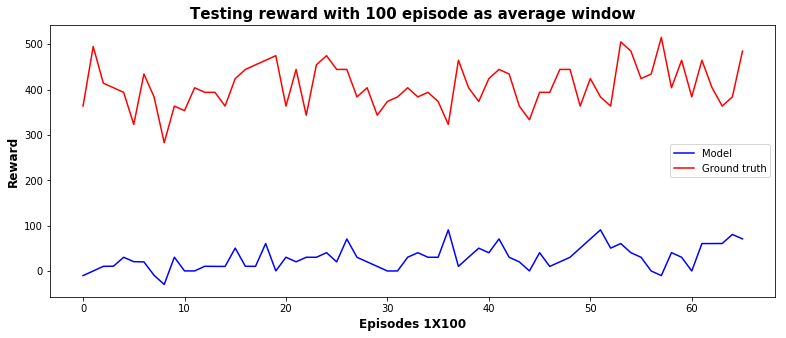

In [31]:
plot_experiment(1252,titl='Testing reward with {} episode as average window',
                    xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
plt.legend()
plt.savefig('ego_l2_rew.png')

### ego-centric L3 experiment with ego-centric orientation

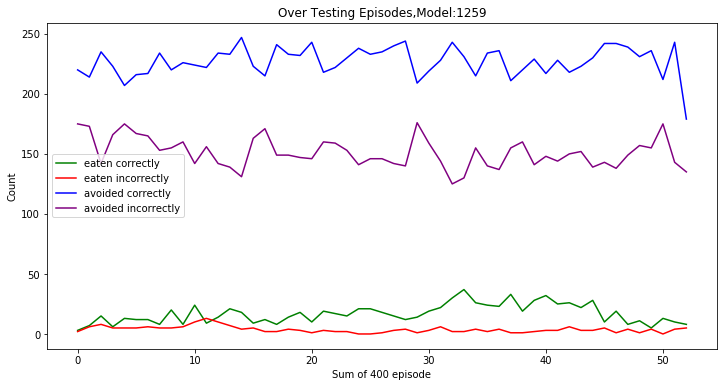

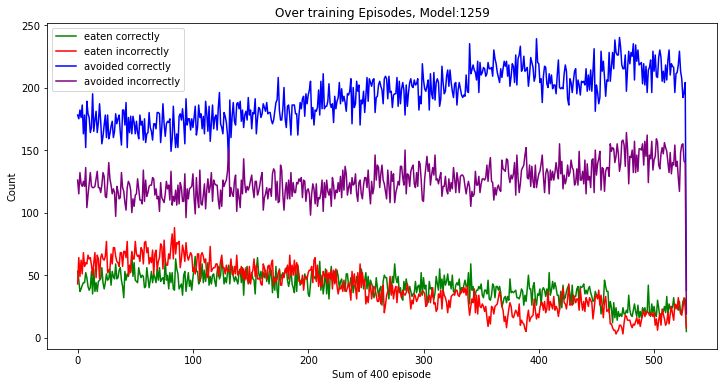

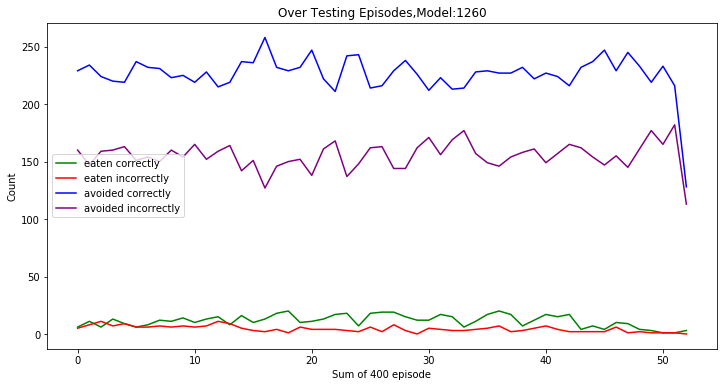

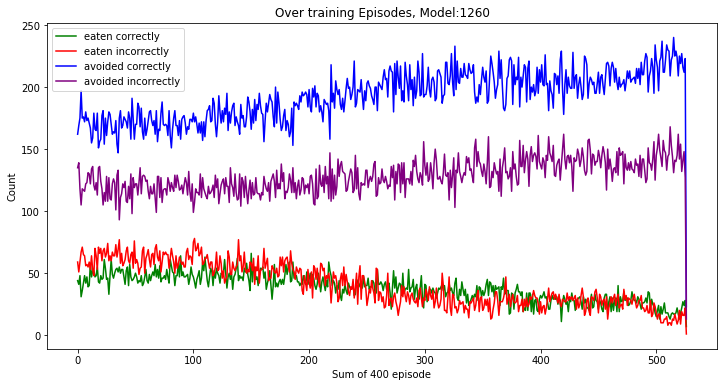

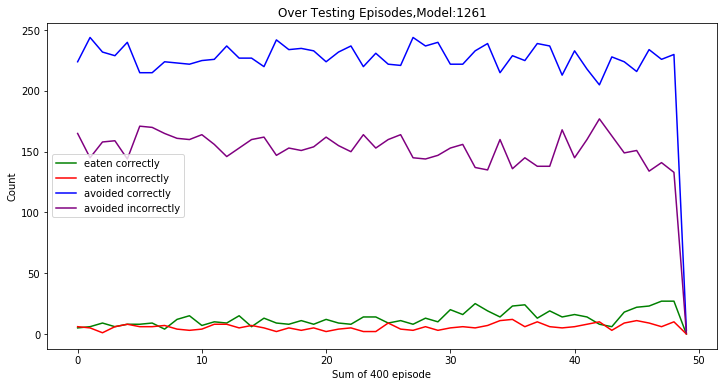

...

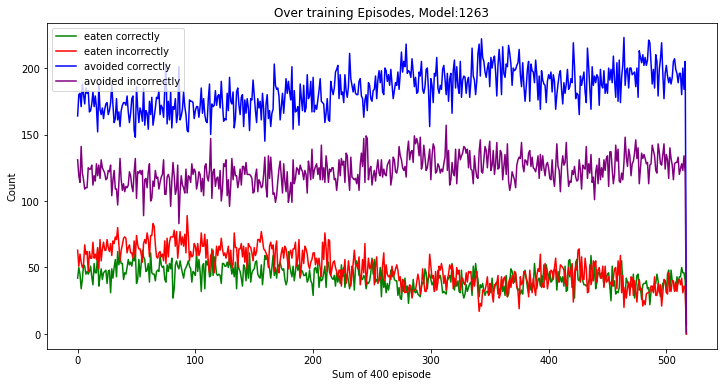

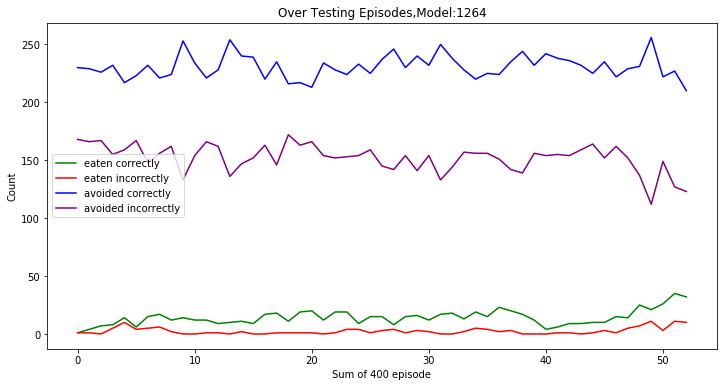

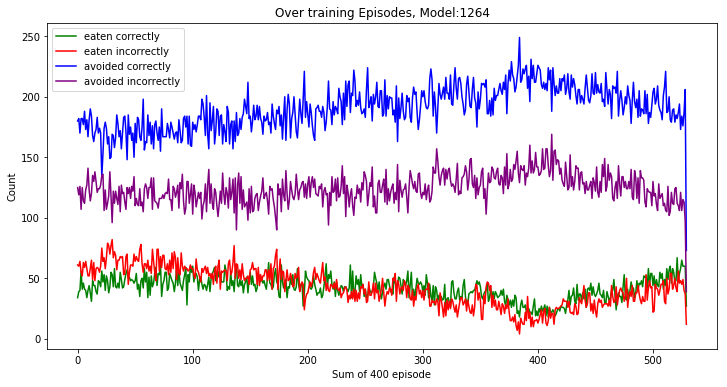

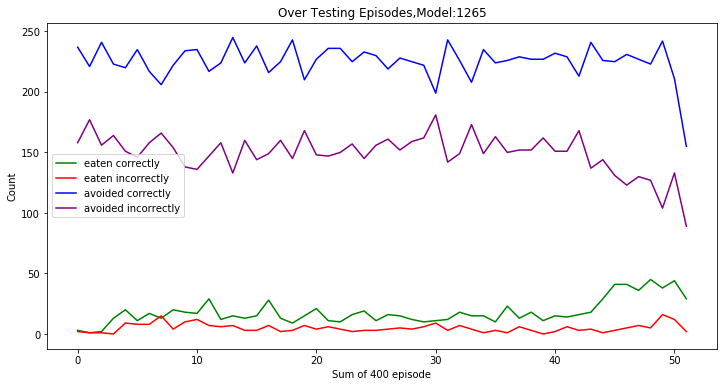

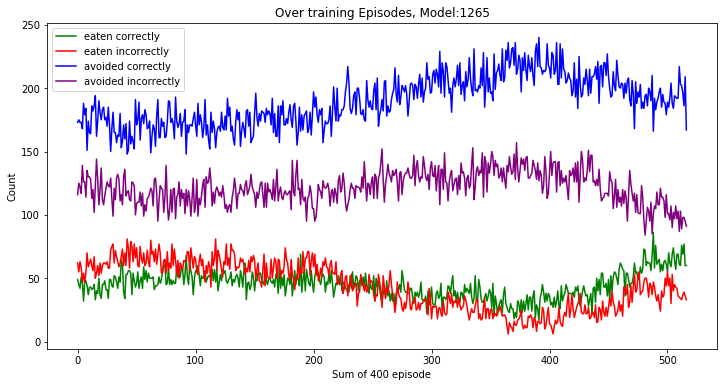

In [5]:
for i in range(1259,1266):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,400,i)

<Figure size 936x360 with 0 Axes>

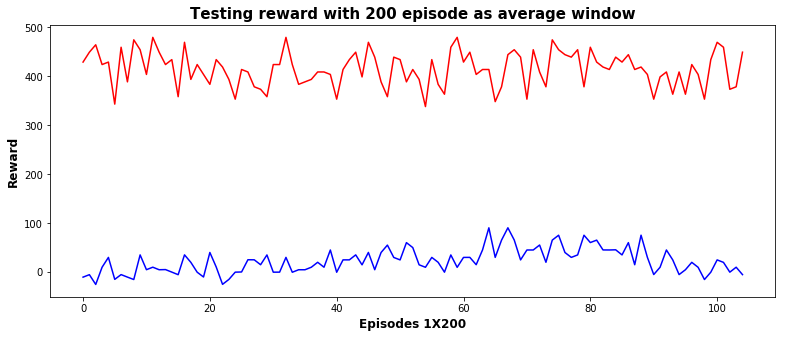

<Figure size 936x360 with 0 Axes>

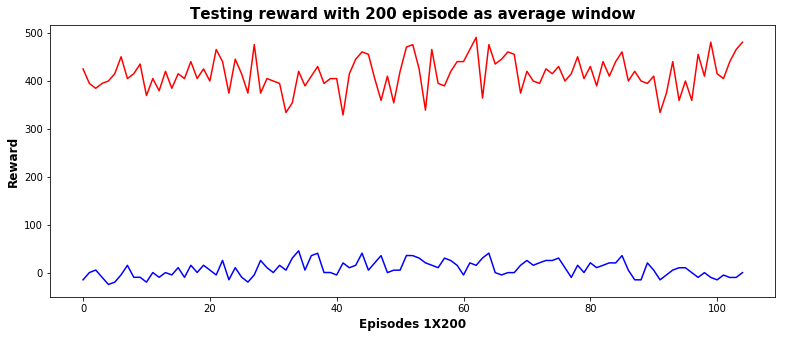

<Figure size 936x360 with 0 Axes>

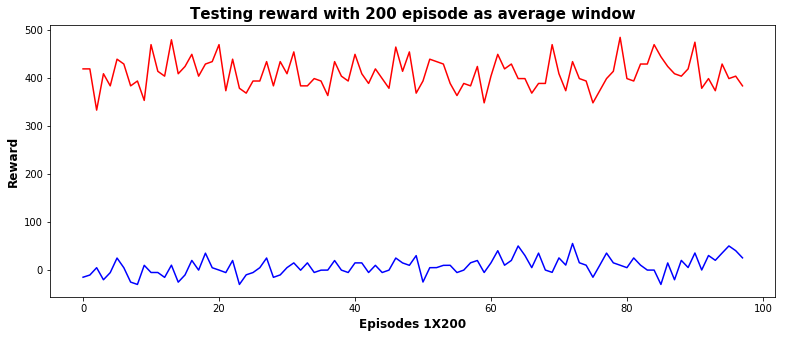

<Figure size 936x360 with 0 Axes>

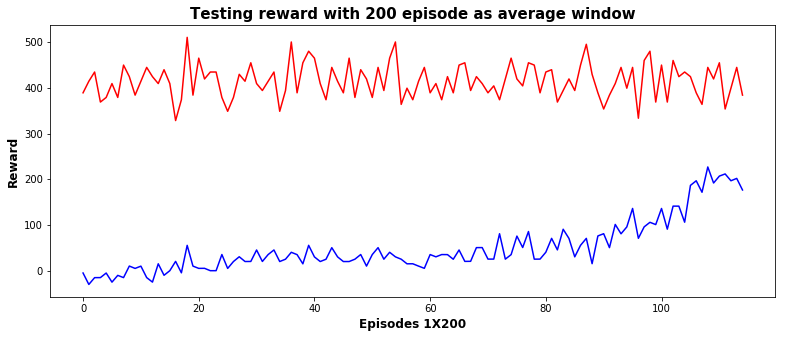

<Figure size 936x360 with 0 Axes>

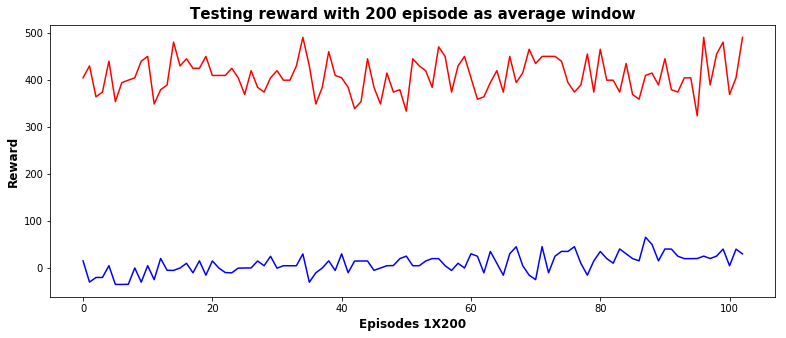

<Figure size 936x360 with 0 Axes>

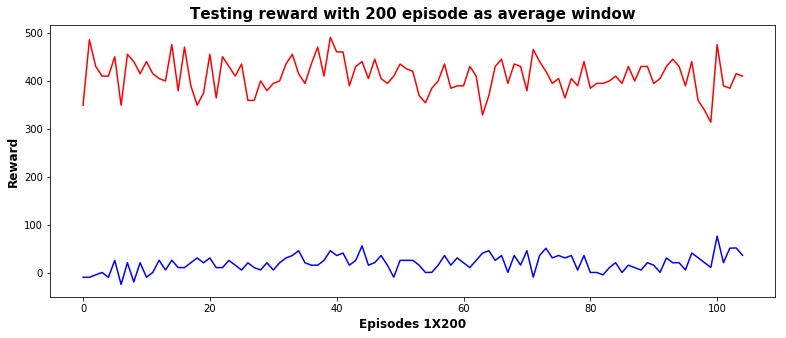

<Figure size 936x360 with 0 Axes>

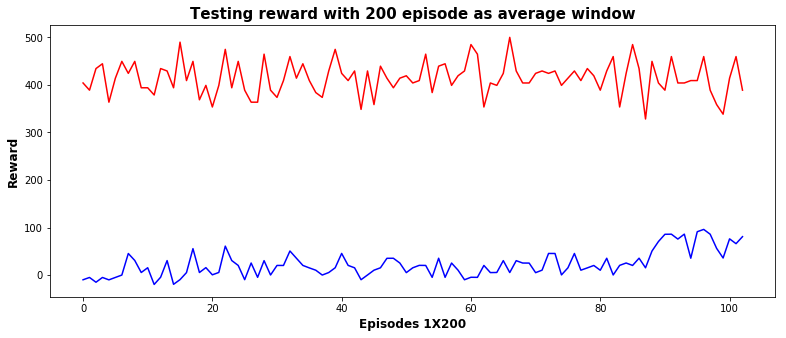

In [6]:
for i in range(1259,1266):
    plot_experiment(i,titl='Testing reward with {} episode as average window',
                    xlbl='Episodes 1X{}',ylbl='Reward',window=200,typ='Test')

<Figure size 936x360 with 0 Axes>

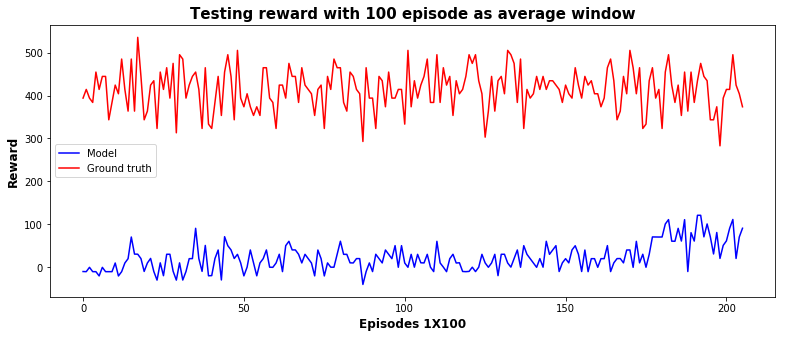

In [7]:
plot_experiment(1265,titl='Testing reward with {} episode as average window',
                    xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
plt.legend()
plt.savefig('ego_l3_rew.png')

### L3 experiment with orientation fed to cnn

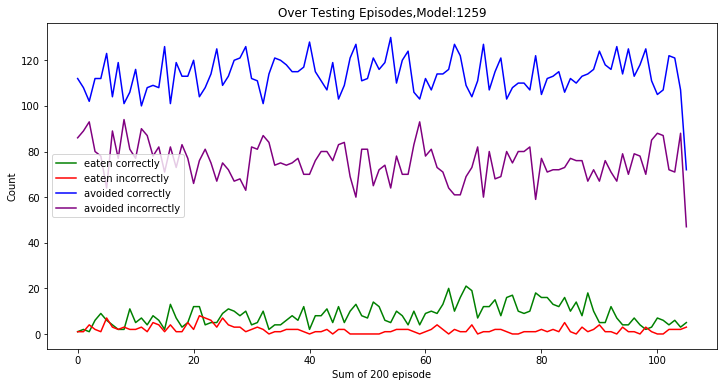

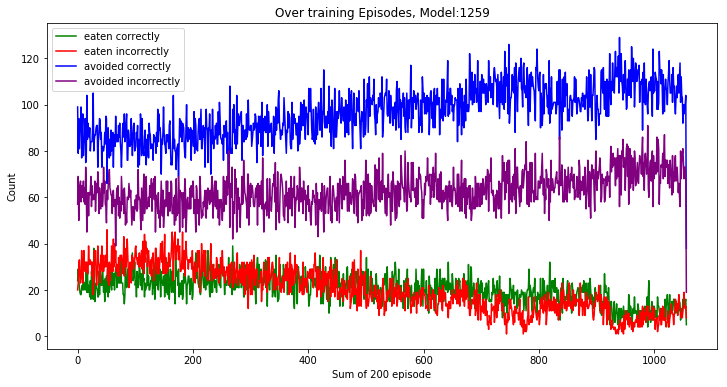

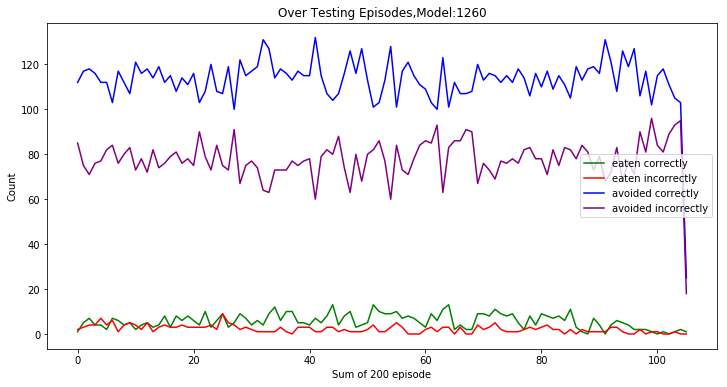

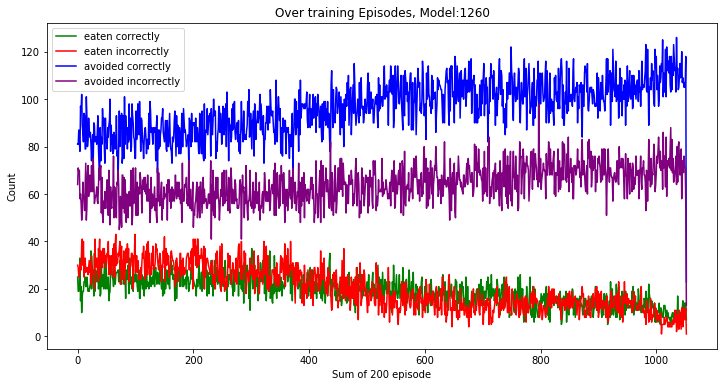

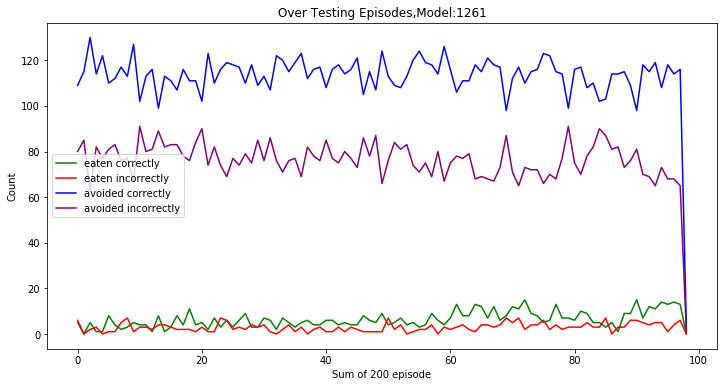

...

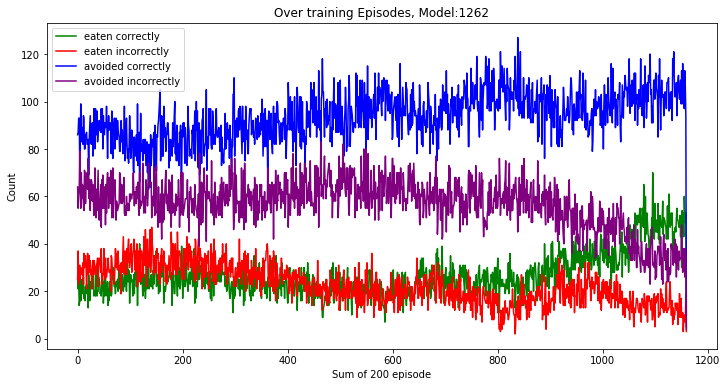

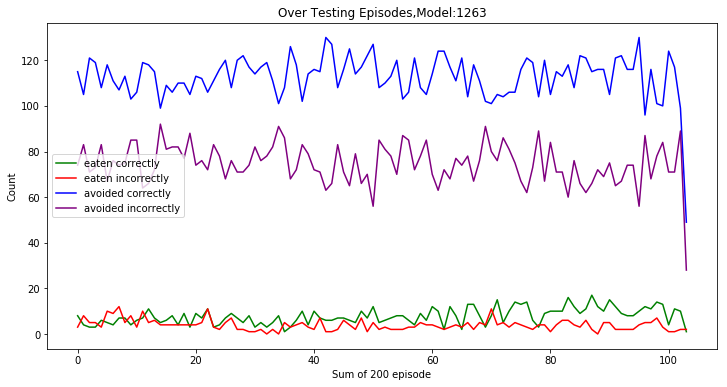

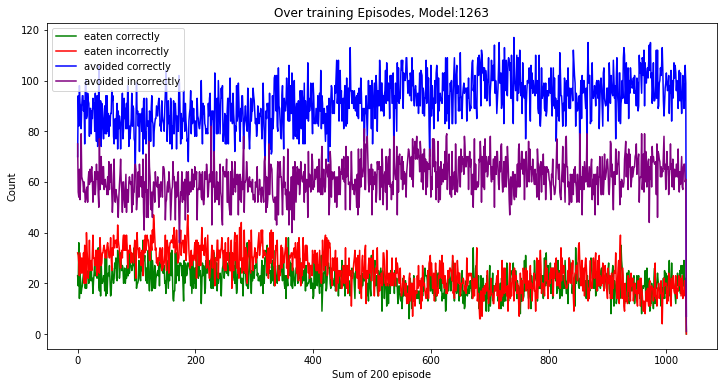

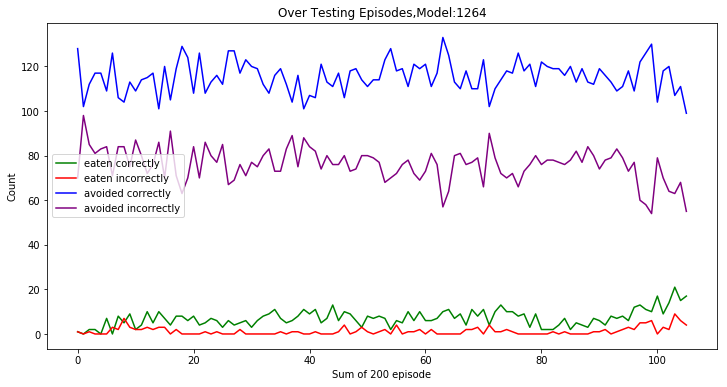

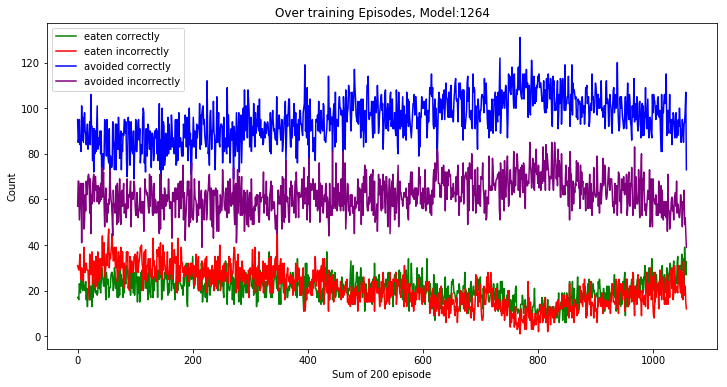

In [4]:
for i in range(1217,1224):
    x = pd.read_csv('output/{}/exp_details.csv'.format(i),header=None)
    plotdata(x,200,i)

In [27]:
def plot_experiment(ax,i,titl,xlbl,ylbl,window=400,typ='train'):
    #plt.figure(figsize=(13,5))
    tmp,perf = training_reward_window(window,i,typ)
    #plt.figure(figsize=(13,5))
    ax.plot(tmp[:-1],c='b',label='Model')
    ax.plot(perf[:-1],c='r',label='Ground truth')
    ax.set_title(titl.format(window),fontweight='bold',fontsize=15)
    ax.set_xlabel(xlbl.format(window),fontweight='bold',fontsize=12)
    ax.set_ylabel(ylbl,fontweight='bold',fontsize=12)

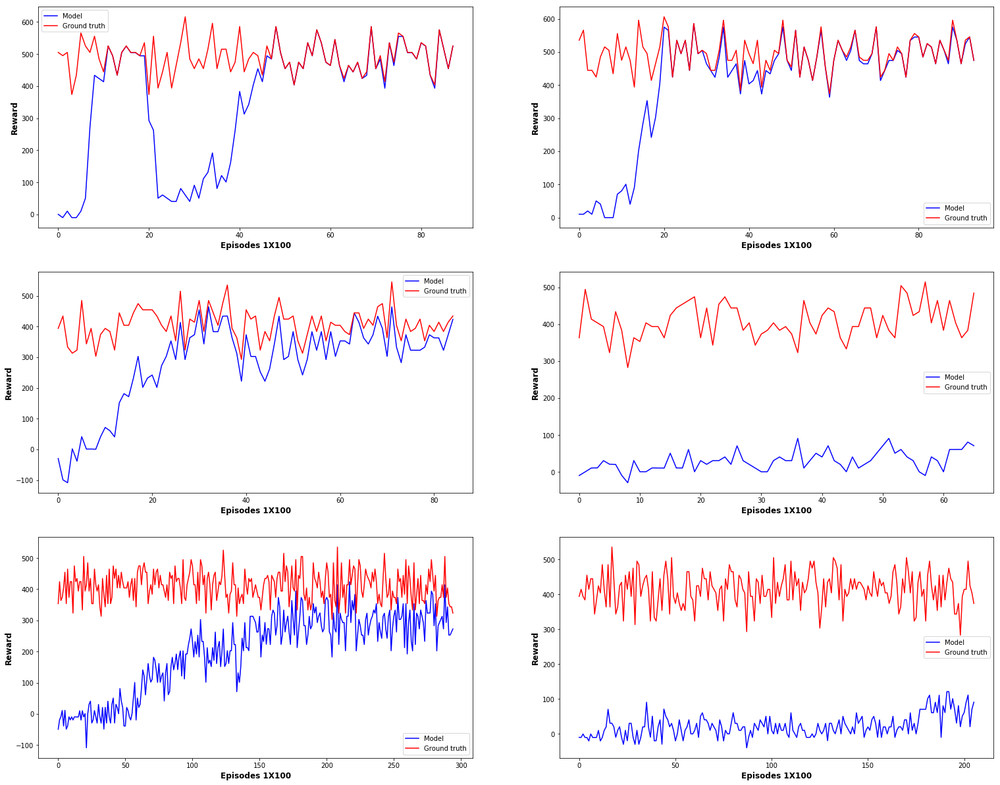

In [41]:
t=0
plt.figure(figsize=(26,21))
for i in [1230,1246,1166,1252,1181,1265]:
    t+=1
    ax = plt.subplot(3,2,t)
    plot_experiment(ax,i,titl='',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test')
    plt.legend()
#plt.tight_layout()
plt.savefig('reward.png',dpi=300)

In [3]:
def plot_experiment(i,titl,xlbl,ylbl,window=400,typ='train',fs =(13,5)):
    tmp,perf = training_reward_window(window,i,typ)
    plt.figure(figsize=fs)
    ax = plt.subplot(1,1,1)
    lw=2
    ax.plot(tmp[:-1],c='b',label='Model',linewidth=lw)
    ax.plot(perf[:-1],c='r',label='Ground truth',linewidth=lw)
    ax.set_title(titl.format(window),fontweight='bold',fontsize=20,**csfont)
    ax.set_xlabel(xlbl.format(window),fontweight='bold',fontsize=20,**hfont)
    ax.set_ylabel(ylbl,fontweight='bold',fontsize=20,**hfont)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(15)
        tick.label.set_fontweight('bold')
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(15)
        tick.label.set_fontweight('bold')
    return ax

In [8]:
def plot_experiment(i,titl,xlbl,ylbl,window=400,typ='train',fs =(13,5)):
    tmp,perf = training_reward_window(window,i,typ)
    plt.figure(figsize=fs)
    ax = plt.subplot(1,1,1)
    lw=2
    ax.plot(tmp[:-1],c='b',label='Model',linewidth=lw)
    ax.plot(perf[:-1],c='r',label='Ground truth',linewidth=lw)
    ax.set_title(titl.format(window),fontsize=20,**csfont)
    ax.set_xlabel(xlbl.format(window),fontsize=20,**hfont)
    ax.set_ylabel(ylbl,fontsize=20,**hfont)
    

    for label in ax.get_xticklabels():
        label.set_fontproperties(ticks_font)
    for label in ax.get_yticklabels():
        label.set_fontproperties(ticks_font)
    return ax

def plot_experiment_7seeds(i,titl,xlbl,ylbl,window=400,typ='train',fs =(13,5)):
    global important_exp
    results = []
    min_length = np.inf
    for jj in np.arange(important_exp[i][0],important_exp[i][1]+1):
        tmp,perf = training_reward_window(window,jj,typ)
        if tmp.shape[0]<min_length:
            min_length = tmp.shape[0]
        results.append([tmp,perf])
    fresults = np.zeros((7,2,min_length))
    for i in range(len(results)):
        fresults[i,0]=results[i][0][:min_length]
        fresults[i,1]=results[i][1][:min_length]
    mn = fresults.mean(axis=(0))
    std = fresults.std(axis=(0))/np.sqrt(7)

    plt.figure(figsize=(13,5))
    ax = plt.subplot(1,1,1)
    xvalues = np.arange(0,mn.shape[1])
    
    ax.plot(xvalues,mn[0],color='b',label='Model')
    ax.fill_between(xvalues,mn[0]+std[0],mn[0]-std[0],alpha=0.2)

    ax.plot(xvalues,mn[1],color='r',label='Ground Truth')
    ax.fill_between(xvalues,mn[1]+std[1],mn[1]-std[1],alpha=0.2)
    
    ax.set_title(titl.format(window),fontsize=20,**csfont)
    ax.set_xlabel(xlbl.format(window),fontsize=20,**hfont)
    ax.set_ylabel(ylbl,fontsize=20,**hfont)
    for label in ax.get_xticklabels():
        label.set_fontproperties(ticks_font)
    for label in ax.get_yticklabels():
        label.set_fontproperties(ticks_font)
    return ax


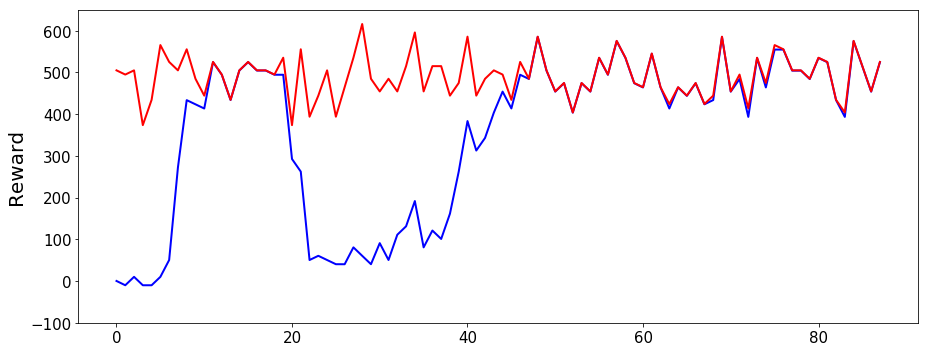

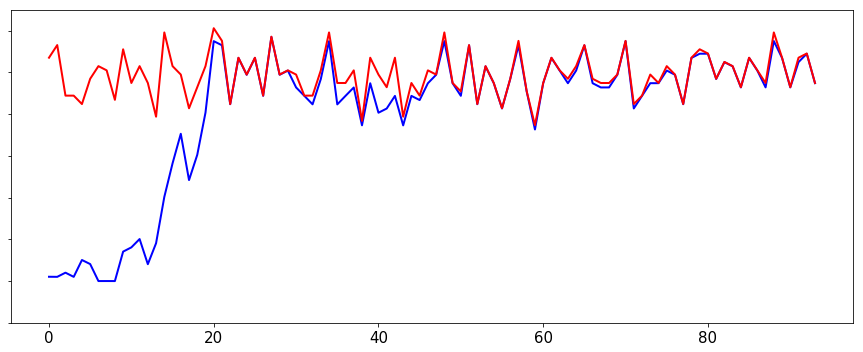

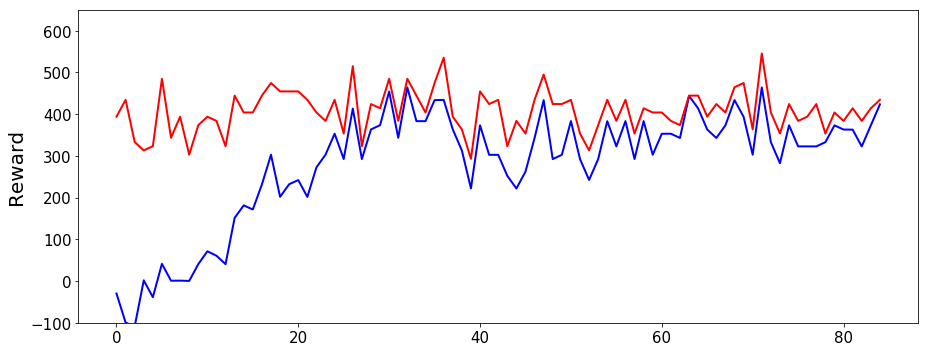

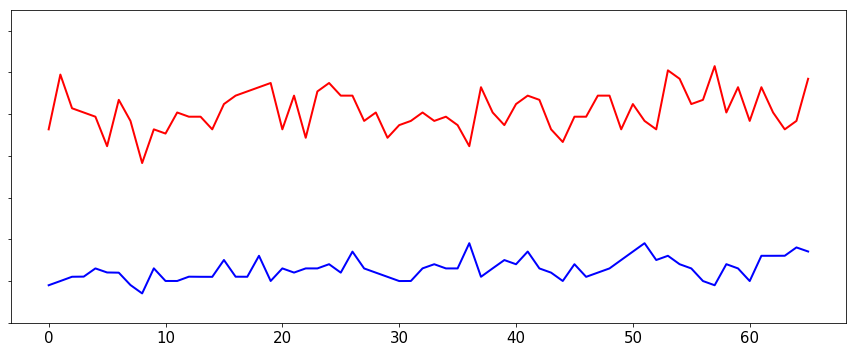

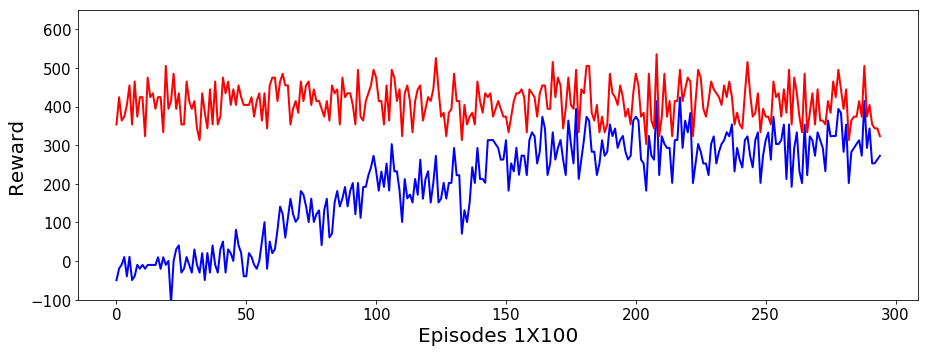

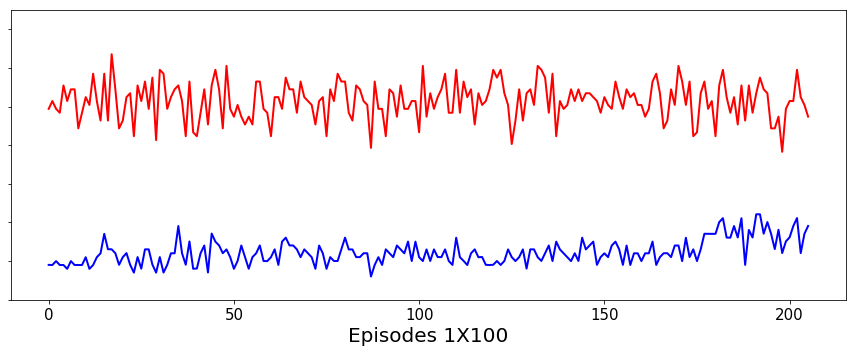

In [9]:
#t=0
#plt.figure(figsize=(26,21))
y_info ={1230:True,1246:False,1166:True,1252:False,1181:True,1265:False}
x_info ={1230:False,1246:False,1166:False,1252:False,1181:True,1265:True}
y_size ={1230:(13,5),1246:(12.1,5),1166:(13,5),1252:(12,5),1181:(13,5),1265:(12,5)}
texts={1230:'a)',1246:'b)',1166:'c)',1252:'d)',1181:'e)',1265:'f)'}
for i in [1230,1246,1166,1252,1181,1265]:
 #   t+=1
 #   ax = plt.subplot(3,2,t)
    ax = plot_experiment(i,titl='',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test',fs=y_size[i])
    ax.set_ylim(-100,650)
    if not y_info[i]:
        ax.set_ylabel('')
        ax.set_yticklabels([])
        
    if not x_info[i]:
        ax.set_xlabel('')
        #ax.set_xticklabels([])
    #ax.text(-4,616,texts[i],fontweight='bold',fontsize=15)
    #plt.legend(loc=0, prop={'size': 12,'weight':'bold'})
    #plt.text
    plt.tight_layout()

    plt.savefig('{}.png'.format(i),dpi=300)

In [ ]:
def plot_experiment(i,titl,xlbl,ylbl,window=400,typ='train',fs =(13,5)):
    tmp,perf = training_reward_window(window,i,typ)
    plt.figure(figsize=fs)
    ax = plt.subplot(1,1,1)
    lw=2
    ax.plot(tmp[:-1],c='b',label='Model',linewidth=lw)
    ax.plot(perf[:-1],c='r',label='Ground truth',linewidth=lw)
    ax.set_title(titl.format(window),fontweight='bold',fontsize=20,**csfont)
    ax.set_xlabel(xlbl.format(window),fontweight='bold',fontsize=20,**hfont)
    ax.set_ylabel(ylbl,fontweight='bold',fontsize=20,**hfont)
    for tick in ax.xaxis.get_major_ticks():
        tick.label.set_fontsize(15)
        tick.label.set_fontweight('bold')
    for tick in ax.yaxis.get_major_ticks():
        tick.label.set_fontsize(15)
        tick.label.set_fontweight('bold')
    return ax

## Plot simulations results

In [4]:
info = np.load('val_train_acc_loss_E.npz')
ego_info = info['ego']
info = info['allo']

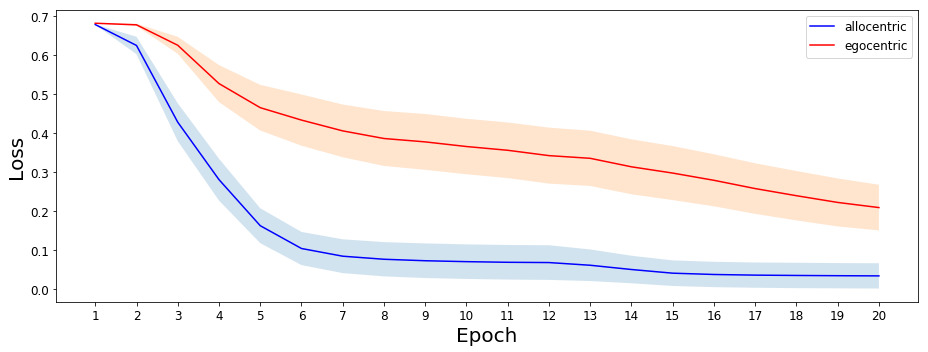

In [62]:
avlm,avls = calculate(info,0)
evlm,evls = calculate(ego_info,0)
plt.figure(figsize=(13,5))
ax = plt.subplot(1,1,1)
xvalues = np.arange(1,21)
ax.plot(xvalues,avlm,color='b',label='allocentric')
ax.fill_between(xvalues,avlm+avls,avlm-avls,alpha=0.2)

ax.plot(xvalues,evlm,color='r',label='egocentric')
ax.fill_between(xvalues,evlm+evls,evlm-evls,alpha=0.2)
#ax.set_title('Allocentric vs egocentric validation loss',fontsize=20,**csfont)
ax.set_xlabel('Epoch',fontsize=20,**hfont)
ax.set_ylabel('Loss',fontsize=20,**hfont)
#ax.set_xtick(np.arange(20),minor=True)
for label in ax.get_xticklabels():
    label.set_fontproperties(ticks_font)
for label in ax.get_yticklabels():
    label.set_fontproperties(ticks_font)
plt.xticks(np.arange(1,21,dtype=np.int),np.arange(1,21,dtype=np.int),minor=True)
#plt.ylabel('loss')
#plt.xlabel('Epoch')
ax.legend(prop=legend_font)
plt.tight_layout()
plt.savefig('allo_vs_ego_loss.png',dpi=300)

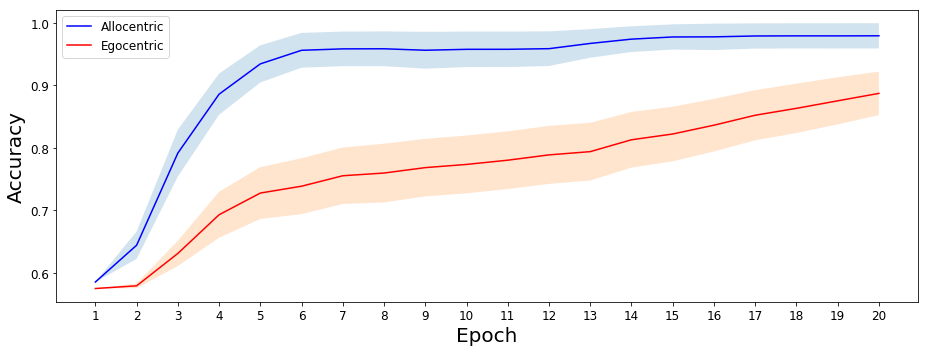

In [63]:
avlm,avls = calculate(info,1)
evlm,evls = calculate(ego_info,1)
plt.figure(figsize=(13,5))
ax = plt.subplot(1,1,1)
xvalues = np.arange(1,21)
ax.plot(xvalues,avlm,color='b',label='Allocentric')
ax.fill_between(xvalues,avlm+avls,avlm-avls,alpha=0.2)

ax.plot(xvalues,evlm,color='r',label='Egocentric')
ax.fill_between(xvalues,evlm+evls,evlm-evls,alpha=0.2)
#ax.set_title('Allocentric vs egocentric expected behavior accuracy ',fontsize=20,**csfont)
ax.set_xlabel('Epoch',fontsize=20,**hfont)
ax.set_ylabel('Accuracy',fontsize=20,**hfont)
for label in ax.get_xticklabels():
    label.set_fontproperties(ticks_font)
for label in ax.get_yticklabels():
    label.set_fontproperties(ticks_font)
plt.xticks(np.arange(1,21,dtype=np.int),np.arange(1,21,dtype=np.int),minor=True)
ax.legend(prop=legend_font)
plt.tight_layout()
plt.savefig('allo_vs_ego_acc.png',dpi=300)

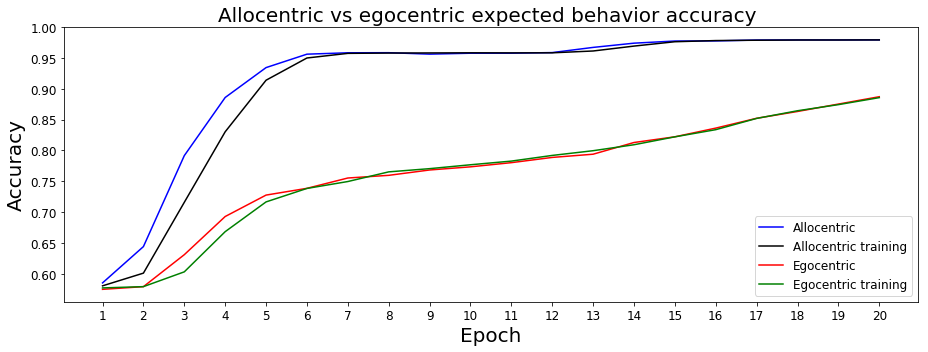

In [60]:
avlm,avls = calculate(info,1)
evlm,evls = calculate(ego_info,1)
atlm,atls = calculate(info,3)
etlm,etls = calculate(ego_info,3)
plt.figure(figsize=(13,5))
ax = plt.subplot(1,1,1)
xvalues = np.arange(1,21)
ax.plot(xvalues,avlm,color='b',label='Allocentric')
ax.plot(xvalues,atlm,color='black',label='Allocentric training')
#ax.fill_between(xvalues,avlm+avls,avlm-avls,alpha=0.2)

ax.plot(xvalues,evlm,color='r',label='Egocentric')
ax.plot(xvalues,etlm,color='green',label='Egocentric training')
#ax.fill_between(xvalues,evlm+evls,evlm-evls,alpha=0.2)
ax.set_title('Allocentric vs egocentric expected behavior accuracy ',fontsize=20,**csfont)
ax.set_xlabel('Epoch',fontsize=20,**hfont)
ax.set_ylabel('Accuracy',fontsize=20,**hfont)
for label in ax.get_xticklabels():
    label.set_fontproperties(ticks_font)
for label in ax.get_yticklabels():
    label.set_fontproperties(ticks_font)
plt.xticks(np.arange(1,21,dtype=np.int),np.arange(1,21,dtype=np.int),minor=True)
ax.legend(prop=legend_font)
plt.tight_layout()
plt.savefig('allo_vs_ego_acc.png',dpi=300)

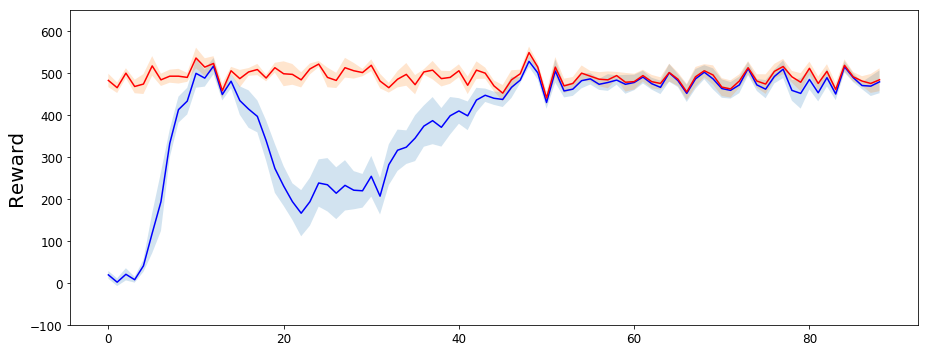

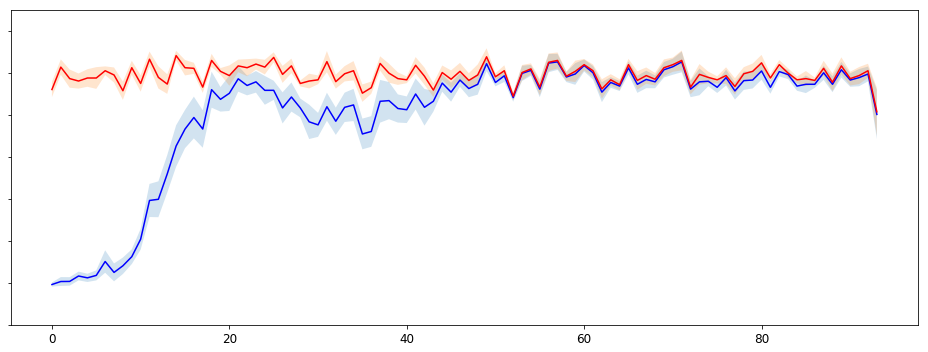

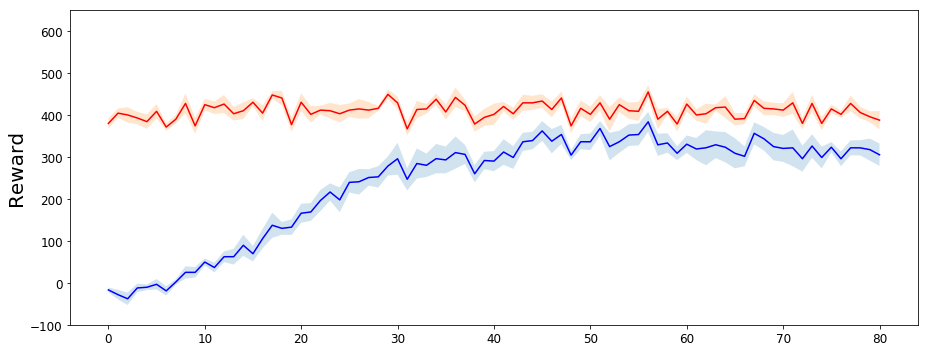

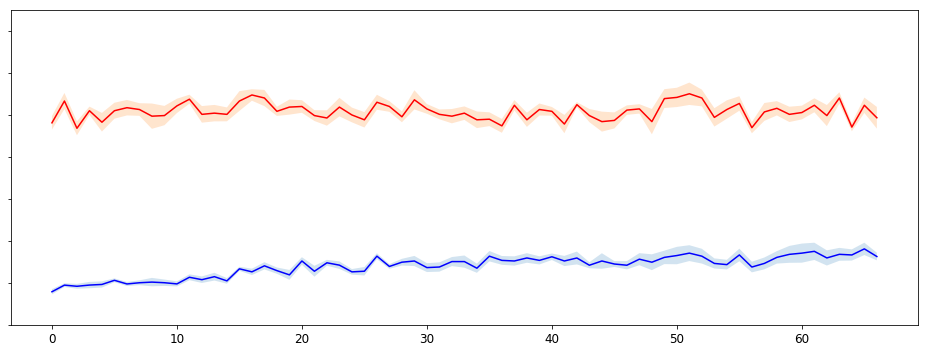

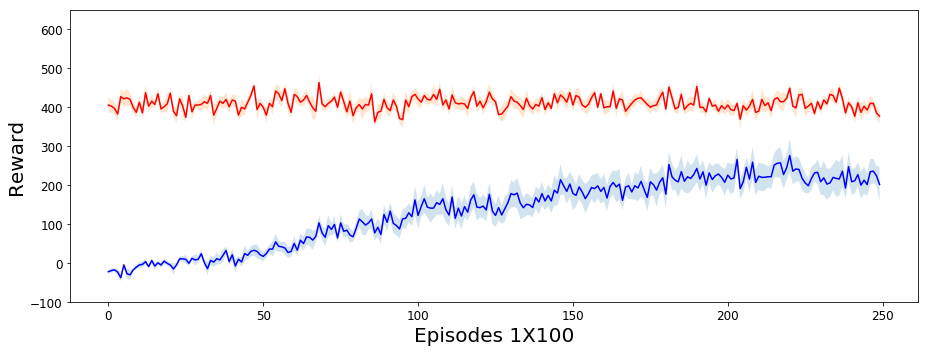

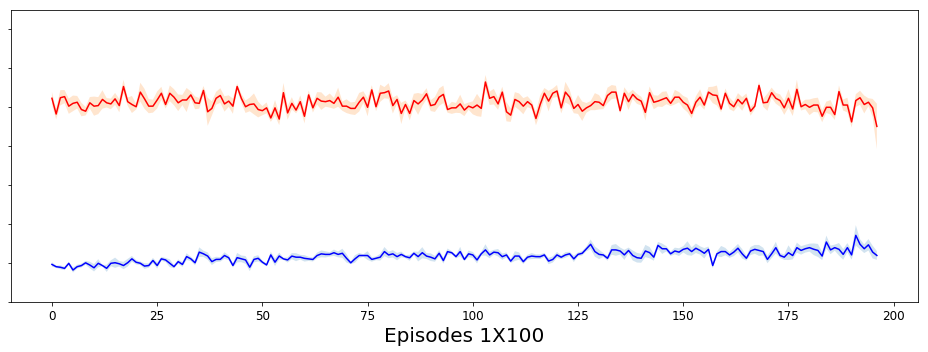

In [9]:
#t=0
#plt.figure(figsize=(26,21))
y_info ={1230:True,1246:False,1166:True,1252:False,1181:True,1265:False}
x_info ={1230:False,1246:False,1166:False,1252:False,1181:True,1265:True}
y_size ={1230:(13,5),1246:(12.1,5),1166:(13,5),1252:(12,5),1181:(13,5),1265:(12,5)}
texts={1230:'a)',1246:'b)',1166:'c)',1252:'d)',1181:'e)',1265:'f)'}
for i in [1230,1246,1166,1252,1181,1265]:
 #   t+=1
 #   ax = plt.subplot(3,2,t)
    ax = plot_experiment_7seeds(i,titl='',
                xlbl='Episodes 1X{}',ylbl='Reward',window=100,typ='Test',fs=y_size[i])
    ax.set_ylim(-100,650)
    if not y_info[i]:
        ax.set_ylabel('')
        ax.set_yticklabels([])
        
    if not x_info[i]:
        ax.set_xlabel('')

    plt.tight_layout()

    plt.savefig('{}_std.png'.format(i),dpi=300)